In [14]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.decomposition import PCA
from mpl_toolkits.mplot3d import Axes3D
from sklearn import cluster, datasets
from pandas import DataFrame as df
from IPython.display import clear_output

import datetime


from sklearn.metrics import mean_squared_error
from sklearn.model_selection import learning_curve

import keras
from keras.models import load_model
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation
from keras.layers.core import  Activation, Dropout  
from keras.optimizers import RMSprop
from keras.layers import Embedding, RepeatVector
from keras.layers import LSTM
from keras.layers.recurrent import GRU
from keras.optimizers import SGD
from sklearn.preprocessing import MinMaxScaler
from sklearn.cross_validation import train_test_split

import DailyMLPModel as D
import DailyNNModel as DNN
import DailyNeuralNetworkModel1 as DNNm
from DailyNeuralNetworkModel1 import getWinterForecastingResults

%matplotlib inline
#%matplotlib qt
%config InlineBackend.figure_format = 'retina'

In [5]:
def import_data():
    dataset = pd.read_csv('../data/DP.csv',usecols=[27],engine='python')
    return dataset
def mean_absolute_percentage_error(y_true, y_pred): 

    ## Note: does not handle mix 1d representation
    #if _is_1d(y_true): 
    #    y_true, y_pred = _check_1d_array(y_true, y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100


def mean_absolute_error(y_true, y_pred): 

    ## Note: does not handle mix 1d representation
    #if _is_1d(y_true): 
    #    y_true, y_pred = _check_1d_array(y_true, y_pred)
    return np.mean(np.abs((y_true - y_pred) )) 

def rmse(predictions, targets):
    return np.sqrt(((predictions - targets) ** 2).mean())


def prepareInputs(daydata, season, UsedInputs,testPeriod):
    nbrInputs= 0
    
    previousHours = UsedInputs[0]
    timeSteps = int(UsedInputs[1])
    previousDay = UsedInputs[2]
    previousWeek = UsedInputs[3]
    temp = UsedInputs[4]
    tempMax = UsedInputs[5]
    tempMin = UsedInputs[6]
    dayIndicator = UsedInputs[7]
    HourIndicator= UsedInputs[8]
    monthIndicator = UsedInputs[9]
    
    if previousHours == True: 
        nbrInputs = nbrInputs + int(timeSteps)
    if previousDay == True: nbrInputs= nbrInputs+1
    if previousWeek == True : nbrInputs= nbrInputs+ 1
    if temp == True: nbrInputs= nbrInputs+1
    if tempMax == True: nbrInputs= nbrInputs+1
    if tempMin == True: nbrInputs= nbrInputs+1
    if dayIndicator== True: nbrInputs= nbrInputs+7
    if HourIndicator== True : nbrInputs= nbrInputs+24
    if monthIndicator== True : nbrInputs= nbrInputs + 12
    
    
    hourclusters= np.empty([(daydata.index.size*24),1])

    hourdataindex= pd.DataFrame(index=pd.date_range('2014-1-8 00:00:00', periods=(365)*24, freq='H'))

    for x in range(0,daydata.index.size):
        for y in range(0,24):
            hourclusters[(x * 24) + y,0] = daydata.iloc[x,24]
    hourclusters.size

    tempAlgiers=  pd.read_csv('../data/tempAlgiers.csv')
    tempA= tempAlgiers.loc[:,'Hour_1':'Hour_24']
    tempnp= np.array(tempA)
    tempnp= tempnp.reshape(-1,1)
    tempdata= pd.DataFrame(tempnp)

    tempmax= tempAlgiers.loc[:,'Tmax']
    tempmin= tempAlgiers.loc[:,'Tmin']




    tempmx= np.random.random([tempmax.size*24,1])
    tempmn= np.random.random([tempmin.size*24,1])



    for x in range(0,tempmax.size):
        for y in range(0,24):
            tempmx[(x * 24) + y,0] = tempmax.iloc[x]

    for x in range(0,tempmin.size):
        for y in range(0,24):
            tempmn[(x * 24) + y,0] = tempmin.iloc[x]
        

    samples = daydata.index.size*24
    daydata2= daydata.copy()
    del(daydata2['cluster'])

    data= pd.DataFrame(np.array(daydata2).reshape(-1,1))

    maxcons= data.values.max()
    mincons= data.values.min()

    maxtemp= np.max(tempdata.values)
    mintemp= tempdata.values.min()

    maxtempmax= np.max(tempmx)
    mintempmax= np.min(tempmx)

    maxtempmin= np.max(tempmn)
    mintempmin= np.min(tempmn)

    sigxx= np.empty((samples - 168 , nbrInputs))
    sigyy= np.empty((samples - 168 , 1))

    i= 0
    for x in list(range(168,samples)):
        i=0
        if previousHours == True: 
            for y in list(range(timeSteps)):
                sigxx[x - 168 , i] = (data.iloc[x - i - 1 , 0])/(2*maxcons)
                i= i + 1
        if previousDay == True: 
            sigxx[x - 168 , i] = (data.iloc[x - 24 , 0])/(2*maxcons)
            i= i+1
        if previousWeek == True : 
            sigxx[x - 168 , i] = (data.iloc[x - 168 , 0])/(2*maxcons)
            i= i+ 1
        if temp == True: 
            sigxx[x - 168 , i] = (tempdata.iloc[x])/(2*maxtemp)
            i= i+1
        if tempMax == True: 
            sigxx[x - 168 , i] = (tempmx[x]) / (2 * maxtempmax)
            i= i+1
        if tempMin == True: 
            sigxx[x - 168 , i] = (tempmn[x]) / (2 * maxtempmin)
            i= i+1
        if dayIndicator == True:
            ind=0
            for y in range(0,7):
                sigxx[x - 168 , i + ind] = 0
                ind = ind + 1
            sigxx[x - 168 , i + pd.datetime.weekday(hourdataindex.index[x])]=1
            i = i + 7
        if HourIndicator == True:
            ind=0
            for y in range(0,24):
                sigxx[x - 168 , i+ind]= 0
                ind = ind + 1
            sigxx[x - 168 , i + hourdataindex.index[x].hour]=1
            i = i + 24
        if monthIndicator == True:
            ind=0
            for y in range(0,12):
                sigxx[x - 168 , i + ind] = 0
                ind = ind + 1
            sigxx[x - 168 , i + hourdataindex.index[x].month - 1]=1
            i = i + 12 
    
    for x in list(range(168,samples)):
        sigyy[x - 168 , 0]= (data.iloc[x , 0])/(2*maxcons)

    sigmoidxx= df(sigxx.copy())
    sigmoidyy= df(sigyy.copy())

    sigmoidxx.index= pd.date_range('2014-1-8 00:00:00', periods=(365-7)*24, freq='H')
    sigmoidyy.index= pd.date_range('2014-1-8 00:00:00', periods=(365-7)*24, freq='H')

    sigmoidxx['cluster'] = hourclusters[168:]
    sigmoidyy['cluster'] = hourclusters[168:]
    dfhourclusters = df(hourclusters)
    
    SigmoidInputs =sigmoidxx[sigmoidxx.cluster==season].copy()
    
    SigmoidOutputs= sigmoidyy[sigmoidyy.cluster==SigmoidInputs.loc[SigmoidInputs.index[0],'cluster']]
    del(SigmoidInputs['cluster'],SigmoidOutputs['cluster'])
    learningoutputs = pd.DataFrame(SigmoidOutputs.iloc[:int(SigmoidOutputs.size-testPeriod)].values.copy(),
                            index=SigmoidOutputs.iloc[:int(SigmoidOutputs.size-testPeriod)].index)
    testoutputs = pd.DataFrame(SigmoidOutputs.iloc[int(SigmoidOutputs.size-testPeriod):].values.copy(),
                            index=SigmoidOutputs.iloc[int(SigmoidOutputs.size-testPeriod):].index)

    learninginputs = pd.DataFrame(SigmoidInputs.iloc[:int(SigmoidOutputs.size-testPeriod)].values.copy(),
                            index=SigmoidOutputs.iloc[:int(SigmoidOutputs.size-testPeriod)].index)
    testinputs = pd.DataFrame(SigmoidInputs.iloc[int(SigmoidOutputs.size-testPeriod):].values.copy(),
                            index=SigmoidOutputs.iloc[int(SigmoidOutputs.size-testPeriod):].index)

    print('-------Input preparation process complet-------')
    return learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs



In [9]:
data = import_data()
data= np.array(data)
data= data.reshape(-1,24)

daydata= df(data)
daydata.index= pd.date_range('2014-1-1', periods=365, freq='D')

clusters= np.loadtxt('../data/Mixed_4_Clusters',delimiter=',')

pca= PCA(n_components=3)
pca.fit(daydata)
data_pca =  pca.transform(daydata)

# pdClusters= pd.DataFrame(clusters,index=daydata.index)
print(clusters)



# fig = plt.figure(1, figsize=(12, 9))

# ax = Axes3D(fig, rect=[0, 0, .95, 1], elev=45, azim=135)

# dayofweek = pd.DatetimeIndex(daydata.index).dayofweek

# ax.scatter(data_pca[:,0],data_pca[:,1],data_pca[:,2],cmap=plt.cm.spectral,c=clusters,alpha= 0.4)

# plt.show()


daydata['cluster']=clusters

[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 4. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 4. 0. 0. 0. 0. 0. 0. 0.
 4. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 4. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 4. 4. 4. 1.
 1. 4. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.
 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.
 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.
 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3.
 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 3. 4. 2. 2. 2. 2. 2. 2. 2.
 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.
 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.
 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2.
 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 2. 4. 4. 2. 1. 1. 4. 1.
 1. 4. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

In [10]:
testPeriod= 240

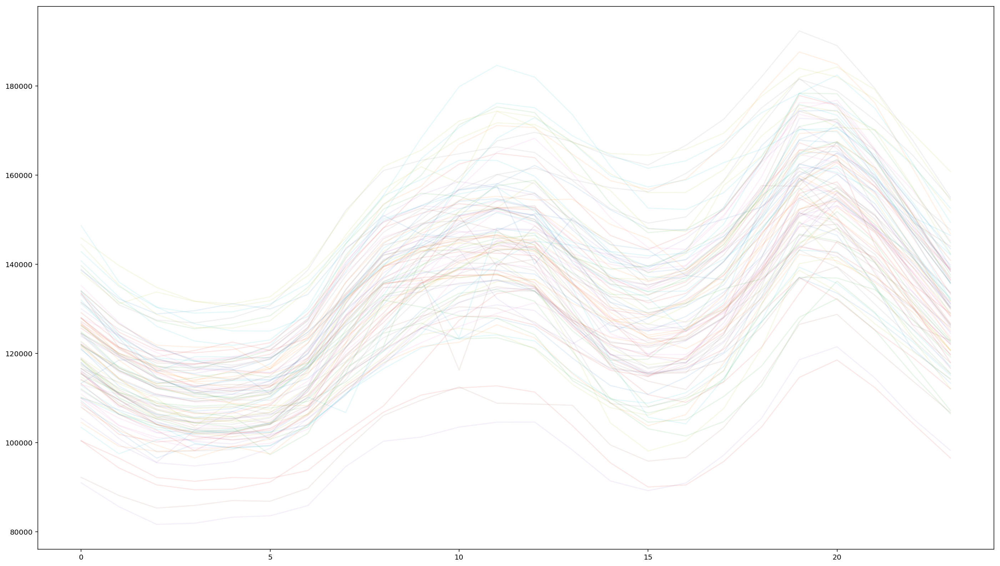

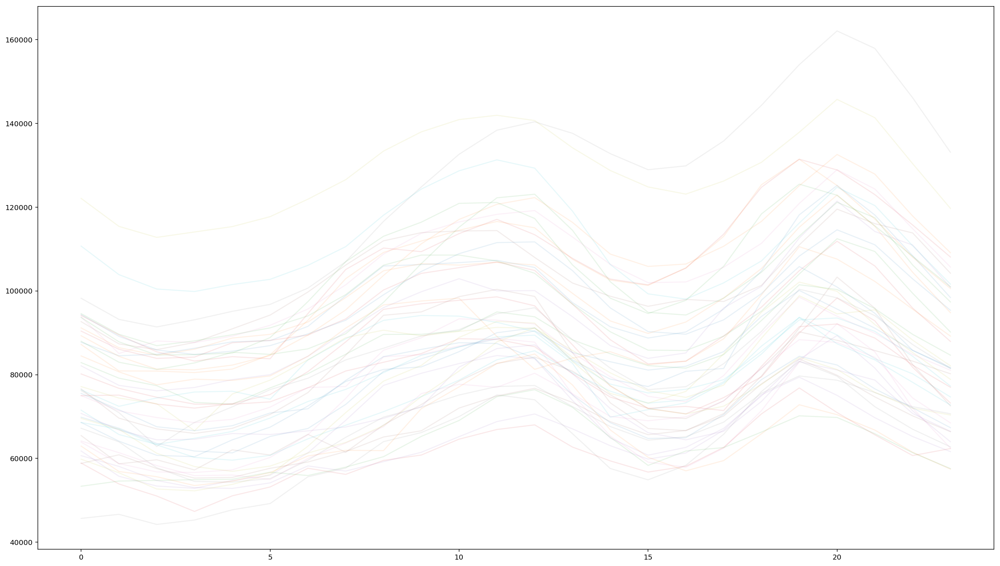

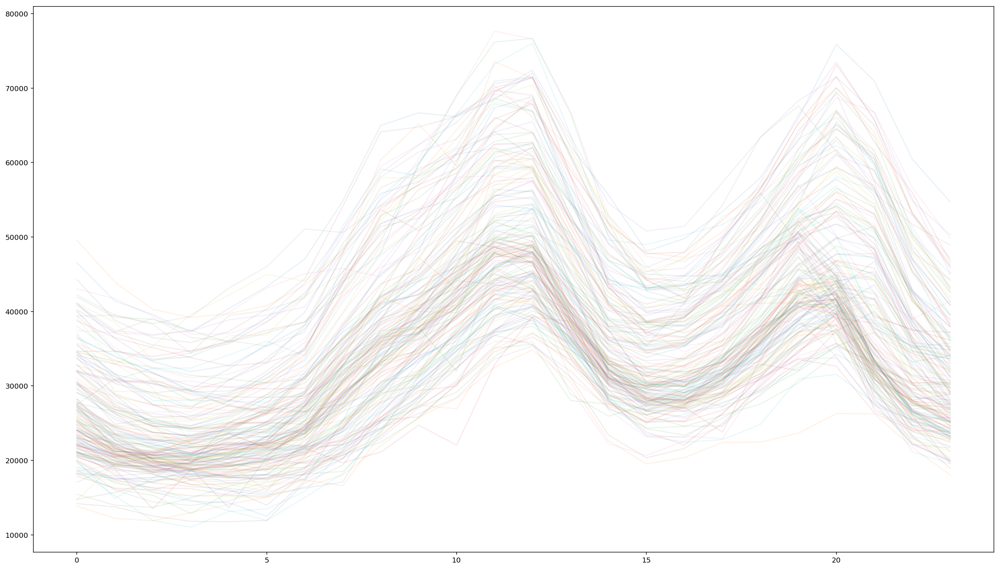

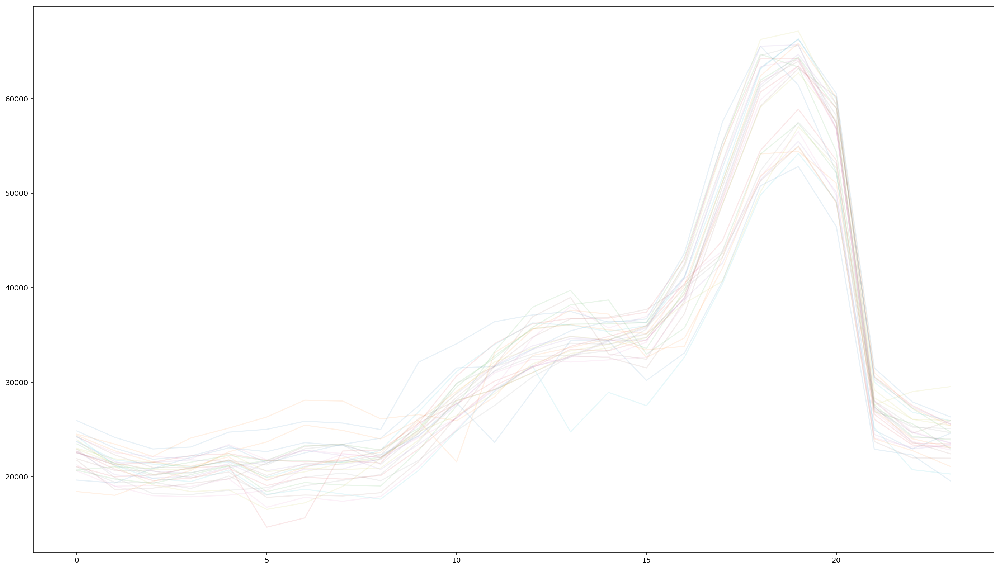

In [11]:

temp=daydata.copy()
del(temp['cluster'])

plt.figsize=(24,14)
temp[daydata.cluster==0].transpose().plot( alpha=0.1,figsize=(24,14),legend=None)

temp[daydata.cluster==1].transpose().plot( alpha=0.1,figsize=(24,14),legend=None)

temp[daydata.cluster==2].transpose().plot( alpha=0.1,figsize=(24,14),legend=None)

temp[daydata.cluster==3].transpose().plot( alpha=0.1,figsize=(24,14),legend=None)


plt.show()

In [12]:
def create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,n_features,HiddenNeurons1=None,HiddenNeurons2=None
                              ,LearningRate=None,Epoch=None,Optimizer=None, timeSteps= None):
    
    if HiddenNeurons1 is None: HiddenNeurons1 = 10
    if HiddenNeurons2 is None: HiddenNeurons2 = 5
    if LearningRate is None: LearningRate = 0.001
    if Epoch is None: Epoch = 500
    if Optimizer is None: Opitimizer = 'Adam'
    if timeSteps is None: timeSteps = 1
        
    mlpmodel = Sequential()
    # Dense(64) is a fully-connected layer with 64 hidden units.
    # in the first layer, you must specify the expected input data shape:
    # here, 20-dimensional vectors.
    mlpmodel.add(LSTM(units= HiddenNeurons1, return_sequences=True, activation='sigmoid', input_shape=(timeSteps, n_features)))  # returns a sequence of vectors of dimension 32
    mlpmodel.add(LSTM(units= HiddenNeurons2, activation='sigmoid', return_sequences=False))  # returns a sequence of vectors of dimension 32
    mlpmodel.add(Dense(1, init='uniform',activation='sigmoid'))
    mlpmodel.compile(optimizer=Optimizer, loss='mse')
#     mlpmodel.add(Dense(HiddenNeurons1, input_dim=inputx1.shape[1],activation='sigmoid'))
#     mlpmodel.add(Dense(HiddenNeurons2, init='uniform'))
#     mlpmodel.add(Dense(1, init='uniform'))
#     mlpmodel.add(Activation('sigmoid'))

#     sgd = SGD(lr=LearningRate, decay=1e-6, momentum=0.9, nesterov=True)
#     mlpmodel.compile(loss='mse', optimizer=Optimizer)

    tempMLPmodels= np.empty((Epoch),dtype=object)
    tempErrorHistory= np.empty((Epoch),dtype=object)

#     ErrorHistory= mlpmodel.fit(x=inputx1.reshape(-1,1,n_features), y=outputx1, epochs=Epoch,batch_size=12
#                                    ,validation_data=(inputx2.reshape(-1,1,n_features),outputx2),verbose= 2)
    
    counter=0
    for i in range(0,Epoch):
        print('epoch:   %d .' %counter)
        ErrorHistory= mlpmodel.fit(x=inputx1.reshape(-1,1,n_features), y=outputx1, epochs=1,batch_size=12
                                   ,validation_data=(inputx2.reshape(-1,1,n_features),outputx2),verbose= 2)
        tempMLPmodels[i]= mlpmodel
        mlpmodel.save('temp/lstm_%d_%s'%(i,season))
        tempErrorHistory[i]=ErrorHistory.history['val_loss']
        counter = counter +1    
    print('==============================================================================')
    print('\t \t LSTM model is ready for forecasting')
    print('==============================================================================')
    
    
    return tempMLPmodels, tempErrorHistory, mlpmodel

def getForecastingResults(tempMLPmodels, tempErrorHistory, learninginputs, learningoutputs, testinputs, testoutputs, Model, nbrInputs, IsShift, previoushour, season, timeSteps):
        
    predictionPeriod = learninginputs.index.size
    temp=learninginputs.iloc[:predictionPeriod].resample('D').sum()
    temp= temp.dropna()
    temp2=learninginputs.iloc[:predictionPeriod]

#     arg= tempErrorHistory.argmin()
#     Model = load_model('temp/lstm_%d_%s'%(arg,season))
        
    LearningForecastingError=pd.DataFrame(np.random.randn((predictionPeriod)/24, 1))

    learningInputs= learninginputs.iloc[:learningoutputs.index.size].copy()
    learningOutputs= learningoutputs.iloc[:learningoutputs.index.size].copy()
    HlearningInputs= learninginputs.iloc[:learninginputs.index.size].copy()

    LearningDailyForecast=pd.DataFrame(np.random.randn(predictionPeriod, 3),index=temp2.index)
    LearningHourlyForecast=pd.DataFrame(np.random.randn(predictionPeriod, 2),index=temp2.index)
    

    print('==============================================================================')
    print('\t \t learning subset results')
    print('==============================================================================')

    for y in range(0,predictionPeriod/24):
        dailyError = 0

        for x in range(0,24):

            if IsShift == True:
                Hforecast=Model.predict(HlearningInputs.iloc[x + (y * 24) + 1].values.reshape(-1,1,nbrInputs))
                forecast=Model.predict(learningInputs.iloc[x + (y * 24) + 1].values.reshape(-1,1,nbrInputs))
            else :
                Hforecast=Model.predict(HlearningInputs.iloc[x + (y * 24)].values.reshape(-1,1,nbrInputs))
                forecast=Model.predict(learningInputs.iloc[x + (y * 24)].values.reshape(-1,1,nbrInputs))
                
            dailyError = dailyError + (np.abs(((learningOutputs.iloc[x + (y * 24),0] - forecast[0]) / 
                                              learningOutputs.iloc[x + (y * 24),0]))*100)
            
            LearningDailyForecast.iloc[x + (y * 24),0]= learningOutputs.iloc[x + (y * 24),0]
            LearningDailyForecast.iloc[x + (y * 24),1]= forecast
            LearningDailyForecast.iloc[x + (y * 24),2]= Hforecast
            
            LearningHourlyForecast.iloc[x + (y * 24),0]= learningOutputs.iloc[x + (y * 24),0]
            LearningHourlyForecast.iloc[x + (y * 24),1]= Hforecast

            
            if previoushour == True: 
                if IsShift == True: 
                    if x + 2 < 24: learningInputs.iloc[(x + (y * 24)) + 2,0] = forecast[0]
                else :
                     for z in range(0,timeSteps):
                        if x + z + 1 < 24: learningInputs.iloc[(x + (y * 24)) + 1 + z, z] = forecast[0]
        
        dailyError = (dailyError / 24)

        LearningForecastingError.iloc[y,0] = dailyError

    HlearningMAPE= mean_absolute_percentage_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    LearningMAPE= mean_absolute_percentage_error(LearningDailyForecast.iloc[:,1], LearningDailyForecast.iloc[:,0])
    
    HlearningMAE= mean_absolute_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    LearningMAE= mean_absolute_error(LearningDailyForecast.iloc[:,1], LearningDailyForecast.iloc[:,0])
    
#     HlearningMAPE= mean_absolute_percentage_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    print('Hourly Learning mean absolute percentage error of %d hours : %s ' %(LearningHourlyForecast.shape[0] , HlearningMAPE))

#     LearningMAPE = LearningForecastingError.mean()
    print('Daily Learning mean absolute percentage error of %d days : %s ' %(LearningHourlyForecast.shape[0]/24 ,LearningMAPE))
    
#     HlearningMAE= mean_absolute_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0]
    print('Hourly Learning mean absolute error of %d hours : %s ' %(LearningHourlyForecast.shape[0] , HlearningMAE))

#     LearningMAE = LearningForecastingError.mean()
    print('Daily Learning mean absolute error of %d days : %s ' %(LearningHourlyForecast.shape[0]/24 ,LearningMAE))
       
    print('==================================================================================')
    print('\t \t MAPError plot through Learning DataSet ')
    print('==================================================================================')
    
    fig = plt.figure(figsize=(12,3))
    plt.plot(LearningForecastingError,label='Error')
    plt.show()
    
    dstart= testinputs.index[0]
    dstarti= 0
    dend= testinputs.index[testinputs.index.size-2]
    dendi= testinputs.shape[0]-2
    dend2= testinputs.index[testinputs.index.size-1]
    dend2i= testinputs.shape[0]-1
    
    
    forecasting_history=pd.DataFrame(np.random.randn(dendi, 2),columns=['real', 'forecast 24 steps'])
    Hforecasting_history=pd.DataFrame(np.random.randn(dendi, 2),columns=['real', 'forecast'])


    validationInputs= testinputs.iloc[dstarti:dend2i,:].copy()
    validationOutputs= testoutputs.iloc[dstarti:dendi,:].copy()
    
    HvalidationInputs= testinputs.iloc[dstarti:dend2i,:].copy()

    for x in range(dstarti,dendi):
        if IsShift == True:
            forecast=Model.predict(validationInputs.iloc[x + 1].values.reshape(-1,1,nbrInputs))
            Hforecast=Model.predict(HvalidationInputs.iloc[x + 1].values.reshape(-1,nbrInputs))
        else :
            forecast=Model.predict(validationInputs.iloc[x + 0].values.reshape(-1,1,nbrInputs))
            Hforecast=Model.predict(HvalidationInputs.iloc[x + 0].values.reshape(-1,1,nbrInputs))
        
        forecasting_history.iloc[x,0]= testoutputs.iloc[x,0]
        forecasting_history.iloc[x,1]= forecast[0][0]
#         forecasting_history.iloc[x,2]= Hforecast[0][0]
        
        
        Hforecasting_history.iloc[x,0]= testoutputs.iloc[x,0]
        Hforecasting_history.iloc[x,1]= Hforecast[0][0]

        if previoushour == True: 
            if IsShift == True:
                if ((x + 2)) + 1 < testPeriod - 1: 
                    validationInputs.iloc[x + 2,0] = forecast[0]
            else :
                for z in range(0,timeSteps):
                    if ((x +1)) + z + 1 < testPeriod - 1: 
                        validationInputs.iloc[x + 1 + z , z] = forecast[0]

    
    HtestMAPE= mean_absolute_percentage_error(Hforecasting_history.iloc[:,1], Hforecasting_history.iloc[:,0])
    testMAPE= mean_absolute_percentage_error(forecasting_history.iloc[:,1], forecasting_history.iloc[:,0])
    
    HtestMAE= mean_absolute_error(Hforecasting_history.iloc[:,1], Hforecasting_history.iloc[:,0])
    testMAE= mean_absolute_error(forecasting_history.iloc[:,1], forecasting_history.iloc[:,0])
    
    print('==================================================================================')
    print('\t \t Test subset results')
    print('==================================================================================')


    print('Test mean absolute percentage error per hour: %f' %HtestMAPE)
    print('Test mean absolute percentage error per day: %f ' %testMAPE)
    
    print('Test mean absolute error per hour: %f' %HtestMAE)
    print('Test mean absolute error per day: %f ' %testMAE)


    print('==================================================================================')
    print('\t \t Validation Forecasting visualisation')
    print('==================================================================================')
    fig = plt.figure(figsize=(12,4))
    plt.plot(forecasting_history[:dendi], label=['real','forecast 24 steps'])
    plt.legend(labels=['real','forecast 24 steps'],loc= 'best')
    plt.show()
    
    return LearningMAPE, testMAPE, HlearningMAPE, LearningDailyForecast, LearningHourlyForecast

In [13]:

season = 1
Epoch = 3000


UsedInputList = []
ModelsList = []
MAPErrorList = []
ForecastingList = []
Models_IDs = []
Models_parameters = []
Model_ID = 0
today = datetime.date.today()


	 	 test num : 0
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.0576573746 
Daily Learning mean absolute percentage error of 34 days : 2.17600355341 
	 	 MAPError plot through Learning DataSet 


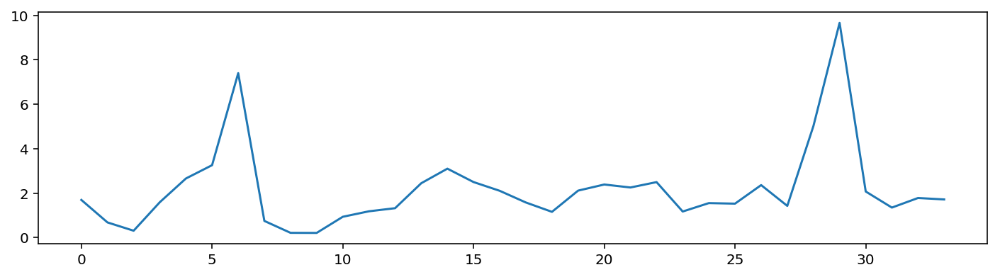

	 	 Test subset results
Test mean absolute percentage error per hour: 2.652177
Test mean absolute percentage error per day: 9.782279 
	 	 Validation Forecasting visualisation


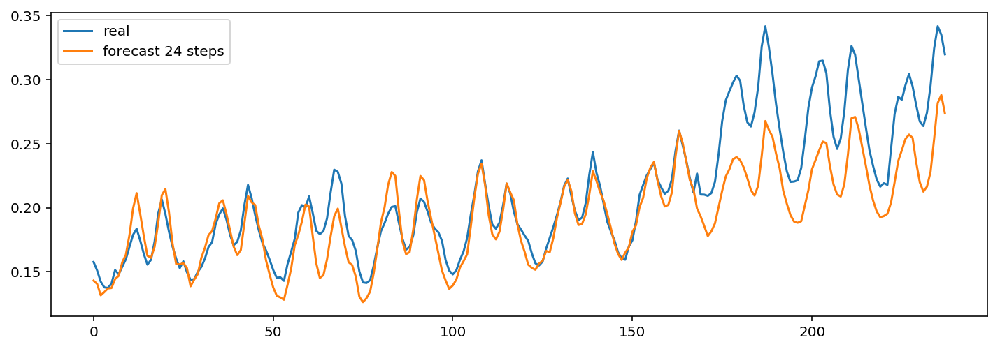

	 	 Forecasting a sample from Learning dataset


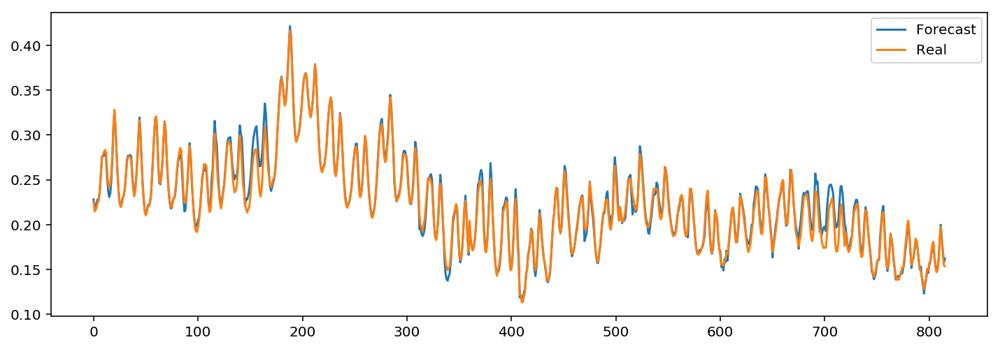

In [16]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 24
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='rmsprop')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 1
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.27872188135 
Daily Learning mean absolute percentage error of 34 days : 3.09273100776 
	 	 MAPError plot through Learning DataSet 


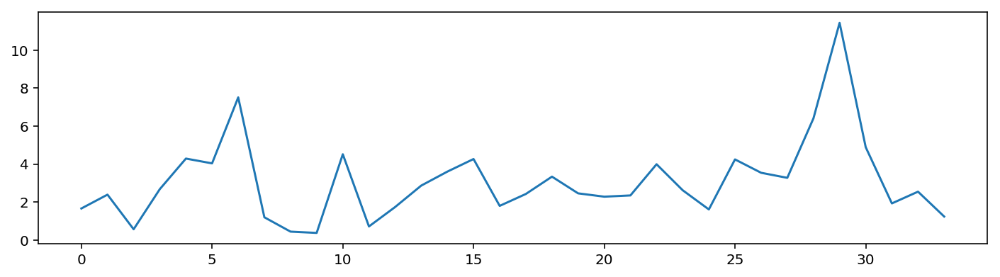

	 	 Test subset results
Test mean absolute percentage error per hour: 2.509345
Test mean absolute percentage error per day: 7.215358 
	 	 Validation Forecasting visualisation


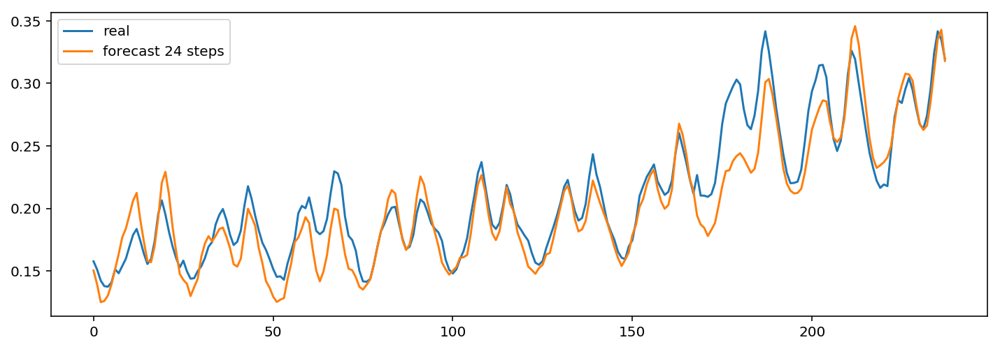

	 	 Forecasting a sample from Learning dataset


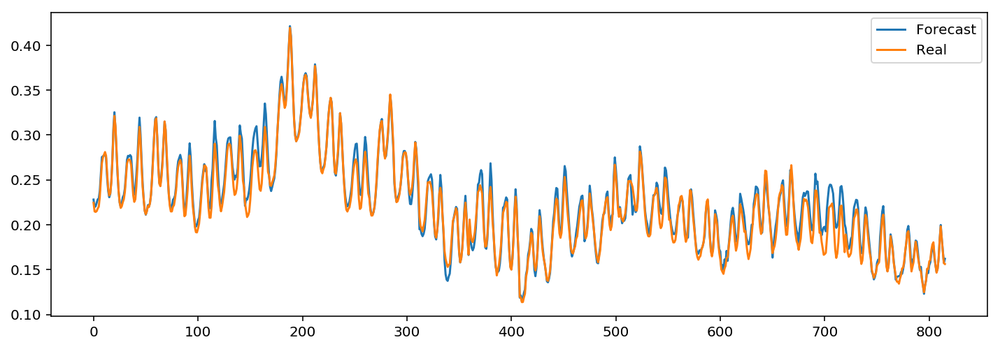

In [17]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='rmsprop')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 2
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.31461083276 
Daily Learning mean absolute percentage error of 34 days : 2.86521773479 
	 	 MAPError plot through Learning DataSet 


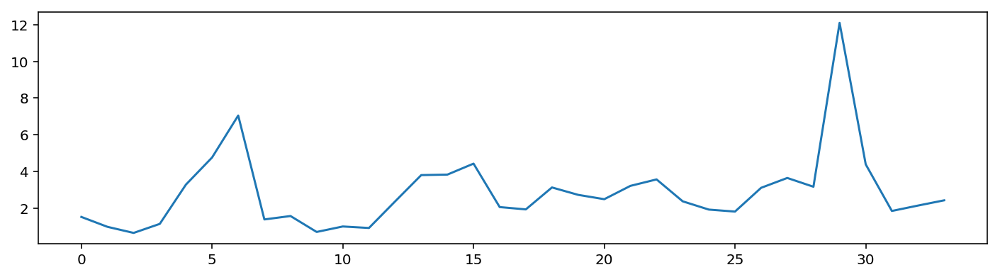

	 	 Test subset results
Test mean absolute percentage error per hour: 2.416992
Test mean absolute percentage error per day: 6.218849 
	 	 Validation Forecasting visualisation


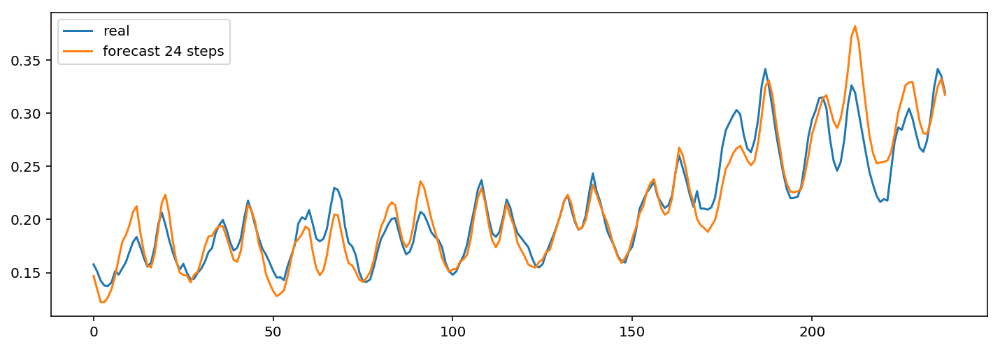

	 	 Forecasting a sample from Learning dataset


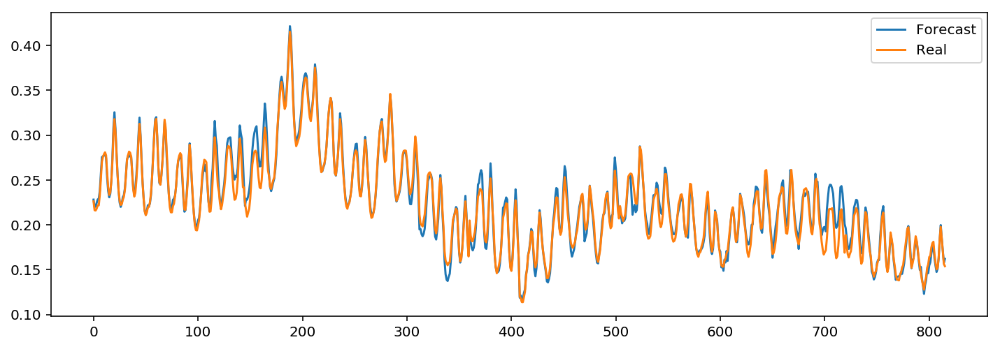

In [18]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='rmsprop')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 3
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.42931881619 
Daily Learning mean absolute percentage error of 34 days : 4.31346814773 
	 	 MAPError plot through Learning DataSet 


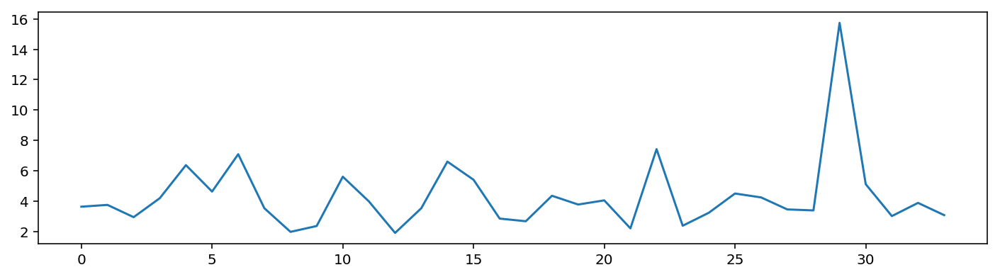

	 	 Test subset results
Test mean absolute percentage error per hour: 2.331339
Test mean absolute percentage error per day: 6.882719 
	 	 Validation Forecasting visualisation


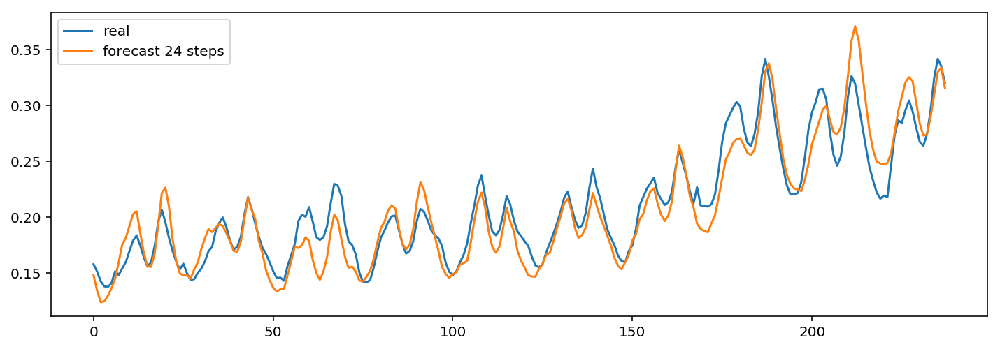

	 	 Forecasting a sample from Learning dataset


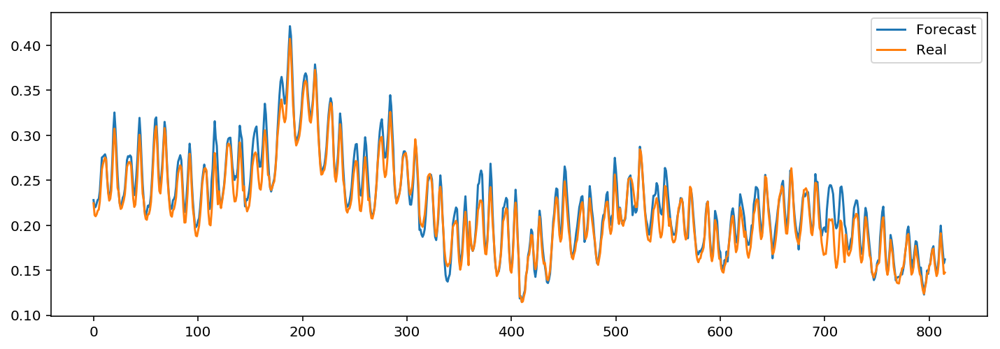

In [19]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 3
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='rmsprop')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 4
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 0.869638877808 
Daily Learning mean absolute percentage error of 34 days : 2.12720230572 
	 	 MAPError plot through Learning DataSet 


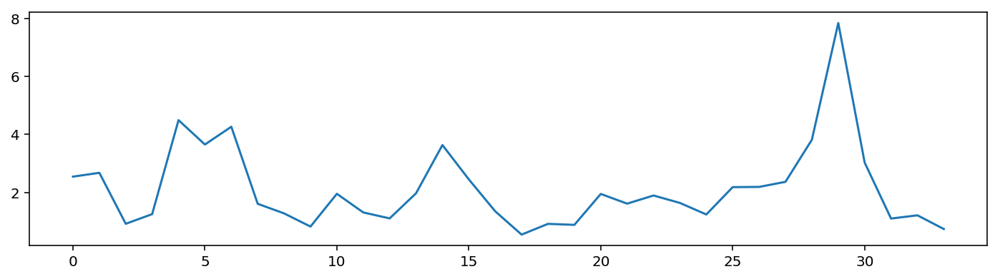

	 	 Test subset results
Test mean absolute percentage error per hour: 2.665690
Test mean absolute percentage error per day: 6.218849 
	 	 Validation Forecasting visualisation


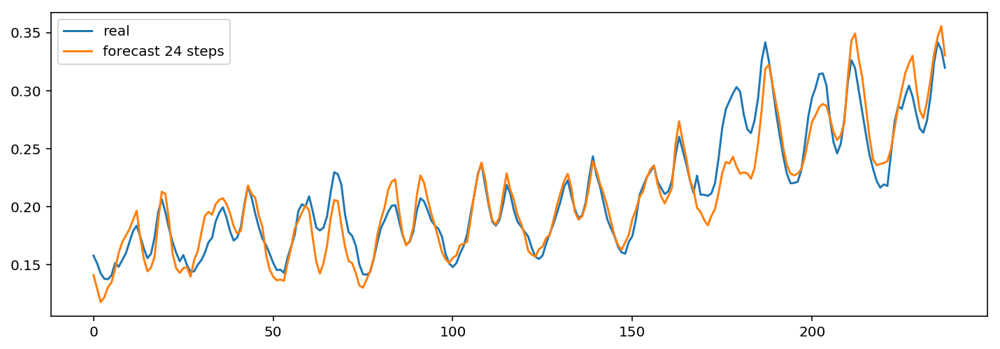

	 	 Forecasting a sample from Learning dataset


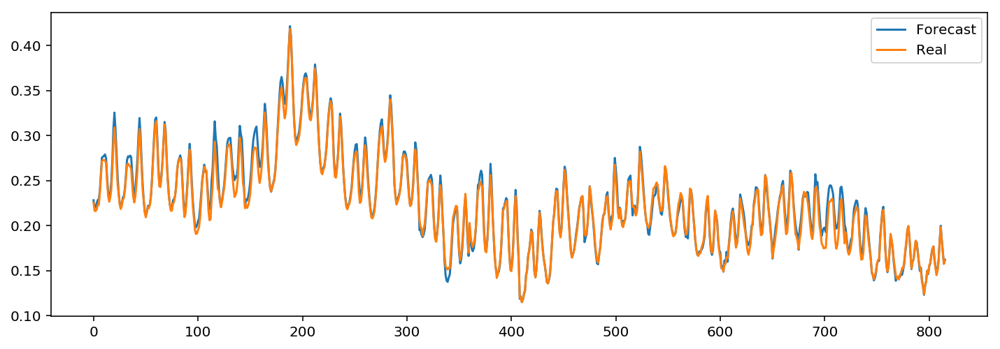

In [20]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 5
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.76953931168 
Daily Learning mean absolute percentage error of 34 days : 3.11437182041 
	 	 MAPError plot through Learning DataSet 


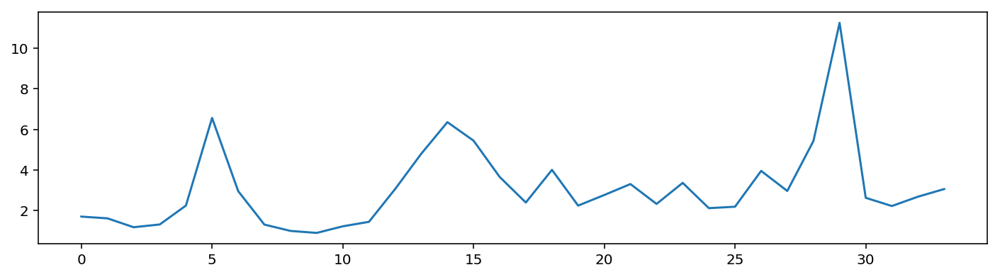

	 	 Test subset results
Test mean absolute percentage error per hour: 3.023197
Test mean absolute percentage error per day: 6.239569 
	 	 Validation Forecasting visualisation


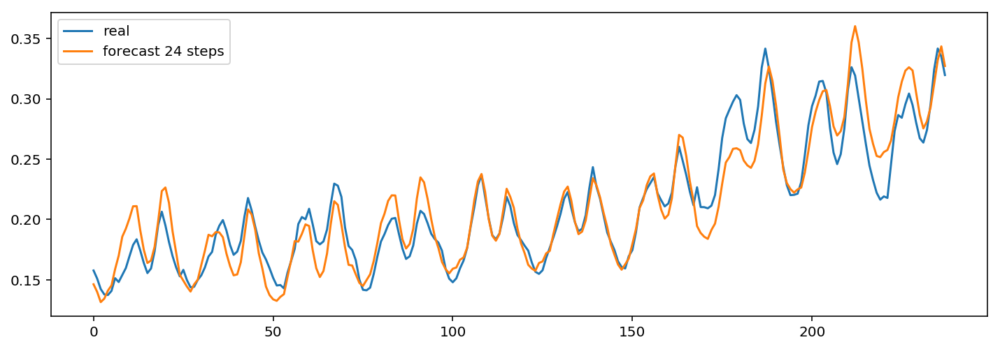

	 	 Forecasting a sample from Learning dataset


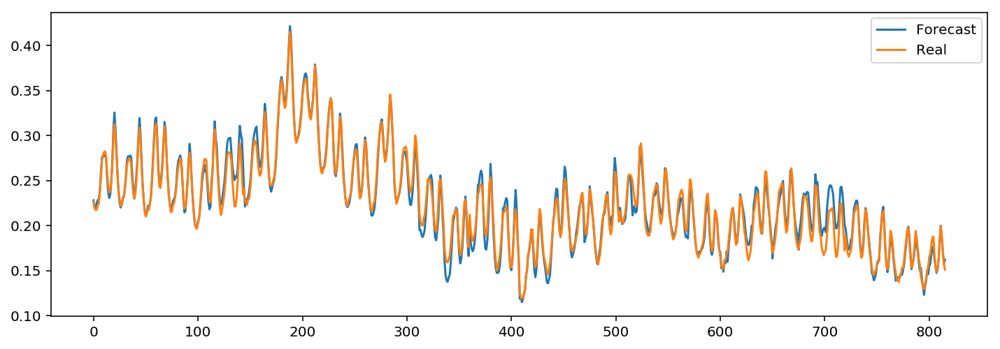

In [21]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 60
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 6
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.19250600289 
Daily Learning mean absolute percentage error of 34 days : 2.88461686583 
	 	 MAPError plot through Learning DataSet 


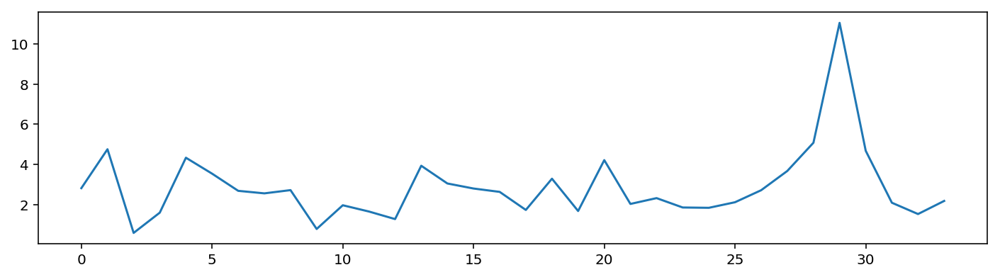

	 	 Test subset results
Test mean absolute percentage error per hour: 2.740664
Test mean absolute percentage error per day: 7.017811 
	 	 Validation Forecasting visualisation


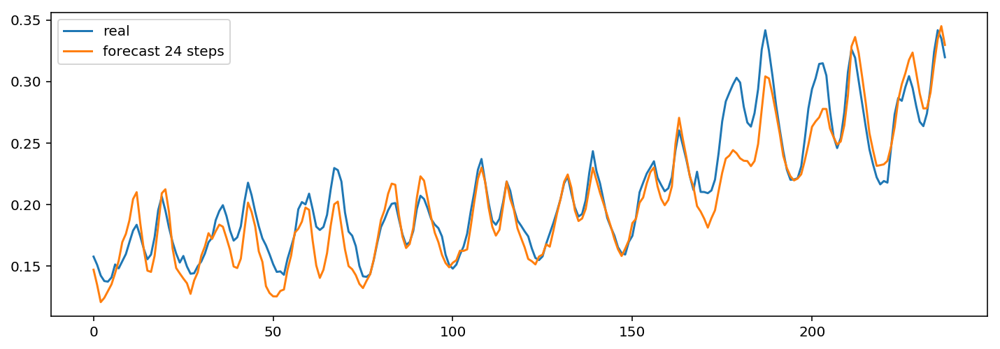

	 	 Forecasting a sample from Learning dataset


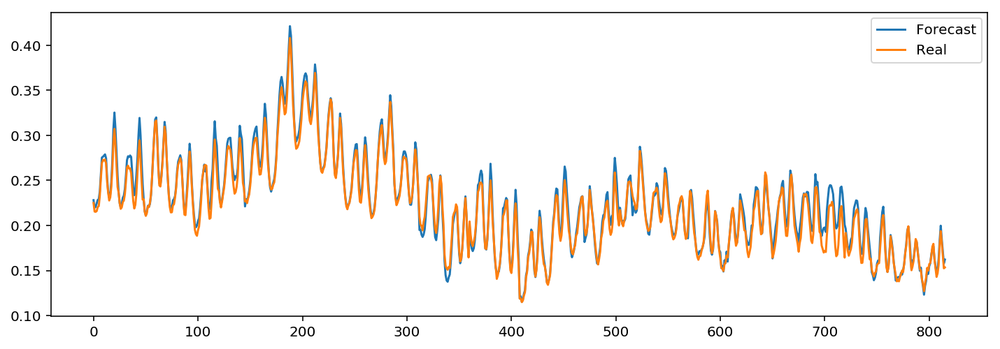

In [22]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 50
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 7
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.23148255723 
Daily Learning mean absolute percentage error of 34 days : 2.96171321764 
	 	 MAPError plot through Learning DataSet 


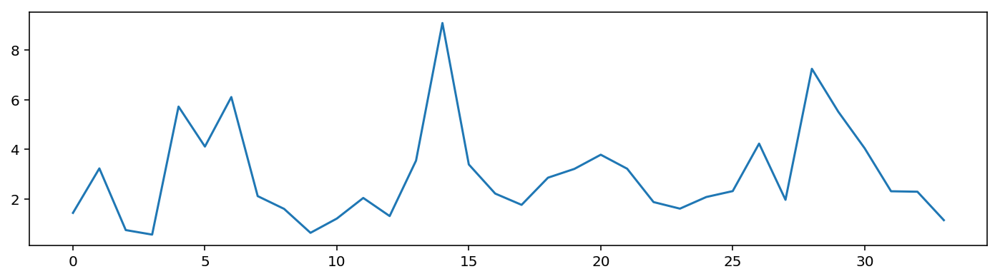

	 	 Test subset results
Test mean absolute percentage error per hour: 2.854140
Test mean absolute percentage error per day: 7.097808 
	 	 Validation Forecasting visualisation


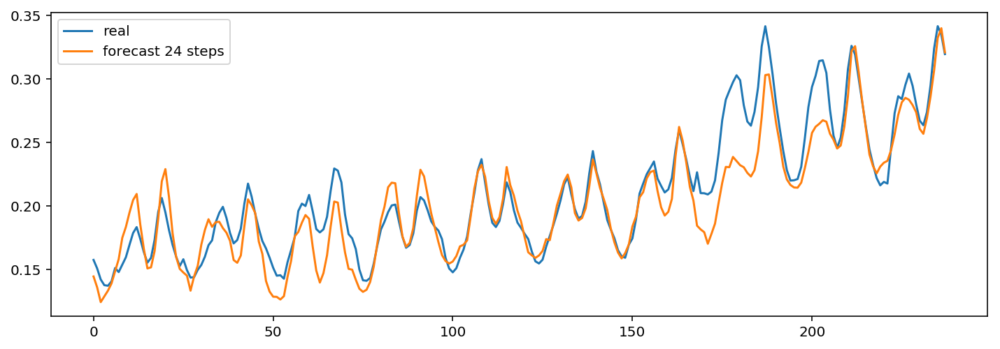

	 	 Forecasting a sample from Learning dataset


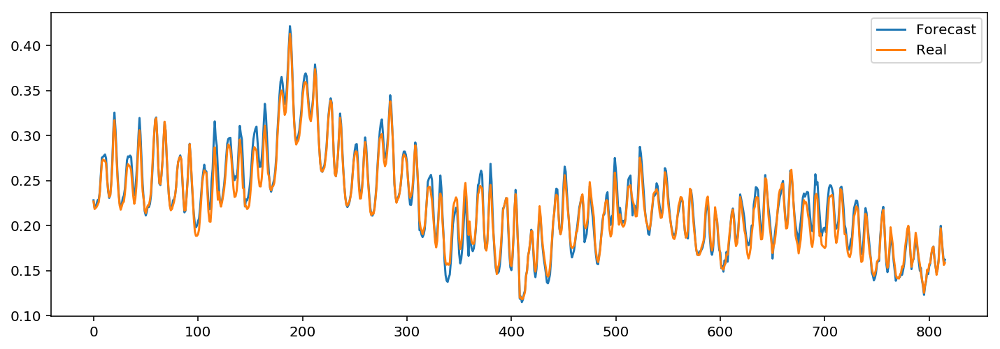

In [23]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 80
Parameters[1]= HiddenNeurons2 = 50
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 8
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.83796104017 
Daily Learning mean absolute percentage error of 34 days : 4.11252076836 
	 	 MAPError plot through Learning DataSet 


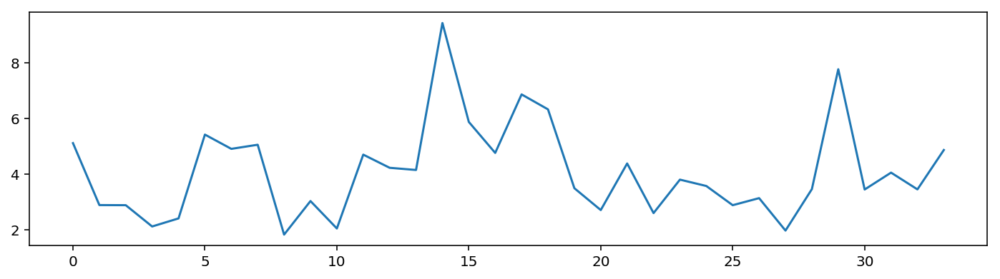

	 	 Test subset results
Test mean absolute percentage error per hour: 2.120101
Test mean absolute percentage error per day: 5.774046 
	 	 Validation Forecasting visualisation


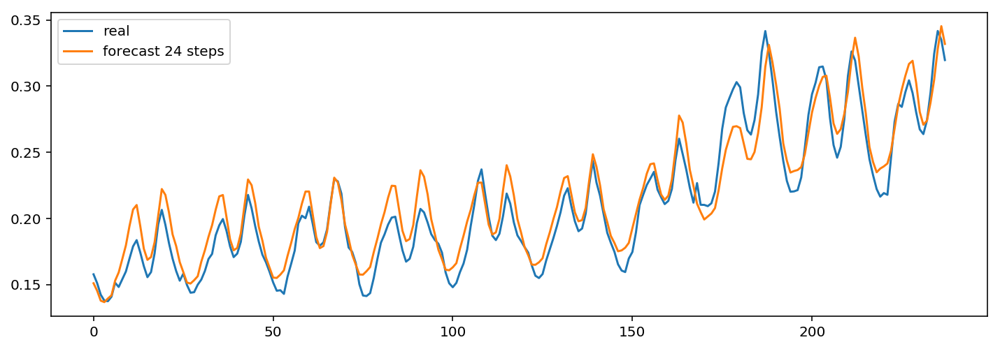

	 	 Forecasting a sample from Learning dataset


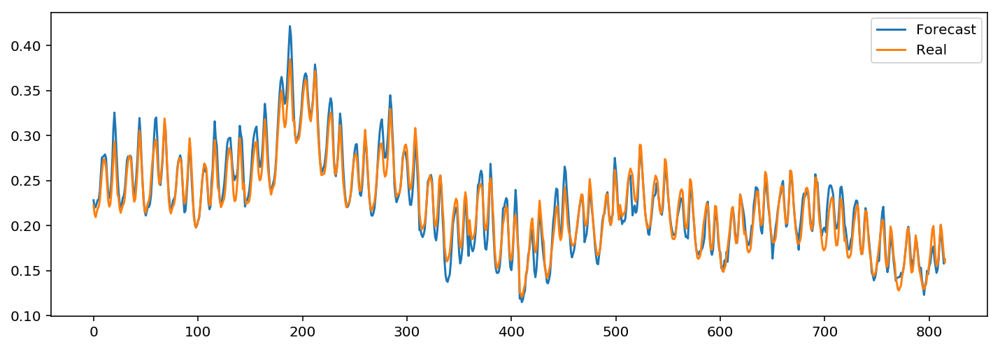

In [24]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 9
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 2.74312260191 
Daily Learning mean absolute percentage error of 34 days : 5.67629037885 
	 	 MAPError plot through Learning DataSet 


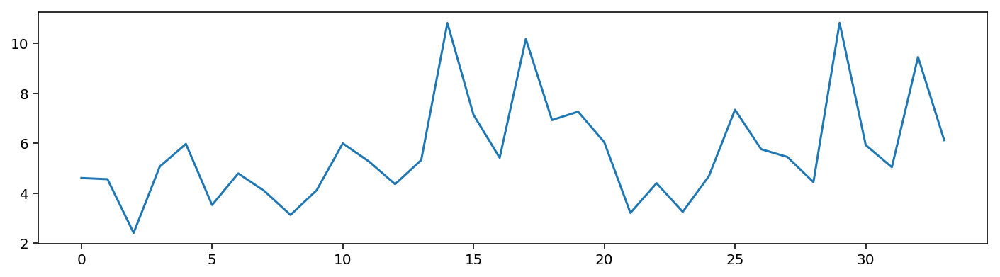

	 	 Test subset results
Test mean absolute percentage error per hour: 2.943298
Test mean absolute percentage error per day: 6.496742 
	 	 Validation Forecasting visualisation


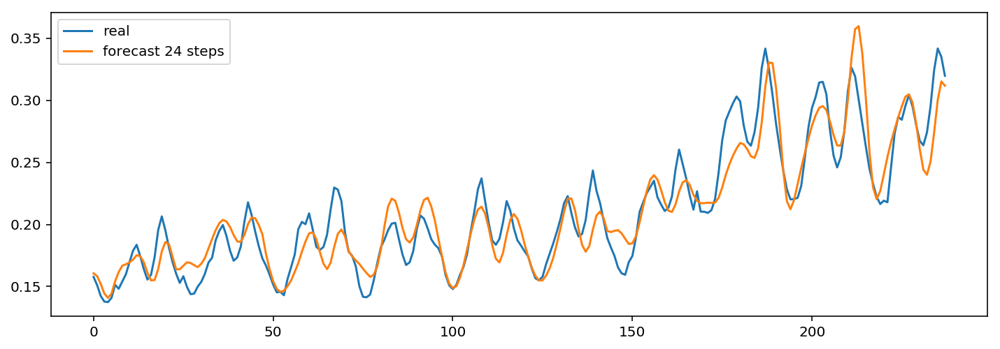

	 	 Forecasting a sample from Learning dataset


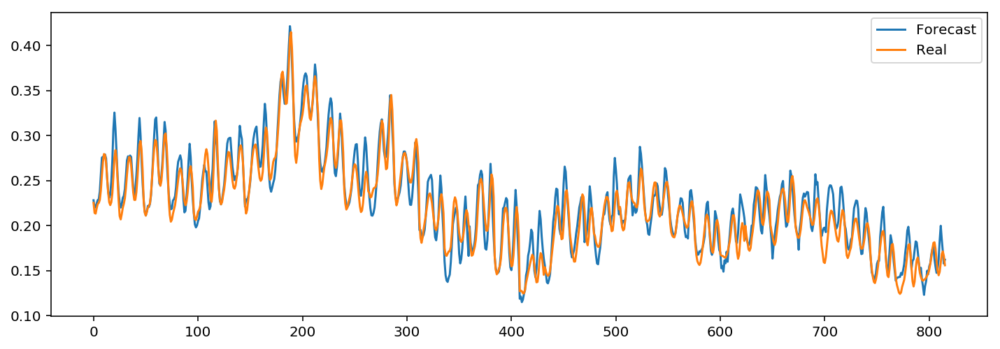

In [25]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 10
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 2.55213888046 
Daily Learning mean absolute percentage error of 34 days : 6.05152140645 
	 	 MAPError plot through Learning DataSet 


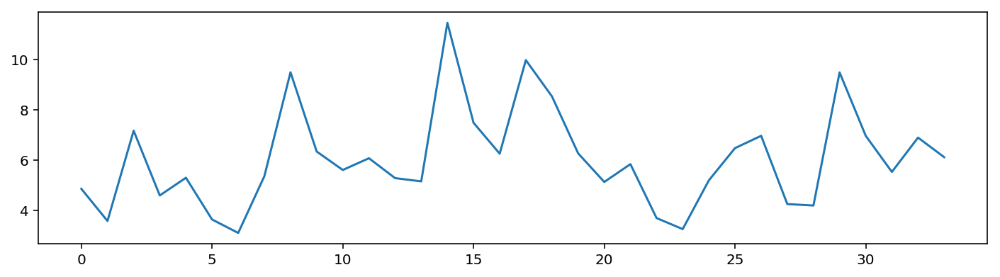

	 	 Test subset results
Test mean absolute percentage error per hour: 2.445688
Test mean absolute percentage error per day: 6.551905 
	 	 Validation Forecasting visualisation


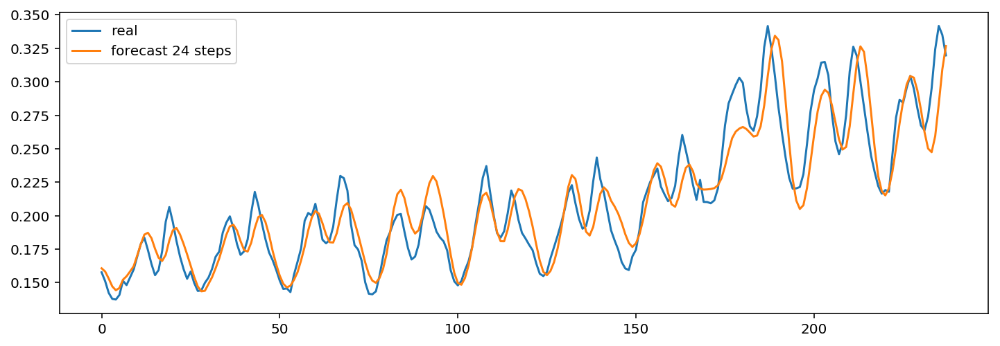

	 	 Forecasting a sample from Learning dataset


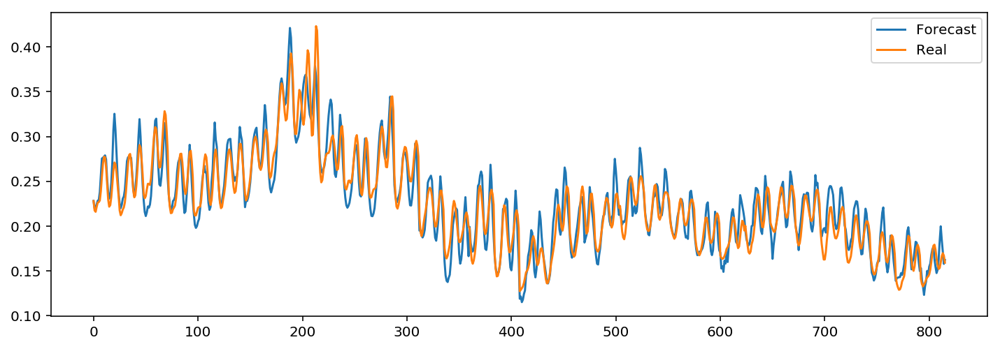

In [26]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 11
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.37747880442 
Daily Learning mean absolute percentage error of 34 days : 3.95493808915 
	 	 MAPError plot through Learning DataSet 


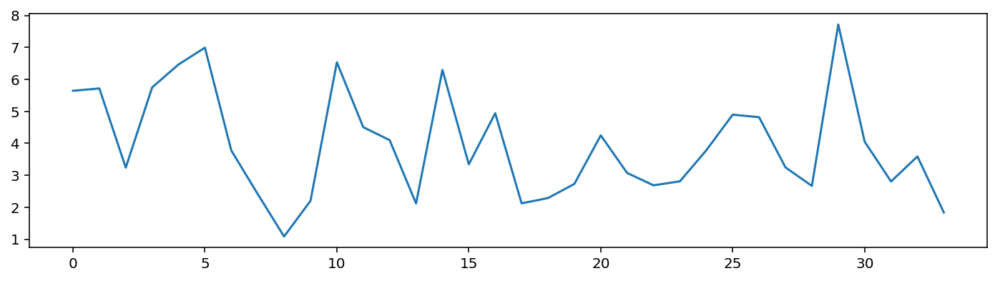

	 	 Test subset results
Test mean absolute percentage error per hour: 3.220234
Test mean absolute percentage error per day: 7.581694 
	 	 Validation Forecasting visualisation


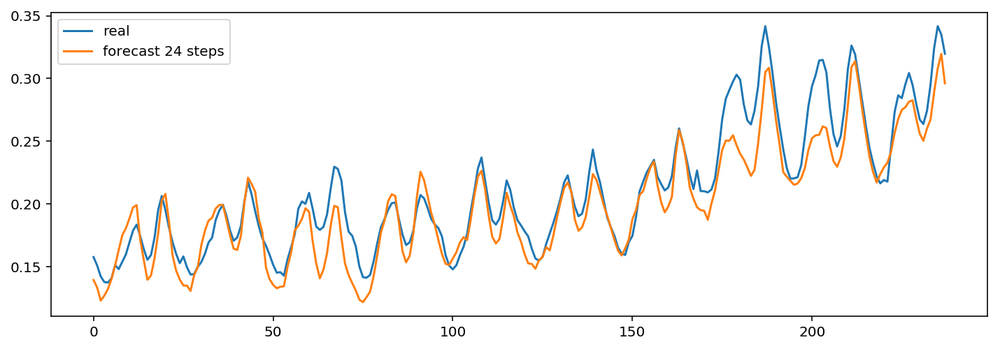

	 	 Forecasting a sample from Learning dataset


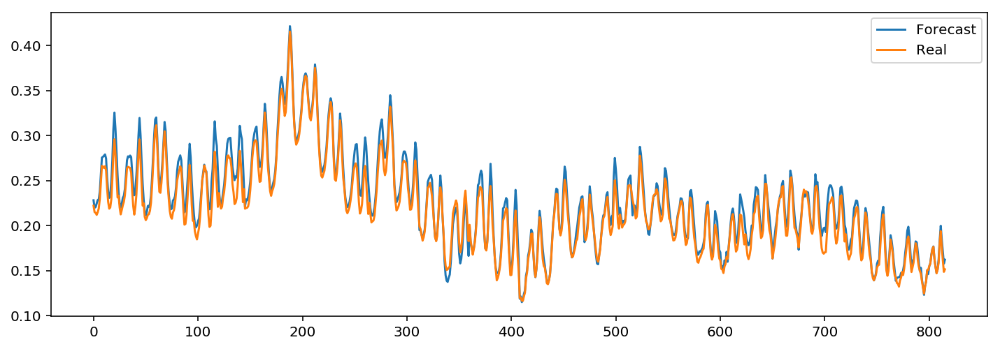

In [27]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 12
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 0.978320105944 
Daily Learning mean absolute percentage error of 34 days : 2.80085979227 
	 	 MAPError plot through Learning DataSet 


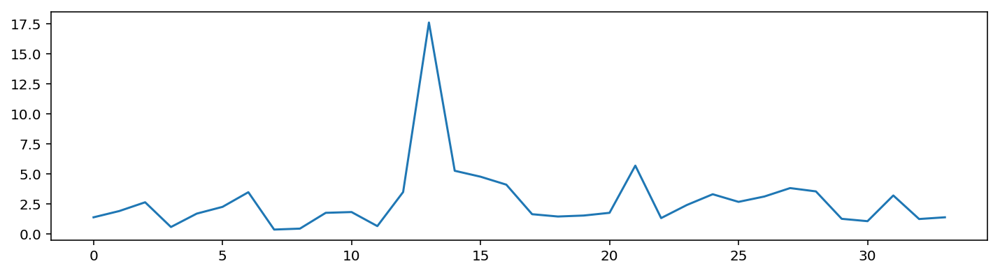

	 	 Test subset results
Test mean absolute percentage error per hour: 2.810282
Test mean absolute percentage error per day: 7.370509 
	 	 Validation Forecasting visualisation


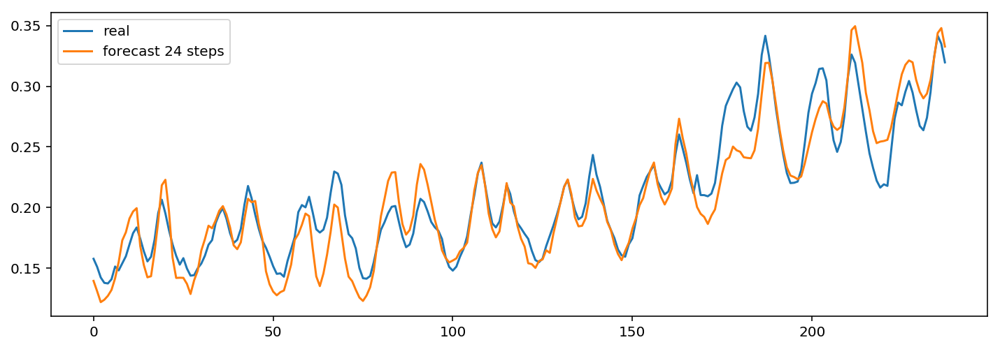

	 	 Forecasting a sample from Learning dataset


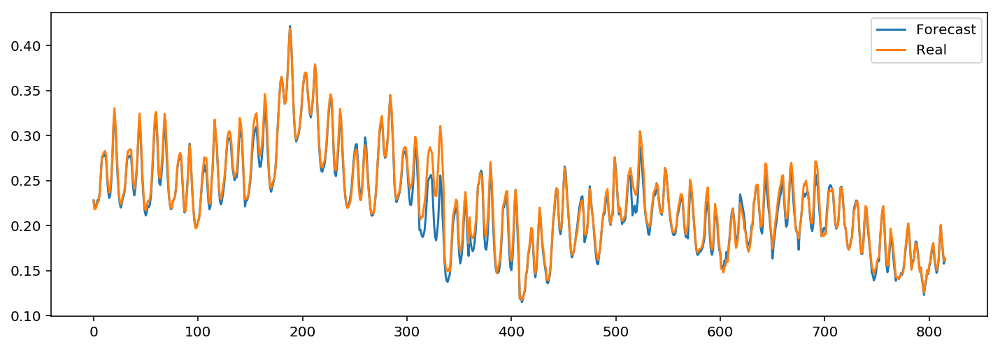

In [28]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 13
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.29358794875 
Daily Learning mean absolute percentage error of 34 days : 3.16995602233 
	 	 MAPError plot through Learning DataSet 


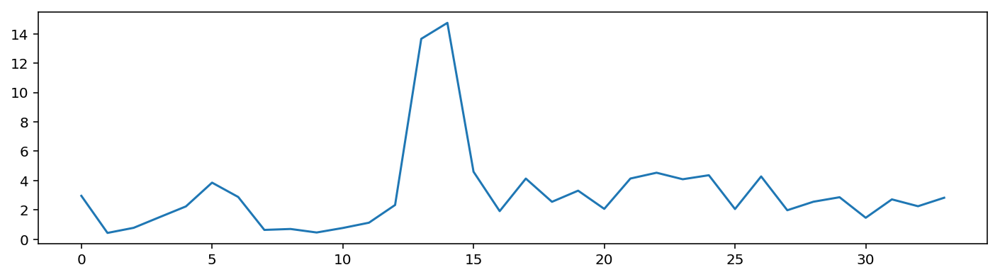

	 	 Test subset results
Test mean absolute percentage error per hour: 2.903455
Test mean absolute percentage error per day: 6.752858 
	 	 Validation Forecasting visualisation


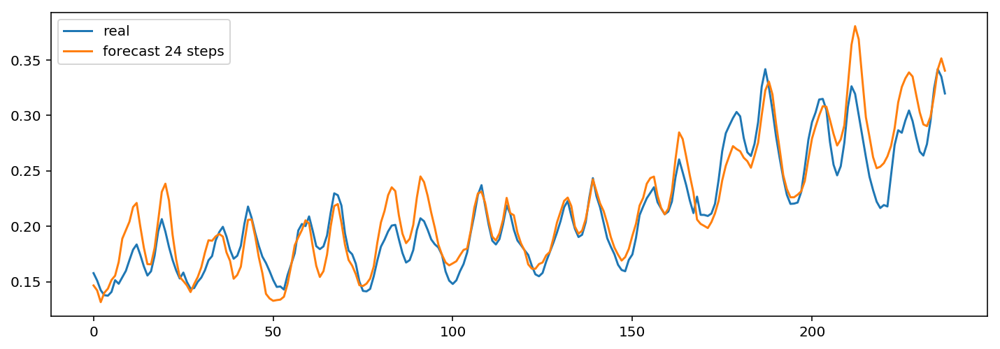

	 	 Forecasting a sample from Learning dataset


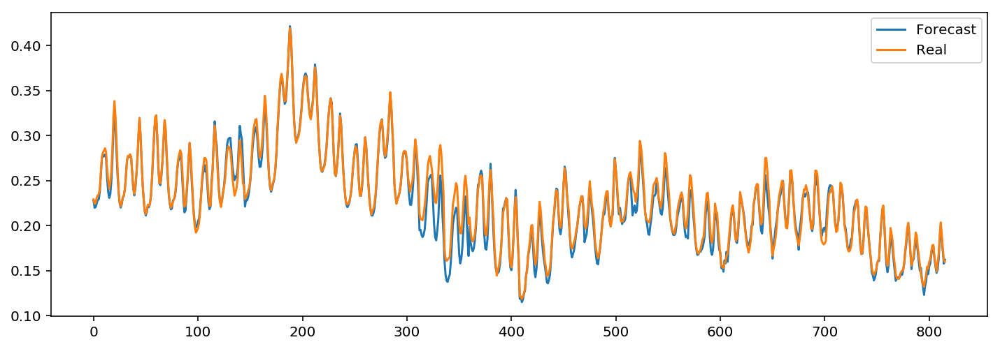

In [29]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 14
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.48568314607 
Daily Learning mean absolute percentage error of 34 days : 3.27655194437 
	 	 MAPError plot through Learning DataSet 


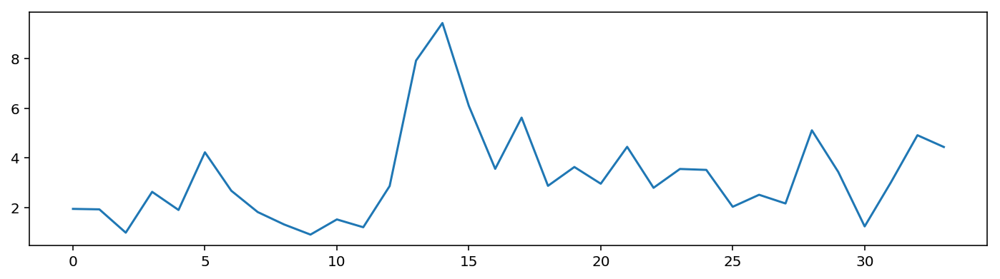

	 	 Test subset results
Test mean absolute percentage error per hour: 3.251175
Test mean absolute percentage error per day: 7.545202 
	 	 Validation Forecasting visualisation


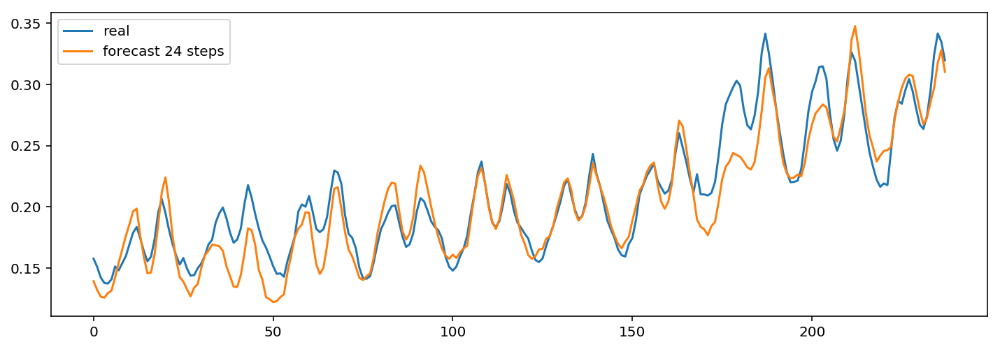

	 	 Forecasting a sample from Learning dataset


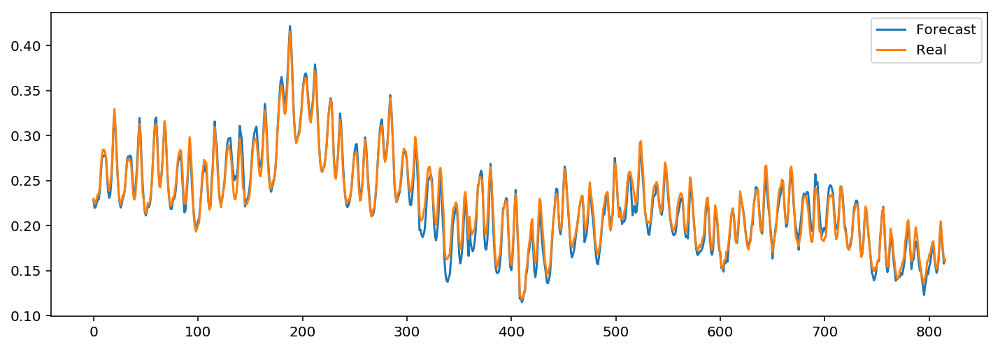

In [30]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 15
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.22701722984 
Daily Learning mean absolute percentage error of 34 days : 4.27577646164 
	 	 MAPError plot through Learning DataSet 


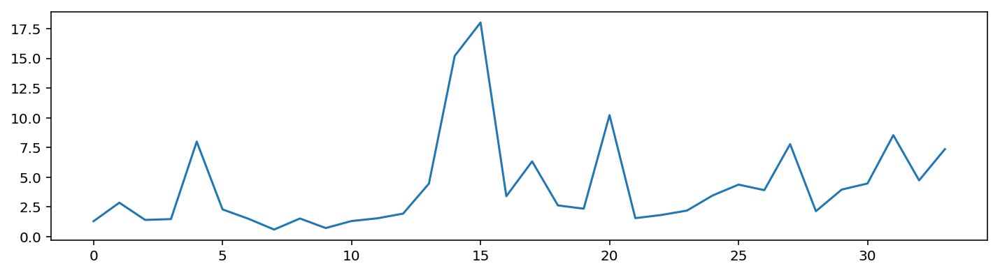

	 	 Test subset results
Test mean absolute percentage error per hour: 3.038817
Test mean absolute percentage error per day: 11.169560 
	 	 Validation Forecasting visualisation


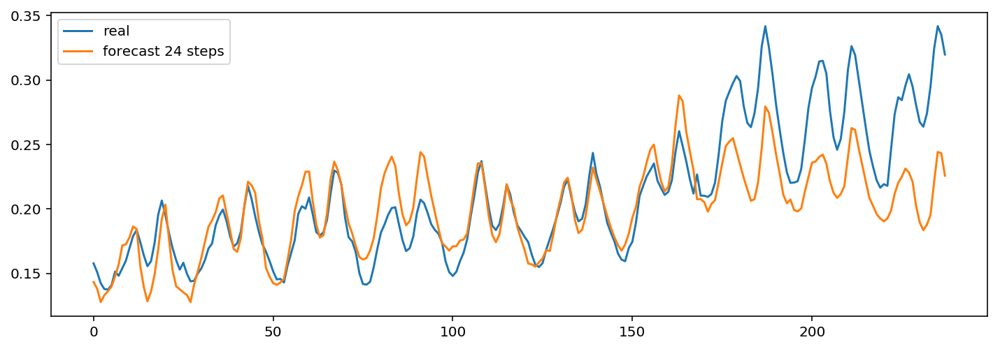

	 	 Forecasting a sample from Learning dataset


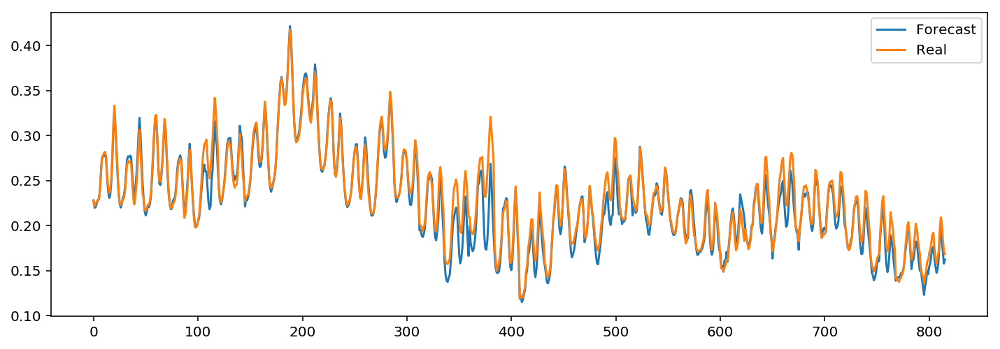

In [31]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 16
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.17461330238 
Daily Learning mean absolute percentage error of 34 days : 2.57000394078 
	 	 MAPError plot through Learning DataSet 


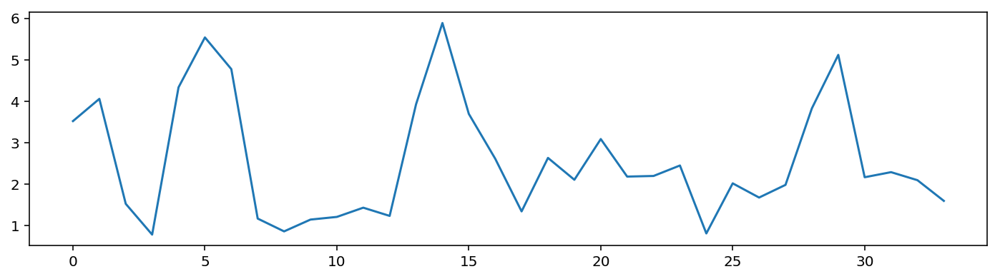

	 	 Test subset results
Test mean absolute percentage error per hour: 3.016278
Test mean absolute percentage error per day: 7.936225 
	 	 Validation Forecasting visualisation


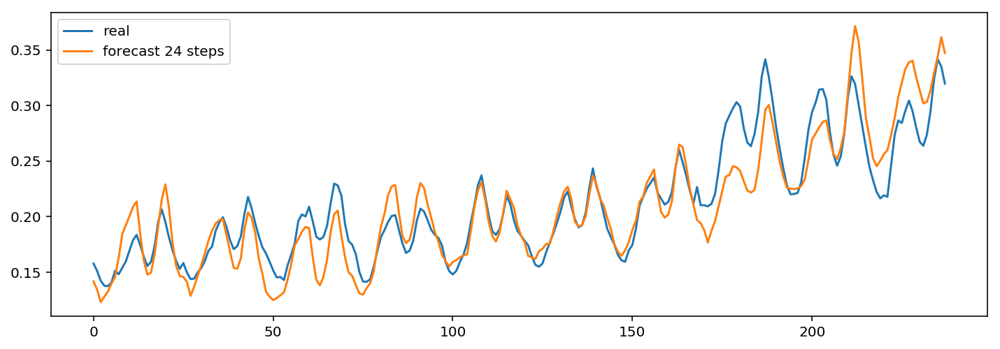

	 	 Forecasting a sample from Learning dataset


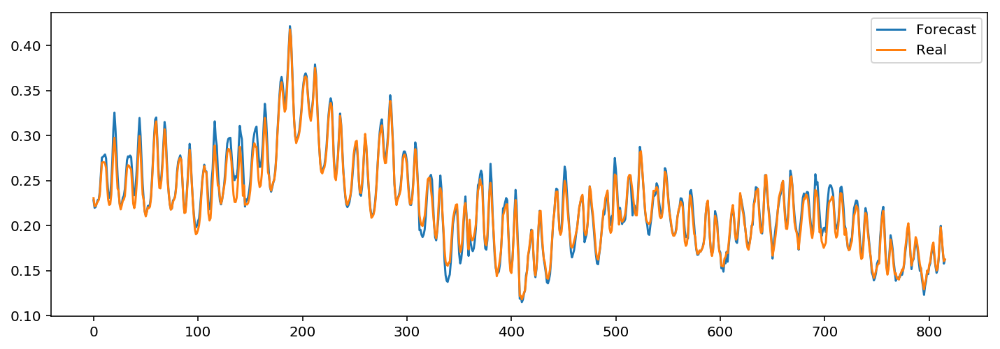

In [32]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = False
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 17
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.85917344776 
Daily Learning mean absolute percentage error of 34 days : 4.55325594018 
	 	 MAPError plot through Learning DataSet 


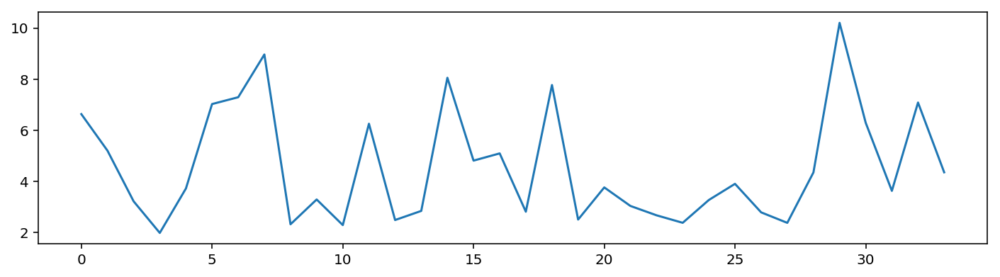

	 	 Test subset results
Test mean absolute percentage error per hour: 2.102488
Test mean absolute percentage error per day: 4.962507 
	 	 Validation Forecasting visualisation


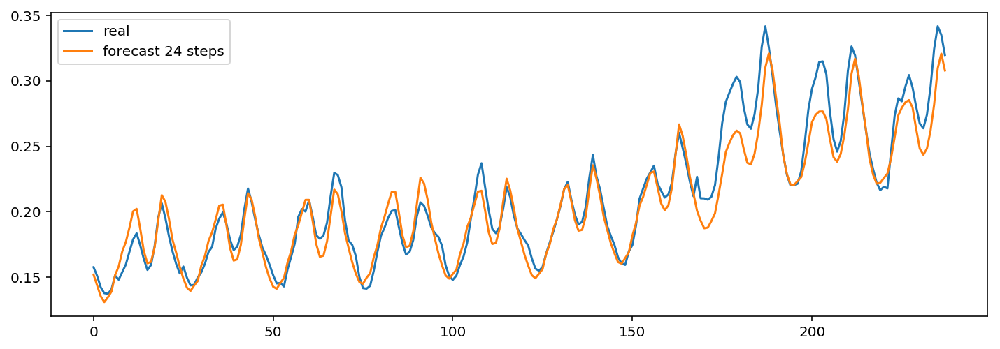

	 	 Forecasting a sample from Learning dataset


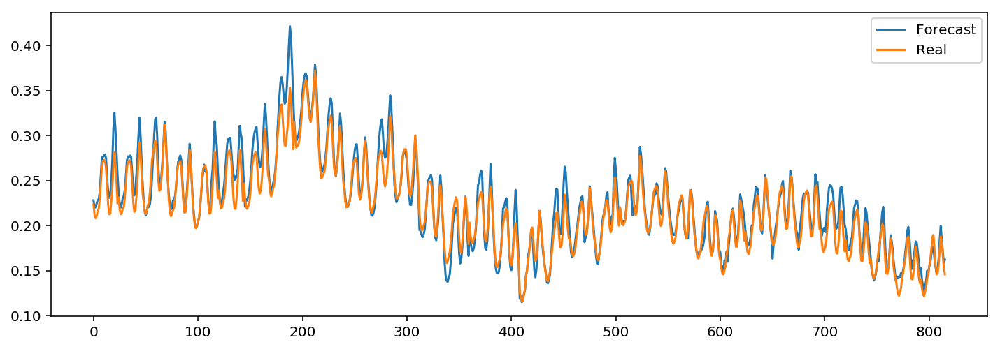

In [33]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.002

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 18
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.79409630824 
Daily Learning mean absolute percentage error of 34 days : 4.48907274358 
	 	 MAPError plot through Learning DataSet 


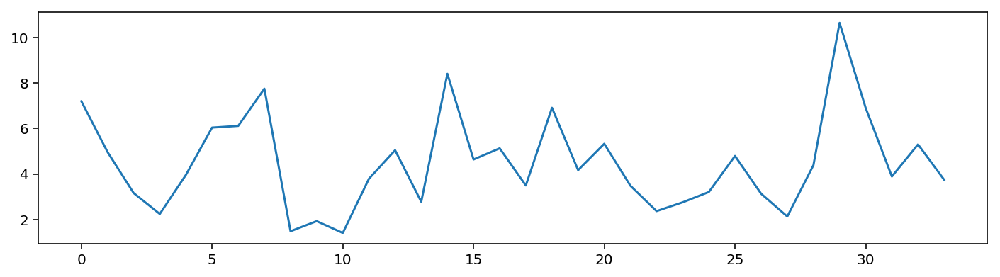

	 	 Test subset results
Test mean absolute percentage error per hour: 1.925752
Test mean absolute percentage error per day: 4.849872 
	 	 Validation Forecasting visualisation


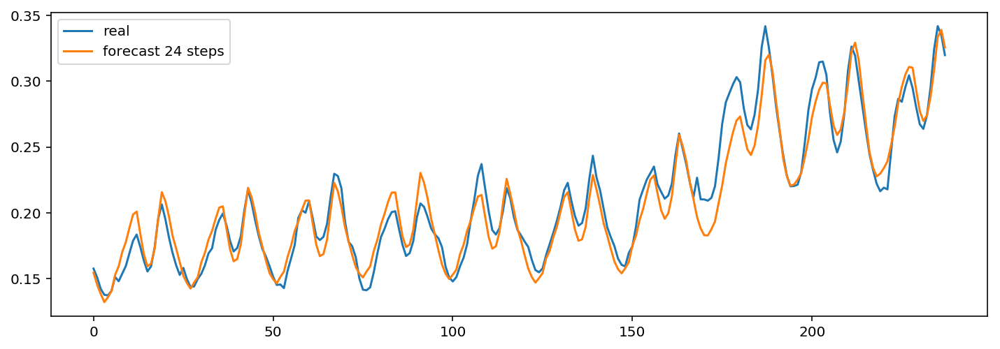

	 	 Forecasting a sample from Learning dataset


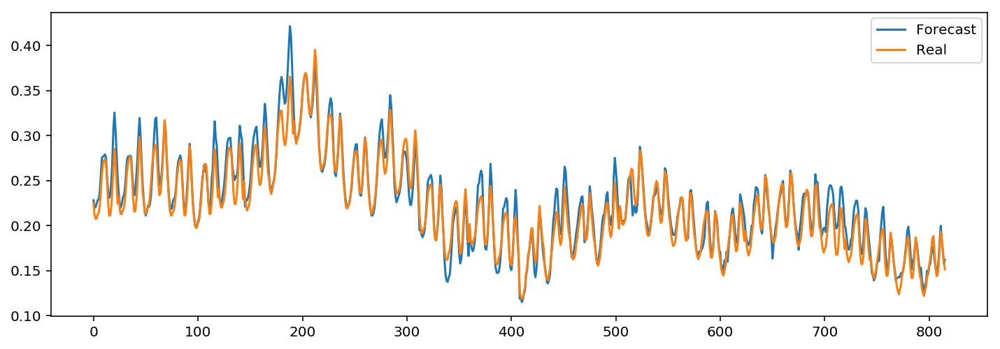

In [34]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.001

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='rmsprop')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

In [92]:
UsedInputs = np.array(UsedInputList)

FinalError= np.array(MAPErrorList)

summary = pd.DataFrame(np.concatenate((Models_IDs,Models_parameters,UsedInputs,FinalError),axis=1),columns=
                       ['Model ID','Neurons L1','Neurons L2','Learning rate','Epochs','Previous hour','Time steps','Previous day'
                        ,'Previous week','Temperature','Temp Max','Temp Min','Day indicator','Hour indicator','Training MAPE %',
                        'Test MAPE %'])

summary

,Model ID,Neurons L1,Neurons L2,Learning rate,Epochs,Previous hour,Time steps,Previous day,Previous week,Temperature,Temp Max,Temp Min,Day indicator,Hour indicator,Training MAPE %,Test MAPE %
0,0.0,20.0,10.0,0.001,2937.0,1.0,24.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.176004,9.782279
1,1.0,20.0,10.0,0.001,2758.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.092731,7.215358
2,2.0,20.0,10.0,0.001,2784.0,1.0,6.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.865218,6.218849
3,3.0,20.0,10.0,0.001,2879.0,1.0,3.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.313468,6.882719
4,4.0,20.0,10.0,0.001,2159.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.127202,6.218849
5,5.0,60.0,30.0,0.001,361.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.114372,6.239569
6,6.0,50.0,10.0,0.001,1037.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.884617,7.017811
7,7.0,80.0,50.0,0.001,751.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.961713,7.097808
8,8.0,90.0,30.0,0.002,722.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,4.112521,5.774046
9,9.0,90.0,30.0,0.002,547.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,5.676290,6.496742


In [28]:
UsedInputs = np.array(UsedInputList)

FinalError= np.array(MAPErrorList)

summary = pd.DataFrame(np.concatenate((Models_IDs,Models_parameters,UsedInputs,FinalError),axis=1),columns=
                       ['Model ID','Neurons L1','Neurons L2','Learning rate','Epochs','Previous hour','Time steps','Previous day'
                        ,'Previous week','Temperature','Temp Max','Temp Min','Day indicator','Hour indicator','Training MAPE %',
                        'Test MAPE %'])

summary

,Model ID,Neurons L1,Neurons L2,Learning rate,Epochs,Previous hour,Time steps,Previous day,Previous week,Temperature,Temp Max,Temp Min,Day indicator,Hour indicator,Training MAPE %,Test MAPE %
0,0.0,20.0,10.0,0.001,2699.0,1.0,24.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.069598,13.012778
1,1.0,20.0,10.0,0.001,2925.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.044957,9.125607
2,2.0,20.0,10.0,0.001,2854.0,1.0,6.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.716013,6.044361
3,3.0,20.0,10.0,0.001,2909.0,1.0,3.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.453856,6.599628
4,4.0,20.0,10.0,0.001,948.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.700177,8.736145
5,5.0,60.0,30.0,0.001,711.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.753479,6.794950
6,6.0,50.0,10.0,0.001,588.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.343529,6.629674
7,7.0,80.0,50.0,0.001,328.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.725810,6.411095
8,8.0,90.0,30.0,0.002,531.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,3.766765,4.726010
9,9.0,90.0,30.0,0.002,955.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,6.009859,6.724455


In [85]:

del(MAPErrorList[19],ModelsList[19],ForecastingList[19],Models_IDs[19],Models_parameters[19])

	 	 test num : 20
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.89526055901 
Daily Learning mean absolute percentage error of 34 days : 4.68708305499 
	 	 MAPError plot through Learning DataSet 


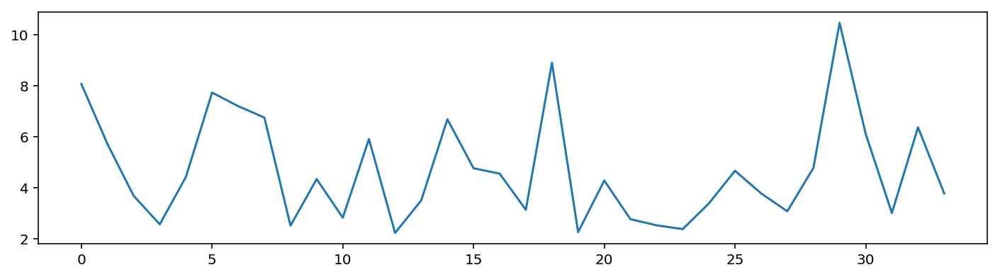

	 	 Test subset results
Test mean absolute percentage error per hour: 2.263838
Test mean absolute percentage error per day: 5.293975 
	 	 Validation Forecasting visualisation


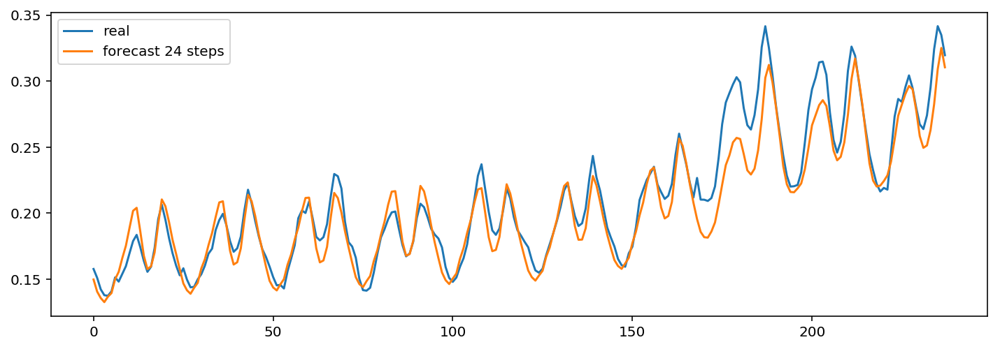

	 	 Forecasting a sample from Learning dataset


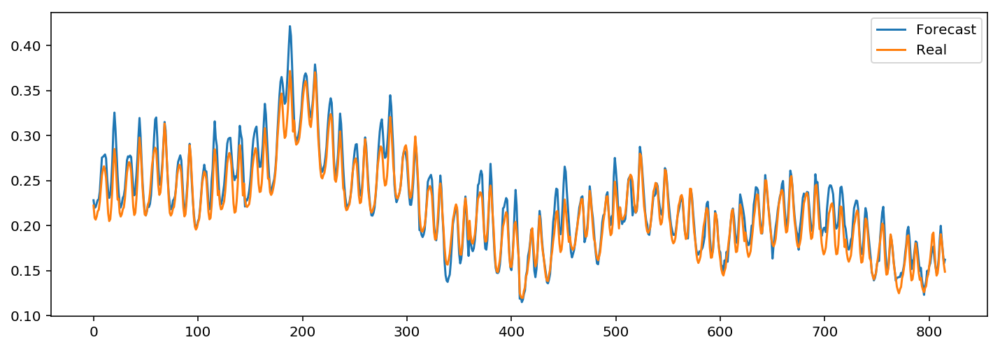

In [79]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 21
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.92223669863 
Daily Learning mean absolute percentage error of 34 days : 4.94381749981 
	 	 MAPError plot through Learning DataSet 


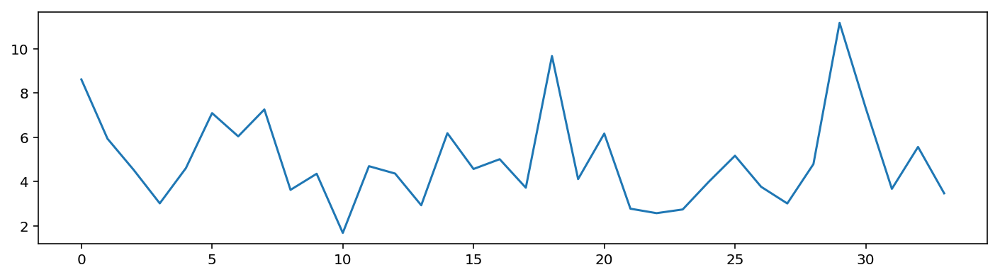

	 	 Test subset results
Test mean absolute percentage error per hour: 2.128625
Test mean absolute percentage error per day: 5.875850 
	 	 Validation Forecasting visualisation


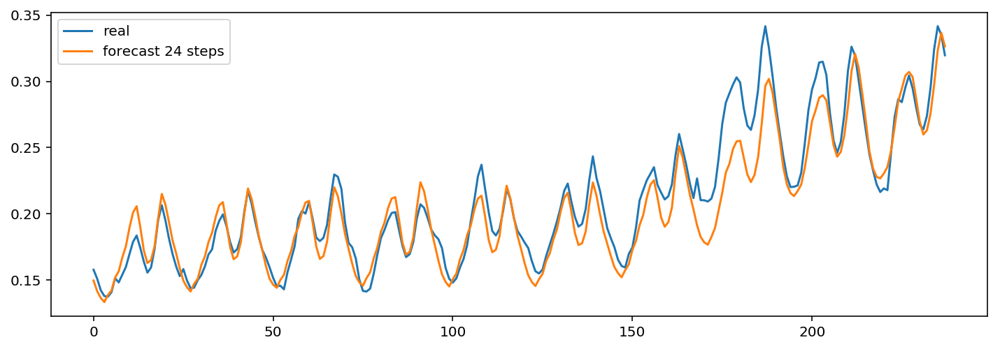

	 	 Forecasting a sample from Learning dataset


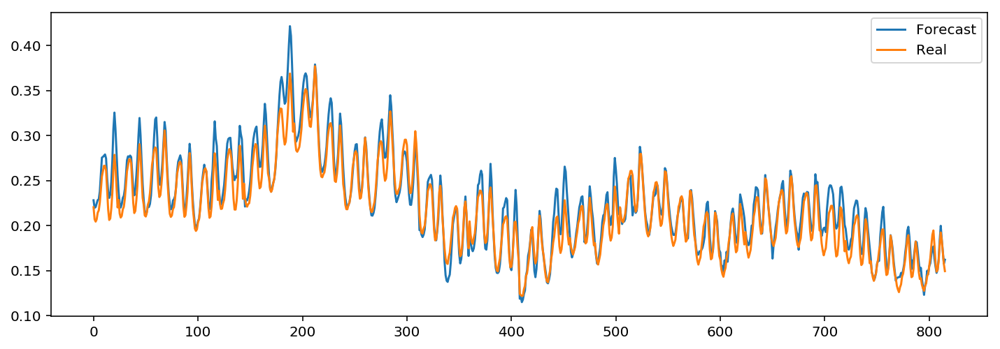

In [90]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 22
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.89910055612 
Daily Learning mean absolute percentage error of 34 days : 4.32790586878 
	 	 MAPError plot through Learning DataSet 


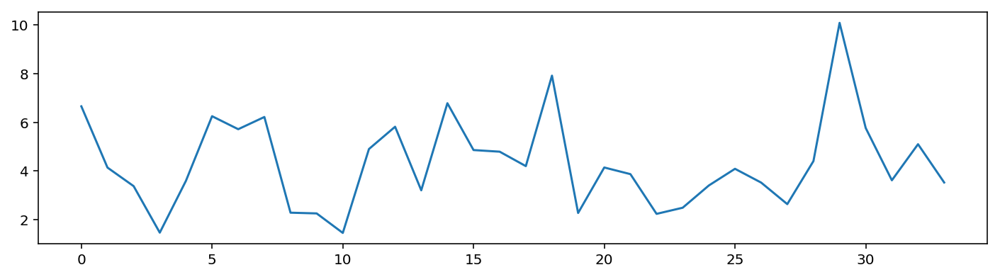

	 	 Test subset results
Test mean absolute percentage error per hour: 2.176465
Test mean absolute percentage error per day: 4.808832 
	 	 Validation Forecasting visualisation


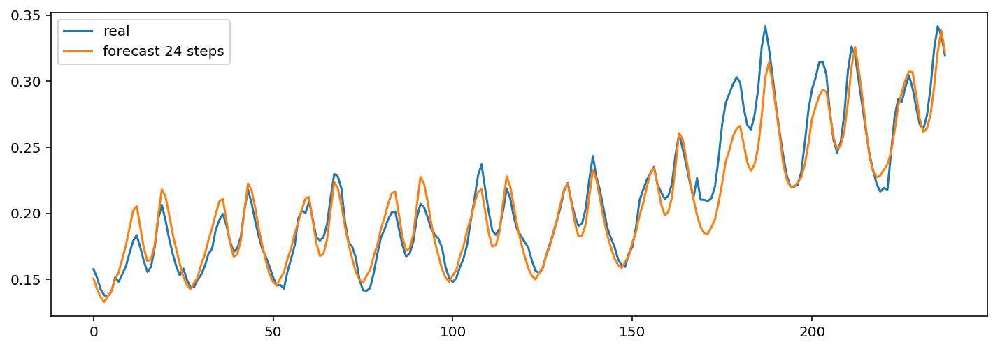

	 	 Forecasting a sample from Learning dataset


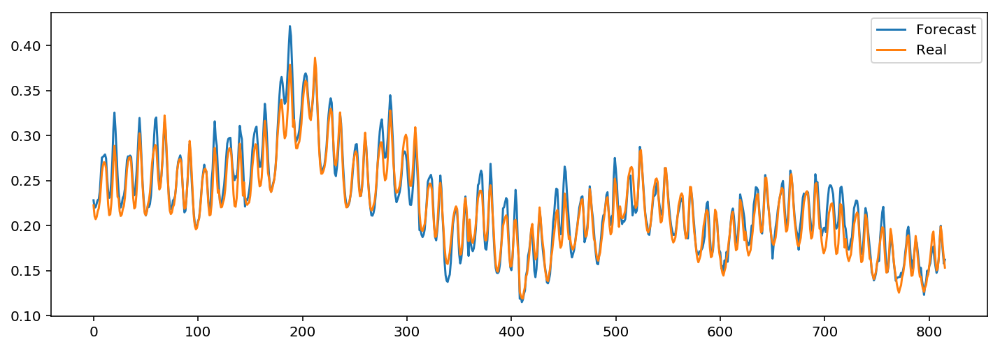

In [91]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 60
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 23
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 5.09663342333 
Daily Learning mean absolute percentage error of 34 days : 10.6185416755 
	 	 MAPError plot through Learning DataSet 


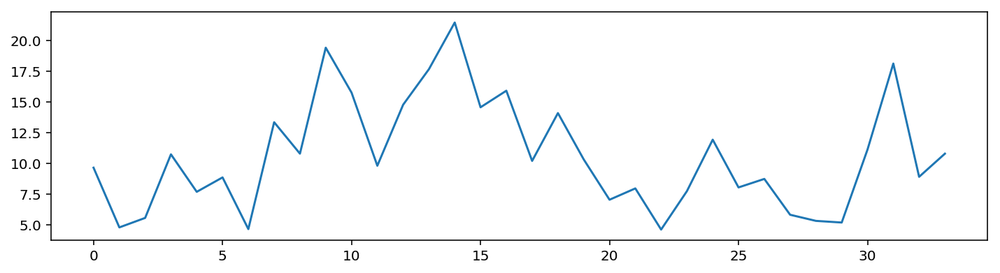

	 	 Test subset results
Test mean absolute percentage error per hour: 3.656994
Test mean absolute percentage error per day: 6.922600 
	 	 Validation Forecasting visualisation


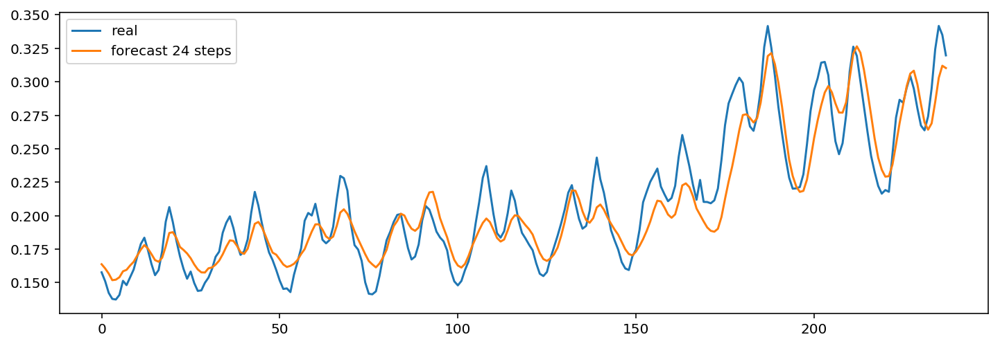

	 	 Forecasting a sample from Learning dataset


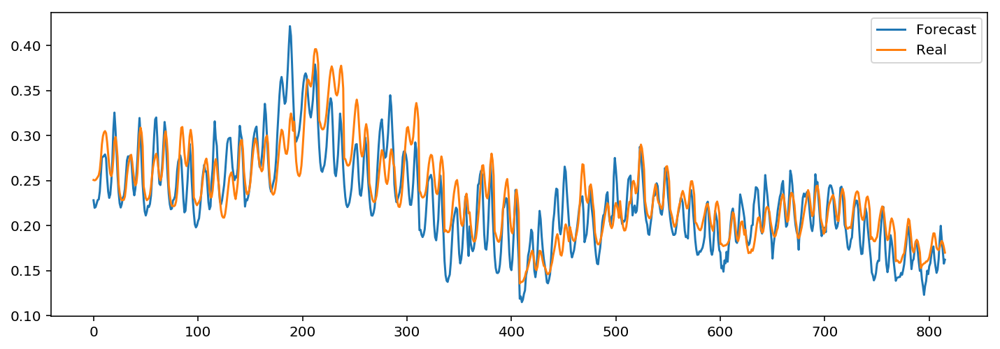

In [94]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 1
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 60
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 24
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 3.31834903475 
Daily Learning mean absolute percentage error of 34 days : 10.9792788029 
	 	 MAPError plot through Learning DataSet 


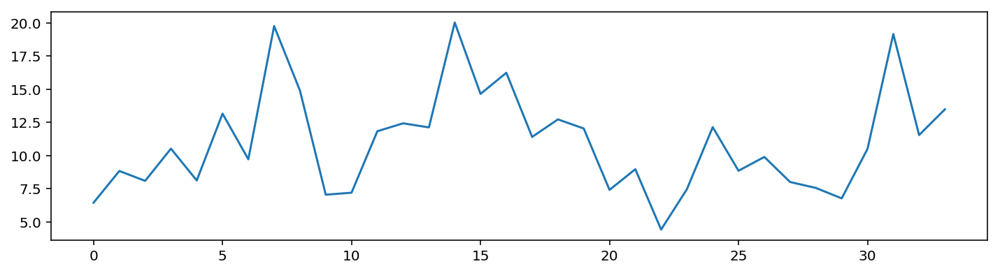

	 	 Test subset results
Test mean absolute percentage error per hour: 2.789995
Test mean absolute percentage error per day: 9.600909 
	 	 Validation Forecasting visualisation


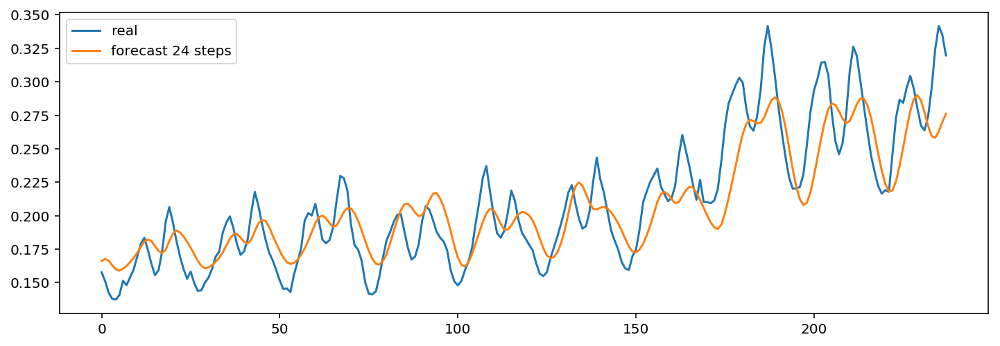

	 	 Forecasting a sample from Learning dataset


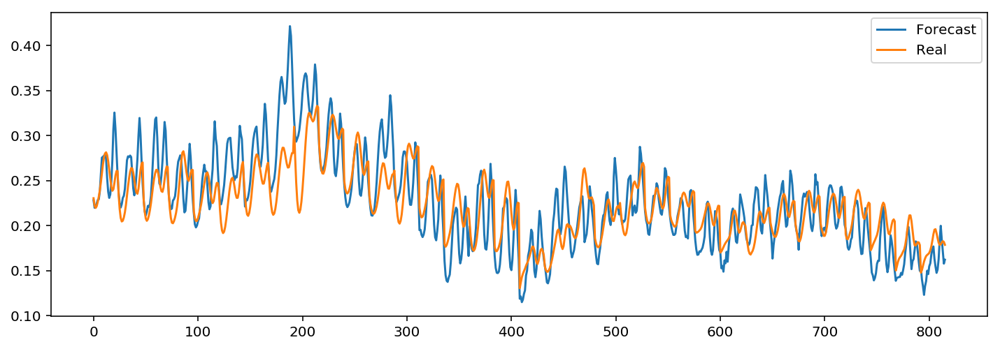

In [95]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 2
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 60
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 25
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 3.26994191109 
Daily Learning mean absolute percentage error of 34 days : 10.8984640206 
	 	 MAPError plot through Learning DataSet 


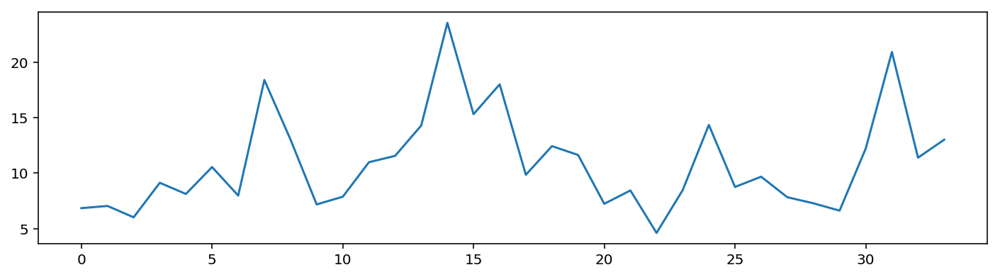

	 	 Test subset results
Test mean absolute percentage error per hour: 2.782458
Test mean absolute percentage error per day: 9.545062 
	 	 Validation Forecasting visualisation


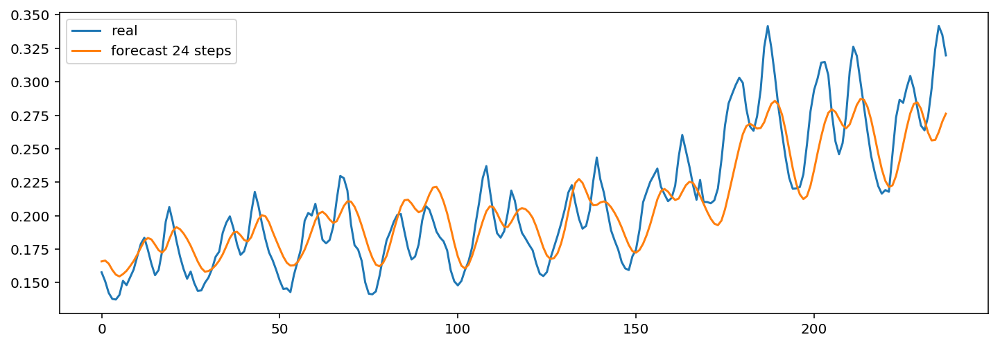

	 	 Forecasting a sample from Learning dataset


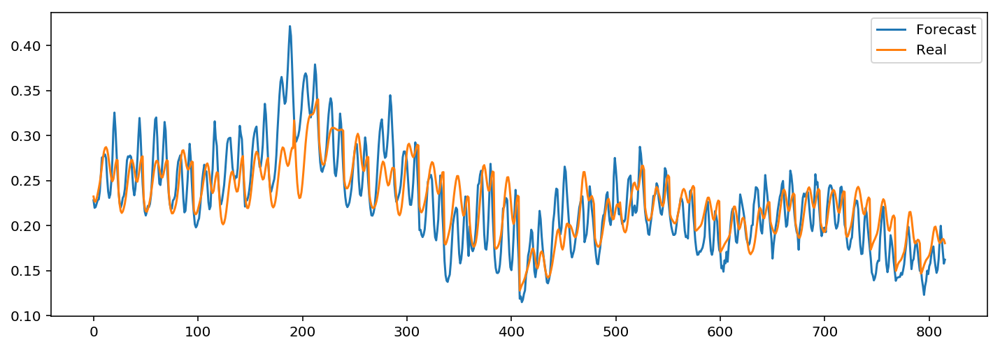

In [96]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 3
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 60
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 26
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 3.15118725692 
Daily Learning mean absolute percentage error of 34 days : 12.3188884258 
	 	 MAPError plot through Learning DataSet 


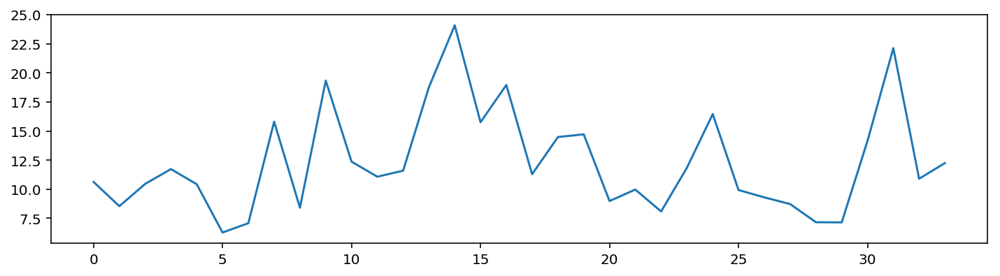

	 	 Test subset results
Test mean absolute percentage error per hour: 2.870495
Test mean absolute percentage error per day: 8.928937 
	 	 Validation Forecasting visualisation


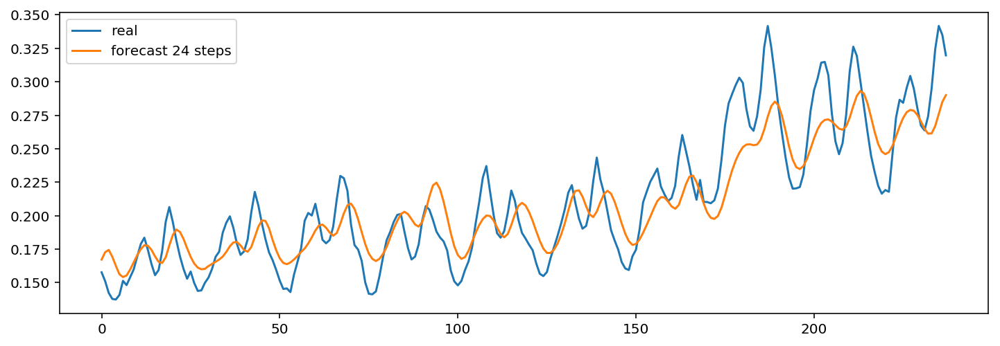

	 	 Forecasting a sample from Learning dataset


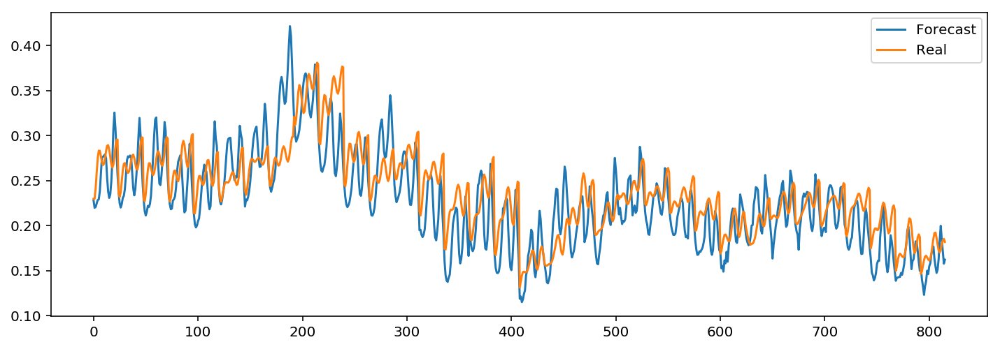

In [98]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 5
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 60
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 27
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 3.10728018244 
Daily Learning mean absolute percentage error of 34 days : 11.5524503624 
	 	 MAPError plot through Learning DataSet 


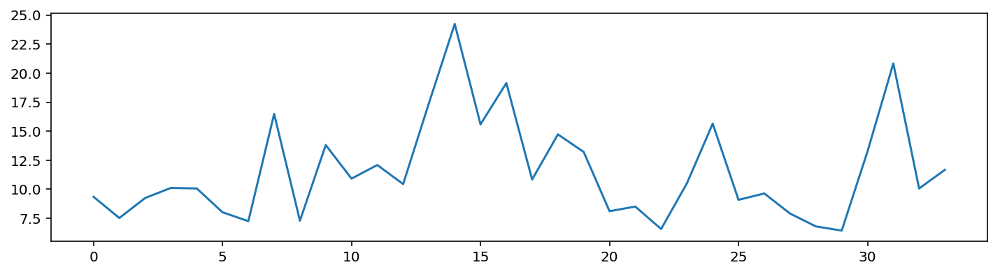

	 	 Test subset results
Test mean absolute percentage error per hour: 2.758384
Test mean absolute percentage error per day: 9.000974 
	 	 Validation Forecasting visualisation


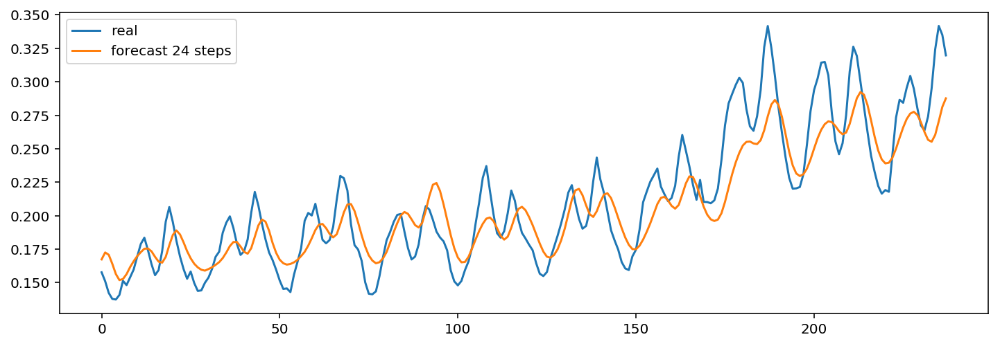

	 	 Forecasting a sample from Learning dataset


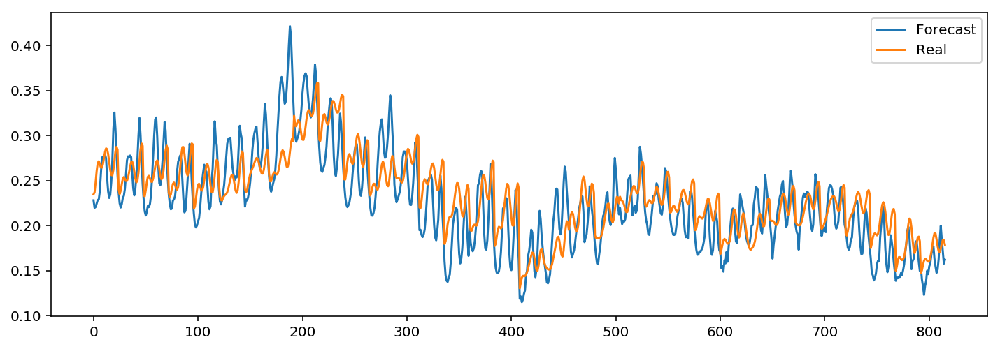

In [99]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 4
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 60
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 28
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 3.1150663908 
Daily Learning mean absolute percentage error of 34 days : 12.2590552639 
	 	 MAPError plot through Learning DataSet 


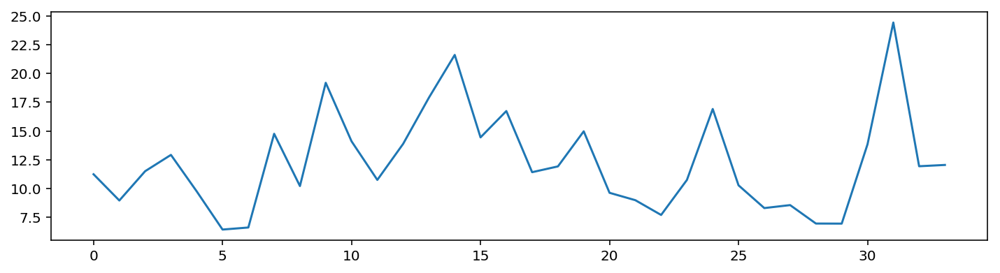

	 	 Test subset results
Test mean absolute percentage error per hour: 2.834716
Test mean absolute percentage error per day: 9.231191 
	 	 Validation Forecasting visualisation


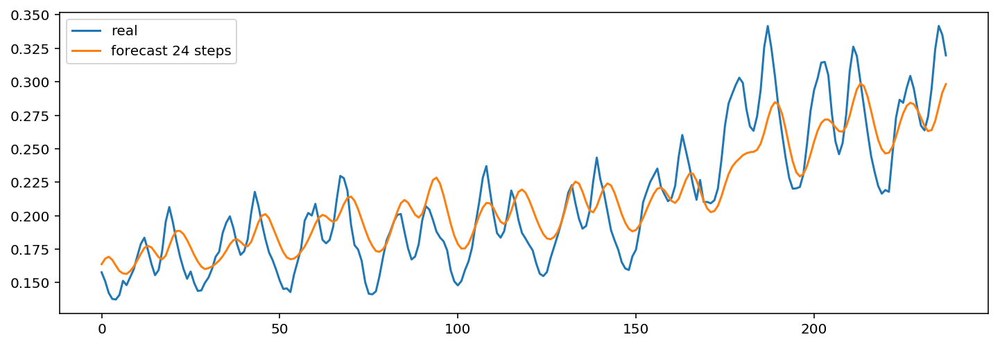

	 	 Forecasting a sample from Learning dataset


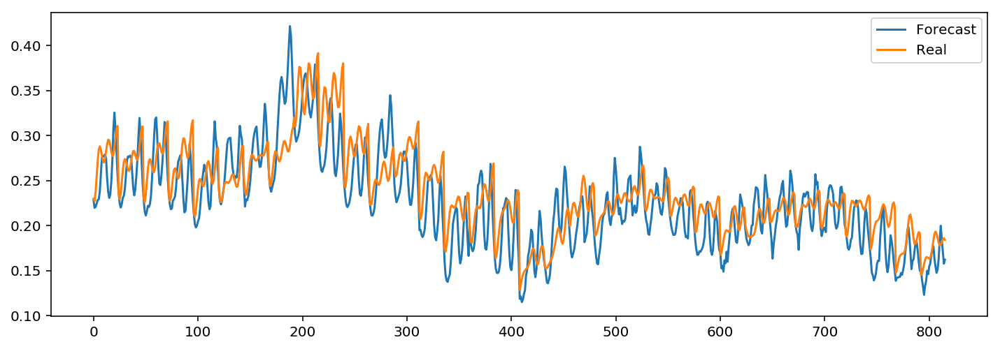

In [100]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 60
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 29
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 3.08941840088 
Daily Learning mean absolute percentage error of 34 days : 12.2540958769 
	 	 MAPError plot through Learning DataSet 


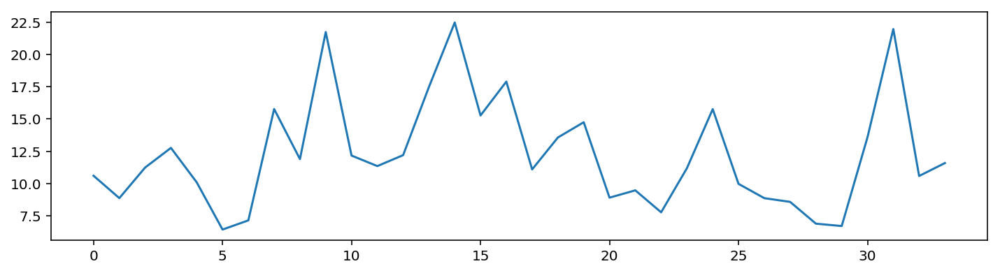

	 	 Test subset results
Test mean absolute percentage error per hour: 2.852690
Test mean absolute percentage error per day: 8.879886 
	 	 Validation Forecasting visualisation


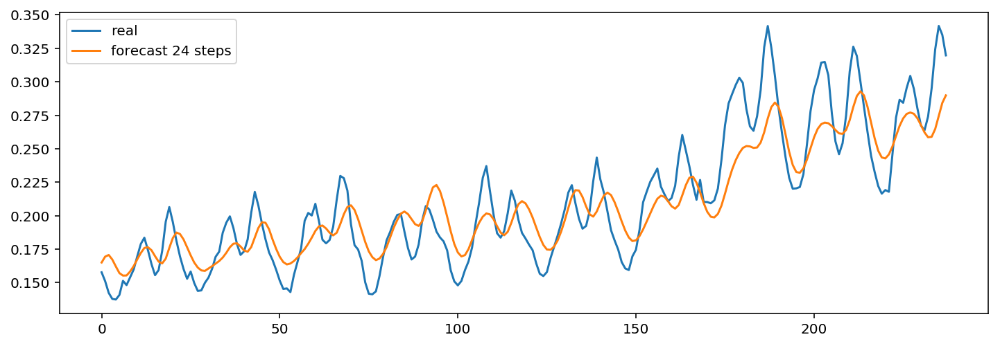

	 	 Forecasting a sample from Learning dataset


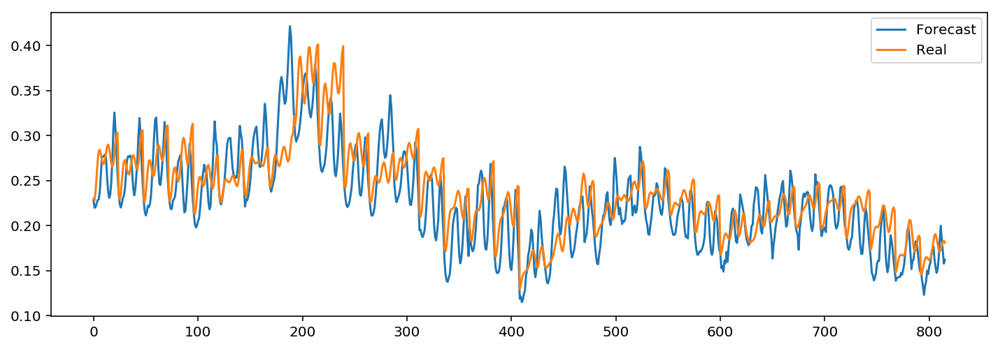

In [101]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 7
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 60
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 30
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 3.18600644824 
Daily Learning mean absolute percentage error of 34 days : 13.0680542132 
	 	 MAPError plot through Learning DataSet 


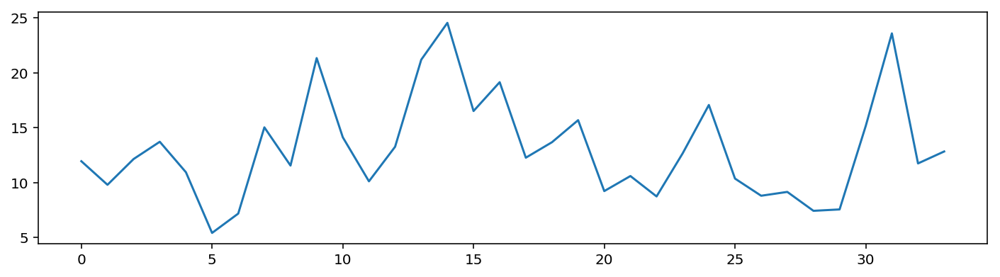

	 	 Test subset results
Test mean absolute percentage error per hour: 2.895159
Test mean absolute percentage error per day: 8.780849 
	 	 Validation Forecasting visualisation


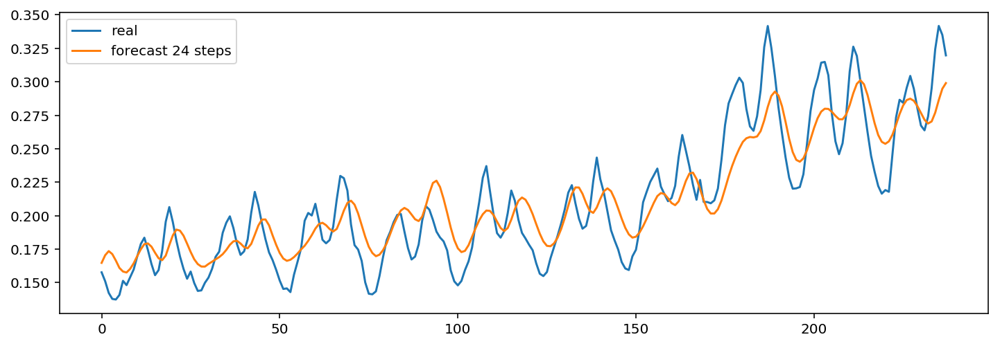

	 	 Forecasting a sample from Learning dataset


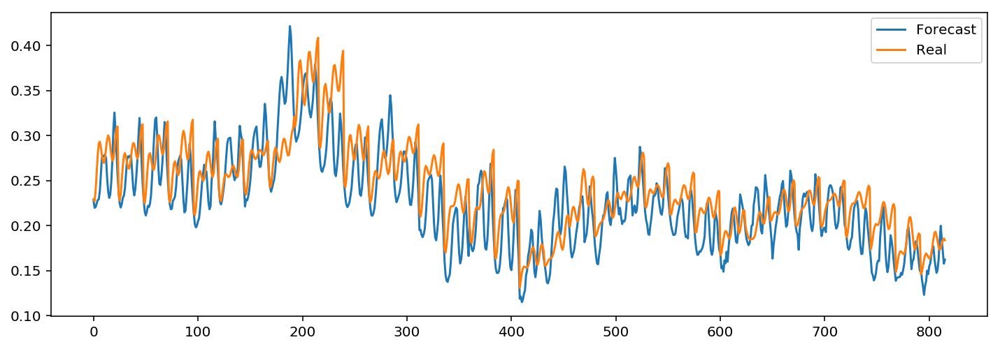

In [102]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 8
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 60
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 31
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 3.0758415383 
Daily Learning mean absolute percentage error of 34 days : 11.2381089154 
	 	 MAPError plot through Learning DataSet 


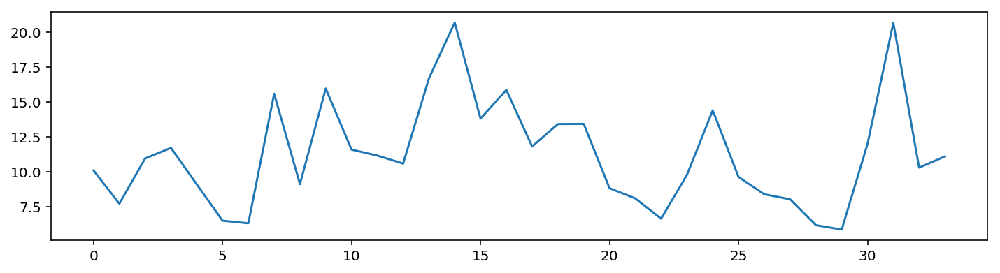

	 	 Test subset results
Test mean absolute percentage error per hour: 2.870221
Test mean absolute percentage error per day: 8.875258 
	 	 Validation Forecasting visualisation


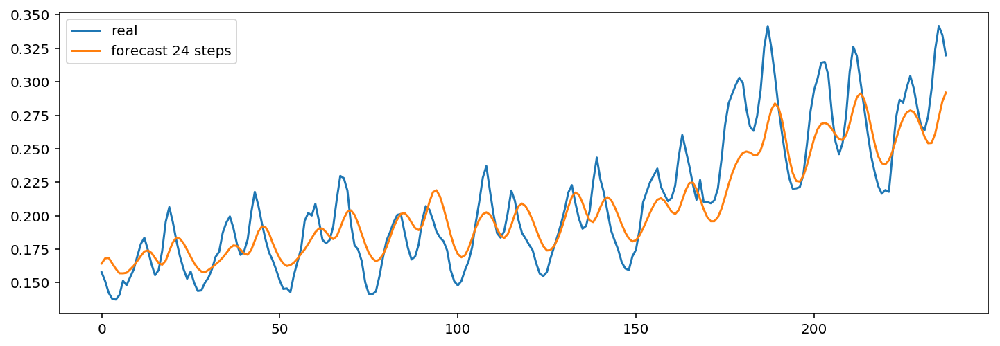

	 	 Forecasting a sample from Learning dataset


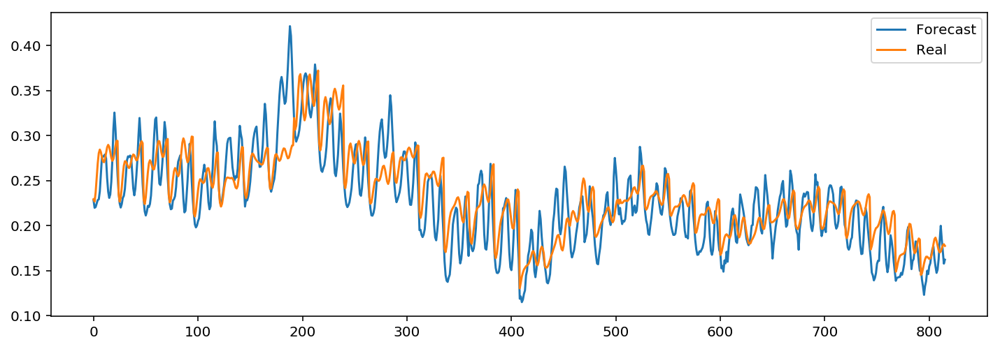

In [103]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 9
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 60
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 32
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 3.09225889254 
Daily Learning mean absolute percentage error of 34 days : 11.7852999323 
	 	 MAPError plot through Learning DataSet 


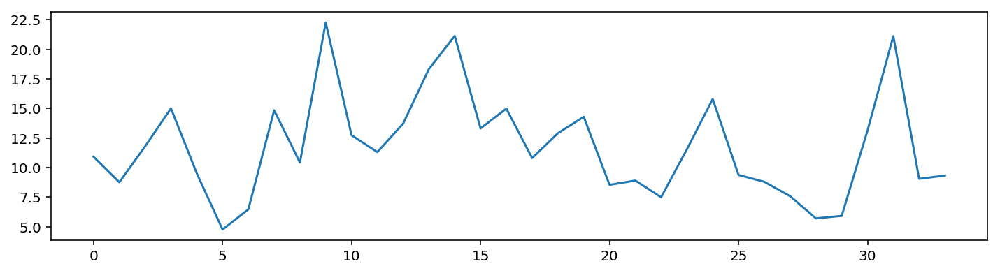

	 	 Test subset results
Test mean absolute percentage error per hour: 2.869489
Test mean absolute percentage error per day: 9.104007 
	 	 Validation Forecasting visualisation


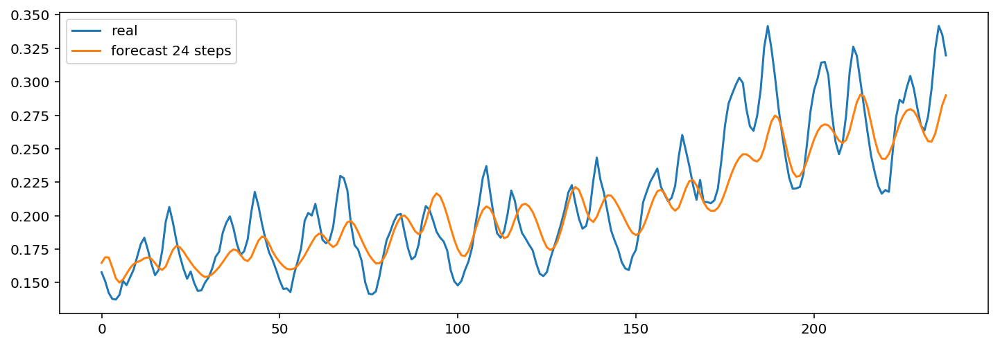

	 	 Forecasting a sample from Learning dataset


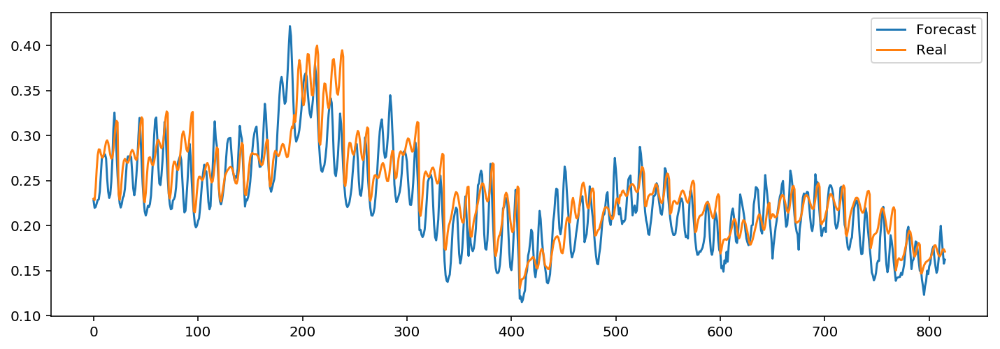

In [104]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 10
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 60
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 33
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 3.04256704689 
Daily Learning mean absolute percentage error of 34 days : 10.6154069901 
	 	 MAPError plot through Learning DataSet 


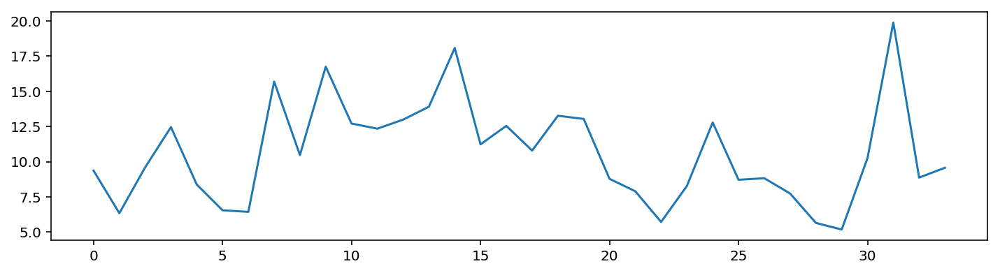

	 	 Test subset results
Test mean absolute percentage error per hour: 2.962316
Test mean absolute percentage error per day: 10.316031 
	 	 Validation Forecasting visualisation


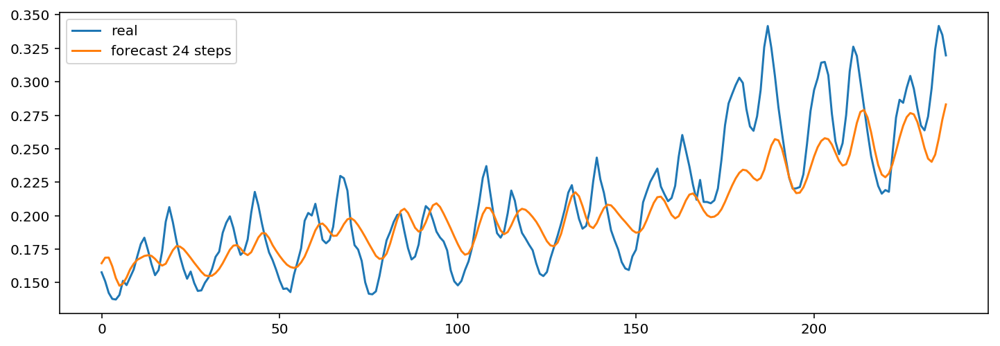

	 	 Forecasting a sample from Learning dataset


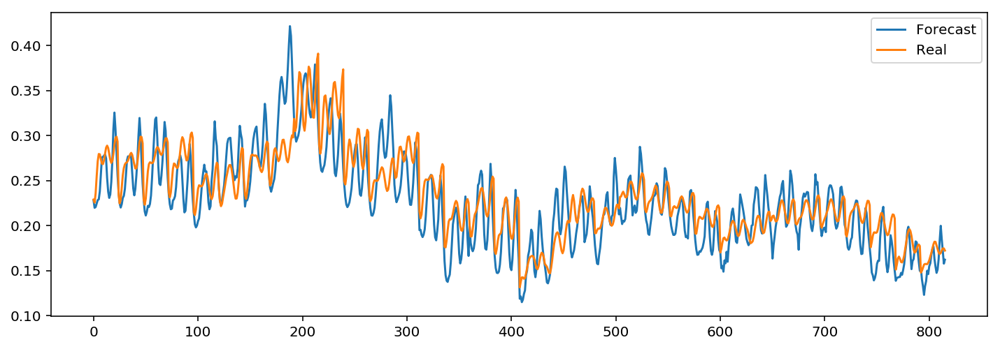

In [105]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 11
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 60
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 34
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 3.03528537741 
Daily Learning mean absolute percentage error of 34 days : 10.7772943553 
	 	 MAPError plot through Learning DataSet 


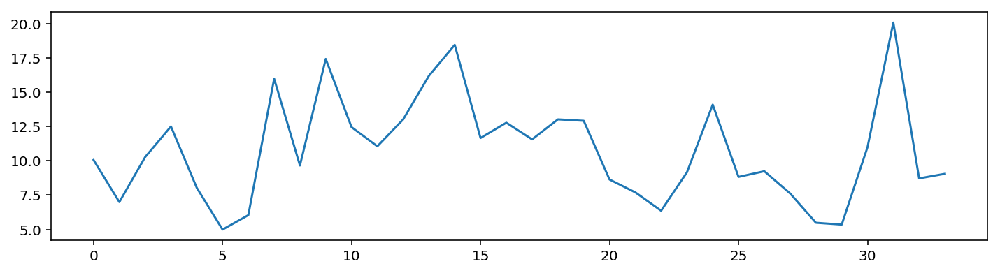

	 	 Test subset results
Test mean absolute percentage error per hour: 2.916895
Test mean absolute percentage error per day: 9.421481 
	 	 Validation Forecasting visualisation


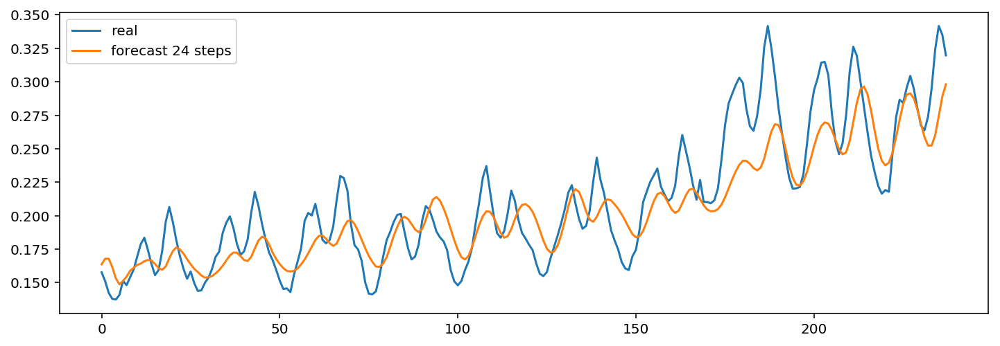

	 	 Forecasting a sample from Learning dataset


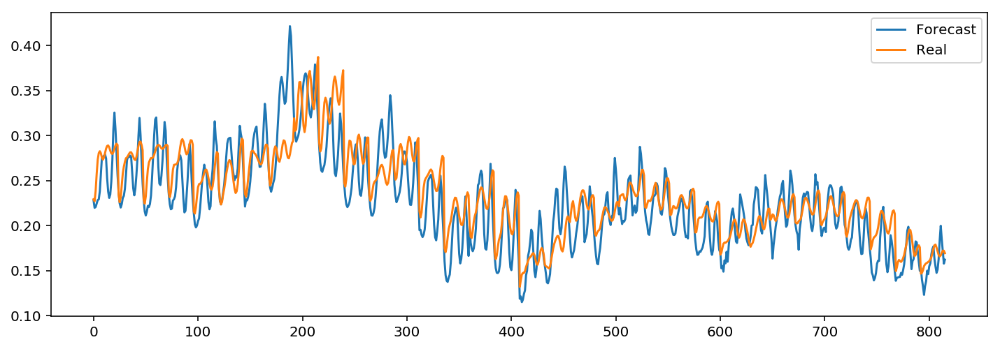

In [106]:
UsedInputsTemp= np.empty([9])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 60
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

In [107]:
UsedInputs = np.array(UsedInputList)

FinalError= np.array(MAPErrorList)

summary = pd.DataFrame(np.concatenate((Models_IDs,Models_parameters,UsedInputs,FinalError),axis=1),columns=
                       ['Model ID','Neurons L1','Neurons L2','Learning rate','Epochs','Previous hour','Time steps','Previous day'
                        ,'Previous week','Temperature','Temp Max','Temp Min','Day indicator','Hour indicator','Training MAPE %',
                        'Test MAPE %'])

summary

,Model ID,Neurons L1,Neurons L2,Learning rate,Epochs,Previous hour,Time steps,Previous day,Previous week,Temperature,Temp Max,Temp Min,Day indicator,Hour indicator,Training MAPE %,Test MAPE %
0,0.0,20.0,10.0,0.001,2937.0,1.0,24.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.176004,9.782279
1,1.0,20.0,10.0,0.001,2758.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.092731,7.215358
2,2.0,20.0,10.0,0.001,2784.0,1.0,6.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.865218,6.218849
3,3.0,20.0,10.0,0.001,2879.0,1.0,3.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,4.313468,6.882719
4,4.0,20.0,10.0,0.001,2159.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.127202,6.218849
5,5.0,60.0,30.0,0.001,361.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,3.114372,6.239569
6,6.0,50.0,10.0,0.001,1037.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.884617,7.017811
7,7.0,80.0,50.0,0.001,751.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.961713,7.097808
8,8.0,90.0,30.0,0.002,722.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,4.112521,5.774046
9,9.0,90.0,30.0,0.002,547.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,5.676290,6.496742


	 	 test num : 36
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 7.01332705614 
Daily Learning mean absolute percentage error of 34 days : 8.92634370047 
	 	 MAPError plot through Learning DataSet 


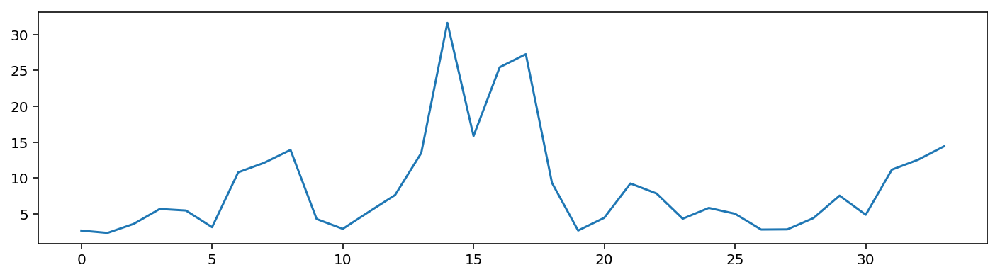

	 	 Test subset results
Test mean absolute percentage error per hour: 9.606794
Test mean absolute percentage error per day: 11.719683 
	 	 Validation Forecasting visualisation


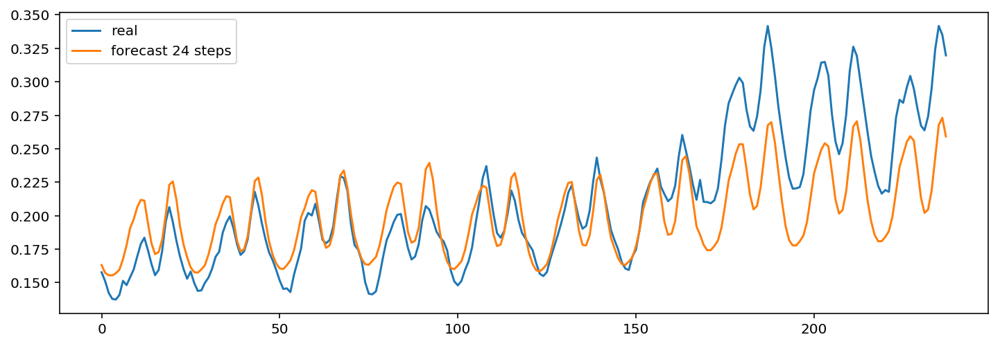

	 	 Forecasting a sample from Learning dataset


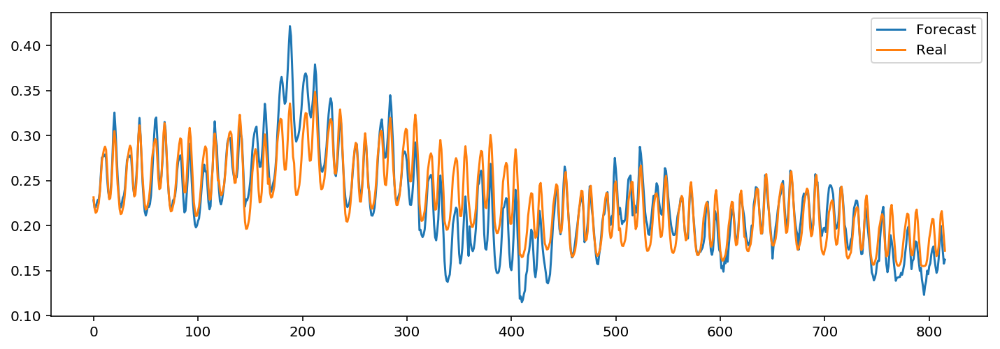

In [120]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 1
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 60
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 37
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 3.5907823914 
Daily Learning mean absolute percentage error of 34 days : 11.4537399026 
	 	 MAPError plot through Learning DataSet 


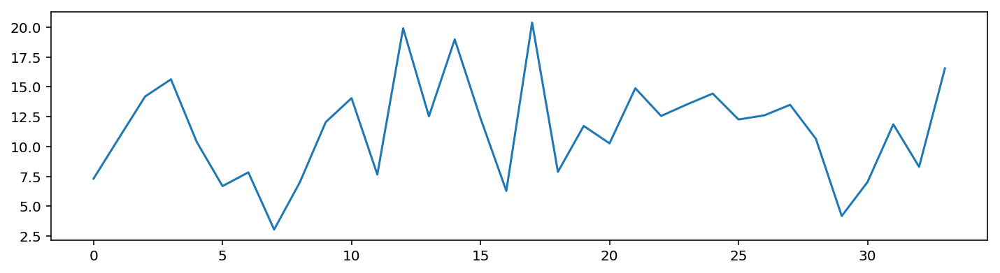

	 	 Test subset results
Test mean absolute percentage error per hour: 3.181613
Test mean absolute percentage error per day: 5.416210 
	 	 Validation Forecasting visualisation


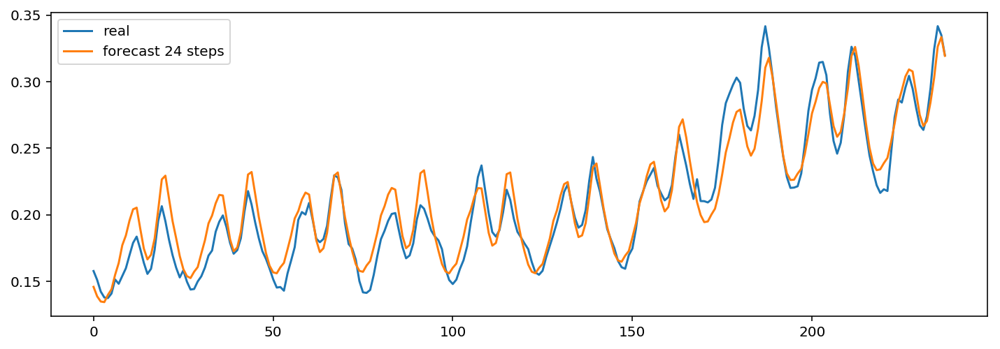

	 	 Forecasting a sample from Learning dataset


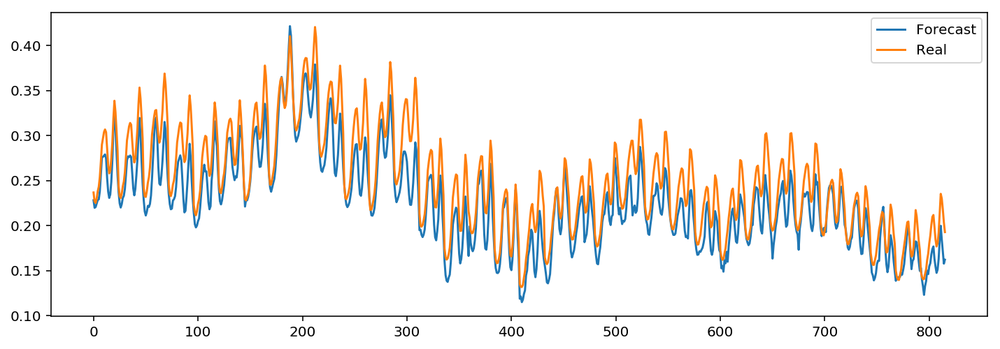

In [121]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 60
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 38
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.91439904109 
Daily Learning mean absolute percentage error of 34 days : 4.84246332856 
	 	 MAPError plot through Learning DataSet 


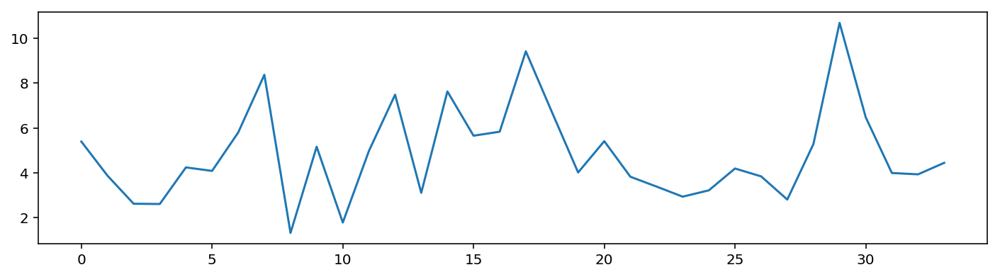

	 	 Test subset results
Test mean absolute percentage error per hour: 2.043676
Test mean absolute percentage error per day: 5.258615 
	 	 Validation Forecasting visualisation


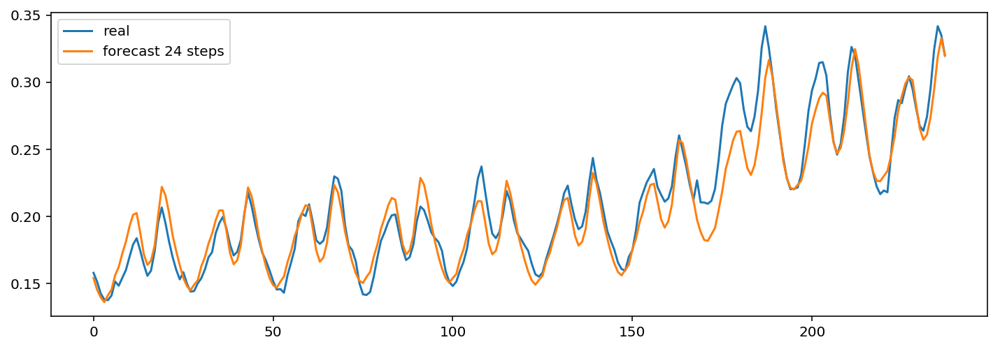

	 	 Forecasting a sample from Learning dataset


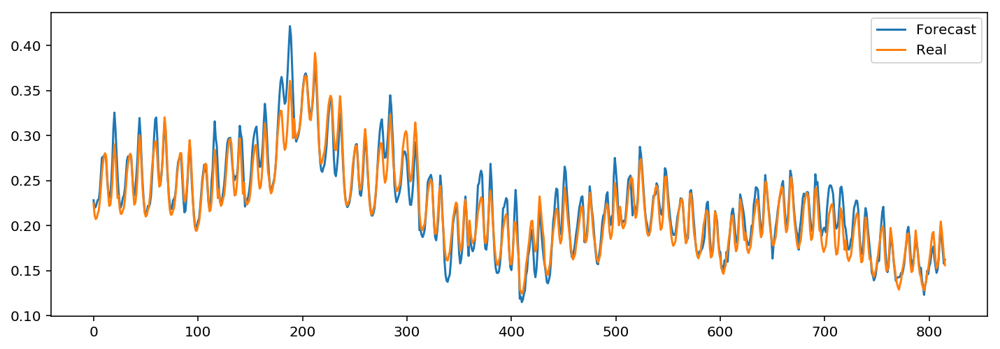

In [122]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 1
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 60
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 40
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 4.26745191282 
Daily Learning mean absolute percentage error of 34 days : 12.0589152645 
	 	 MAPError plot through Learning DataSet 


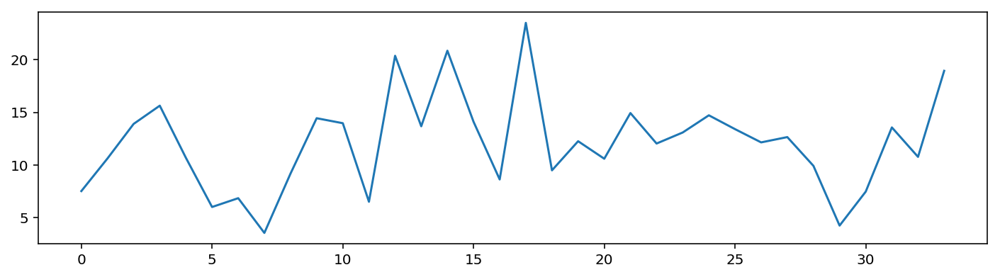

	 	 Test subset results
Test mean absolute percentage error per hour: 3.573256
Test mean absolute percentage error per day: 9.109560 
	 	 Validation Forecasting visualisation


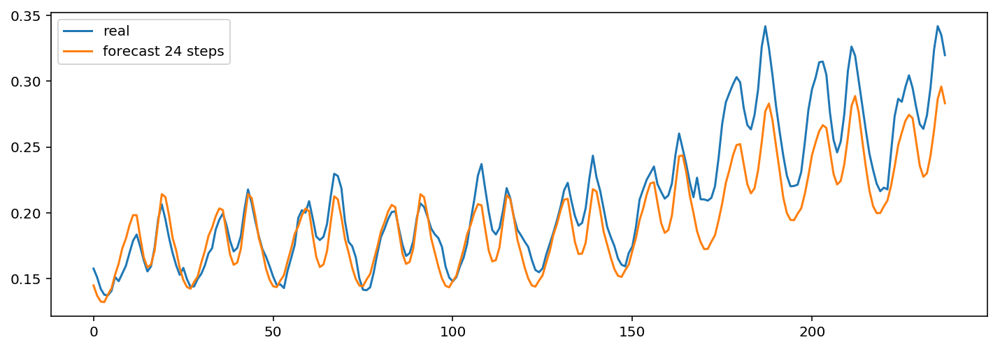

	 	 Forecasting a sample from Learning dataset


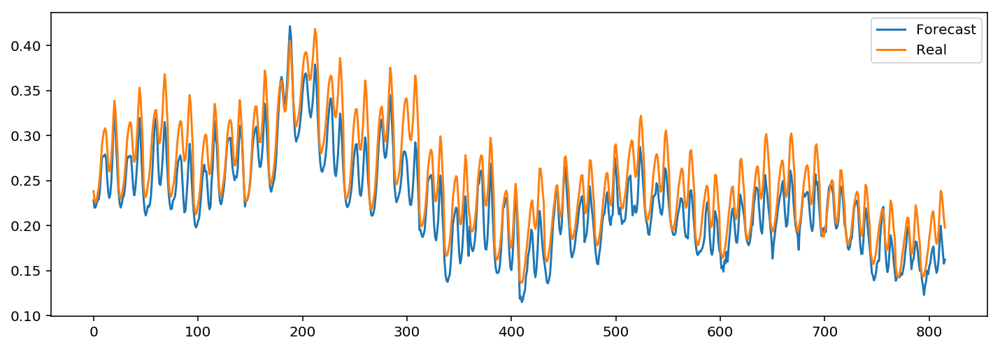

In [124]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 160
Parameters[1]= HiddenNeurons2 = 70
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 41
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 4.28439135716 
Daily Learning mean absolute percentage error of 34 days : 9.33468914032 
	 	 MAPError plot through Learning DataSet 


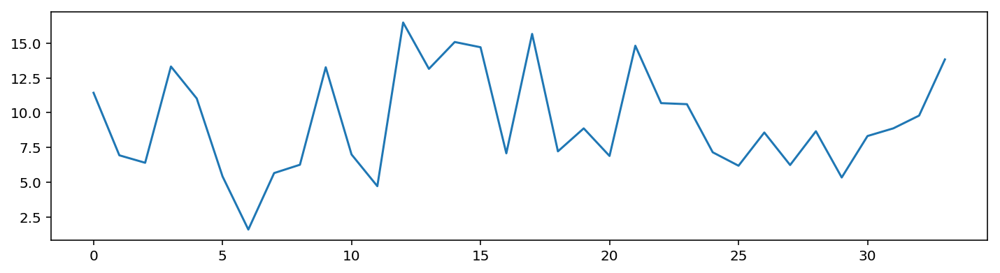

	 	 Test subset results
Test mean absolute percentage error per hour: 4.307051
Test mean absolute percentage error per day: 9.004047 
	 	 Validation Forecasting visualisation


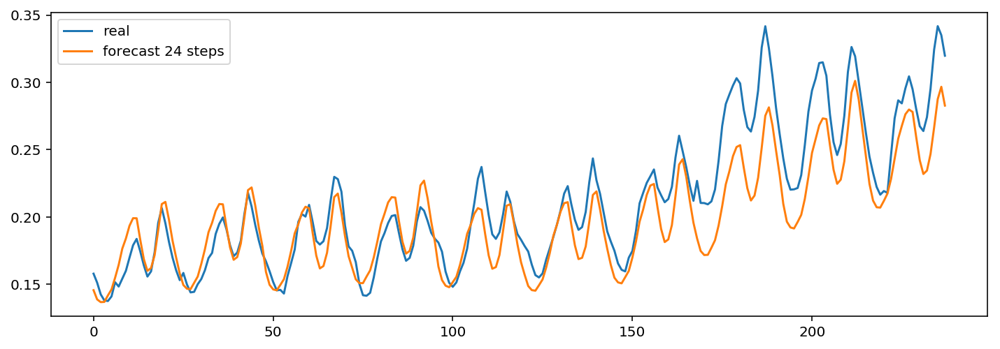

	 	 Forecasting a sample from Learning dataset


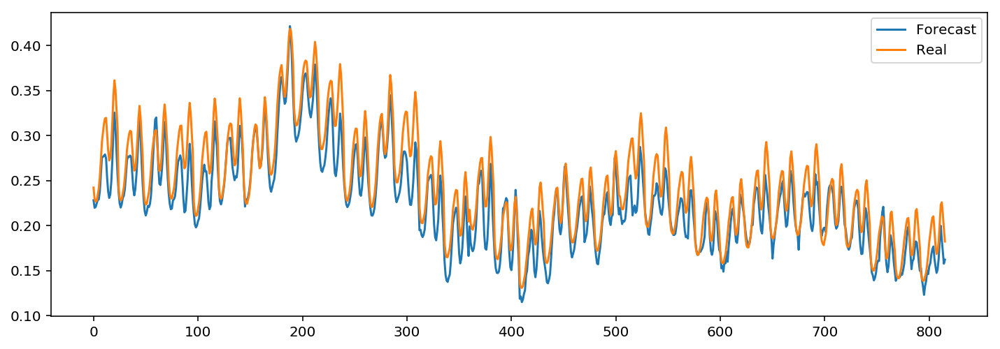

In [125]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 160
Parameters[1]= HiddenNeurons2 = 70
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 42
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.0922038699 
Daily Learning mean absolute percentage error of 34 days : 2.23291178442 
	 	 MAPError plot through Learning DataSet 


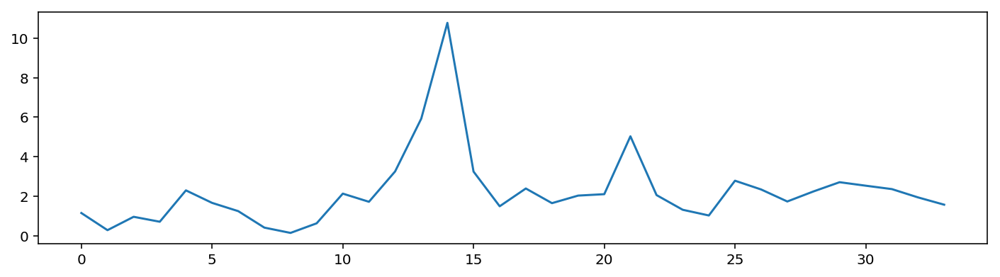

	 	 Test subset results
Test mean absolute percentage error per hour: 3.051469
Test mean absolute percentage error per day: 6.074610 
	 	 Validation Forecasting visualisation


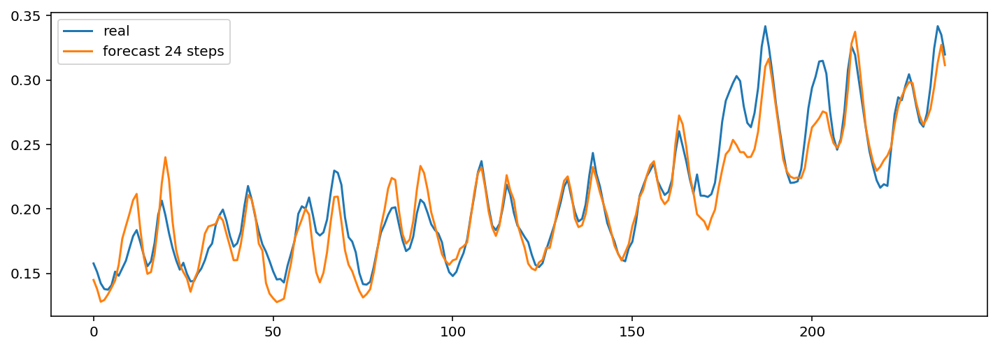

	 	 Forecasting a sample from Learning dataset


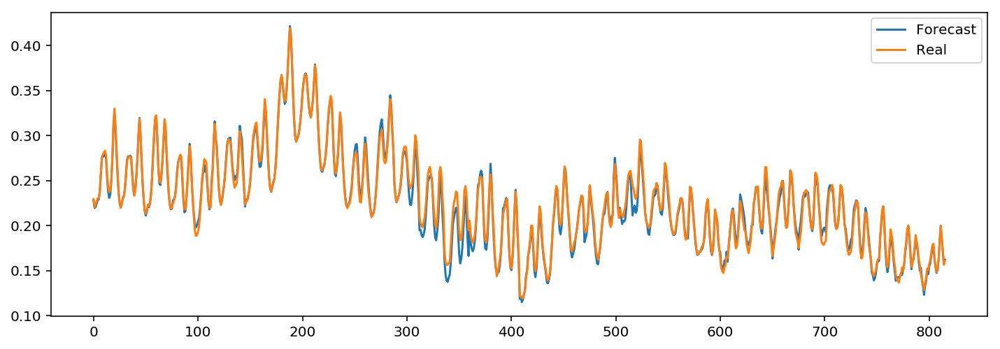

In [126]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 160
Parameters[1]= HiddenNeurons2 = 70
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Nadam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 43
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.89578328009 
Daily Learning mean absolute percentage error of 34 days : 4.34789710886 
	 	 MAPError plot through Learning DataSet 


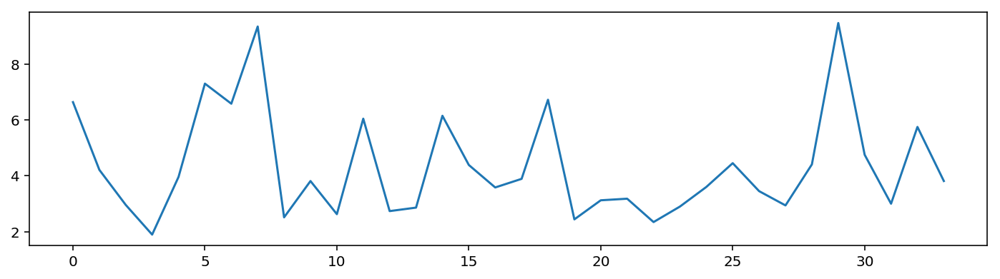

	 	 Test subset results
Test mean absolute percentage error per hour: 2.321886
Test mean absolute percentage error per day: 5.449147 
	 	 Validation Forecasting visualisation


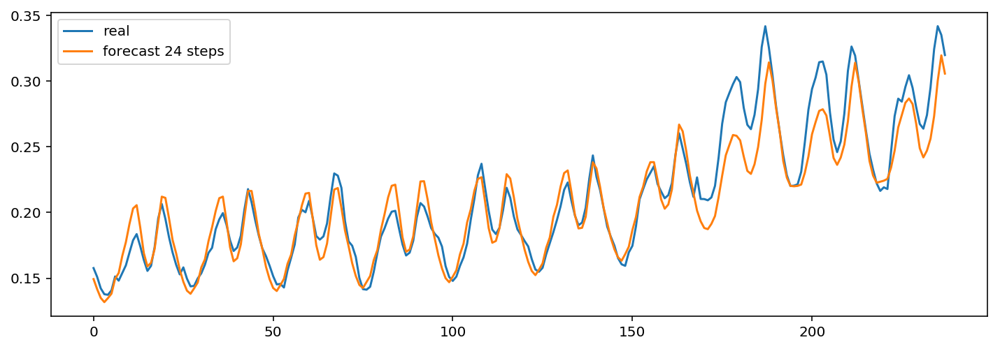

	 	 Forecasting a sample from Learning dataset


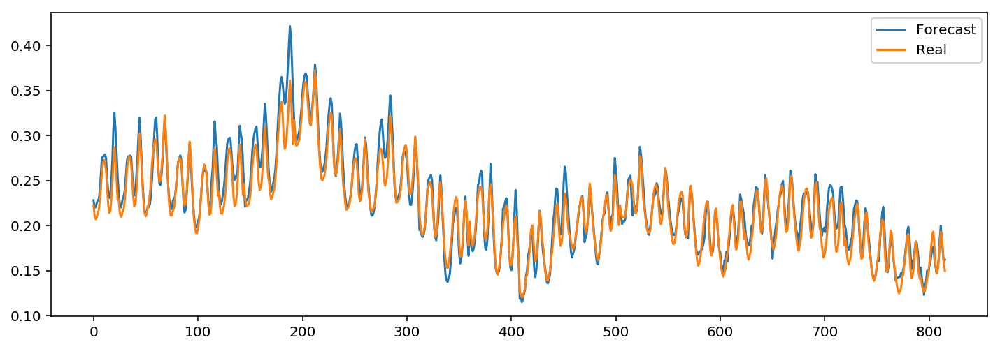

In [127]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 160
Parameters[1]= HiddenNeurons2 = 70
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 44
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 2.55897140743 
Daily Learning mean absolute percentage error of 34 days : 5.13067105588 
	 	 MAPError plot through Learning DataSet 


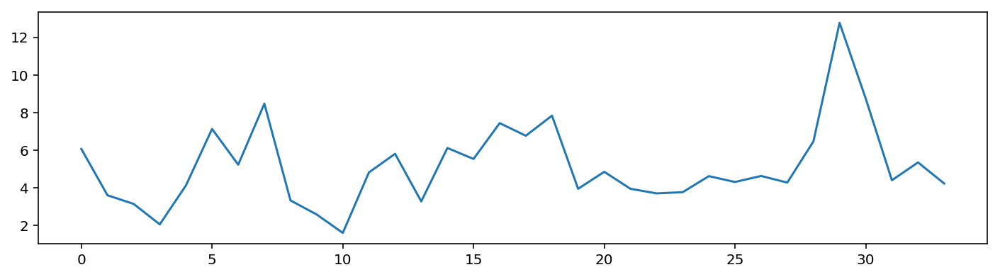

	 	 Test subset results
Test mean absolute percentage error per hour: 2.796006
Test mean absolute percentage error per day: 5.557303 
	 	 Validation Forecasting visualisation


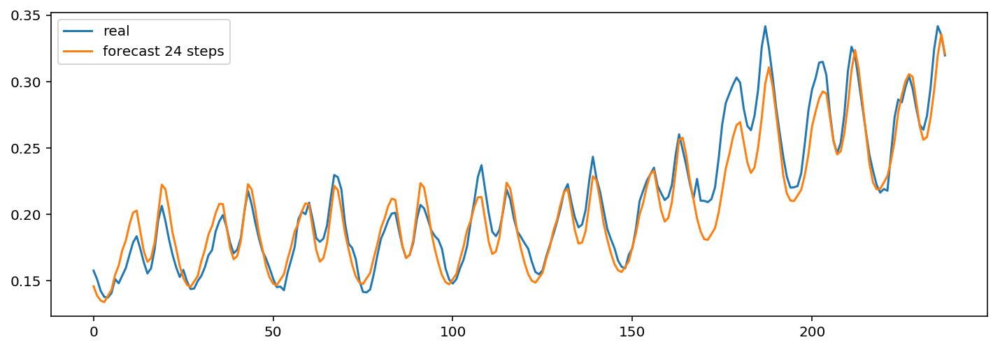

	 	 Forecasting a sample from Learning dataset


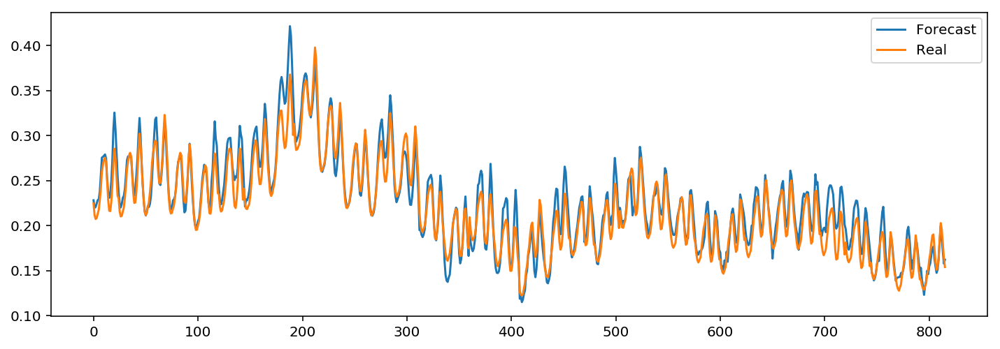

In [128]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 45
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 2.22535089252 
Daily Learning mean absolute percentage error of 34 days : 5.05880094276 
	 	 MAPError plot through Learning DataSet 


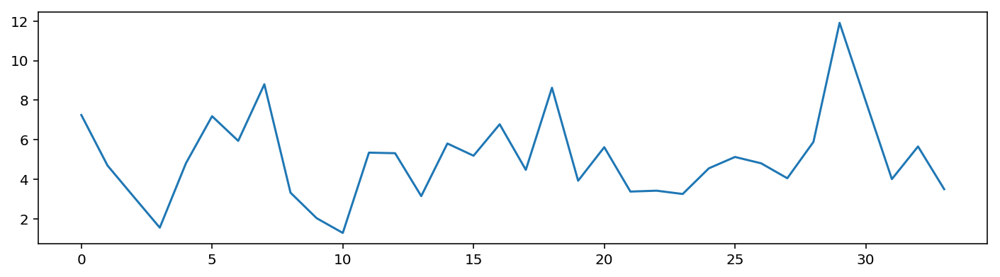

	 	 Test subset results
Test mean absolute percentage error per hour: 2.423614
Test mean absolute percentage error per day: 6.344839 
	 	 Validation Forecasting visualisation


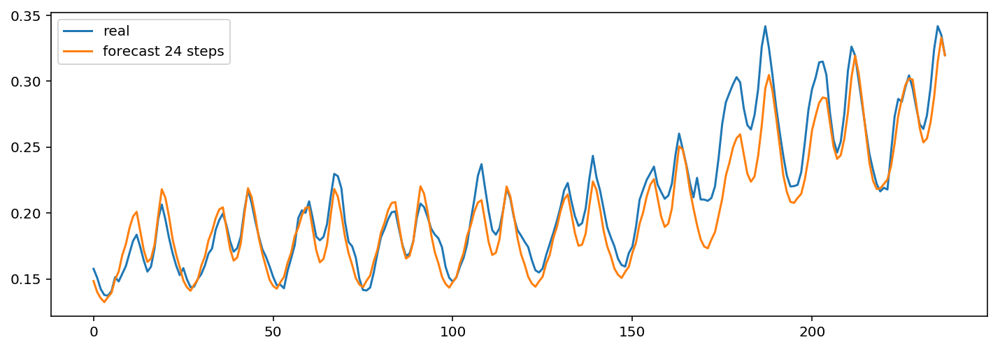

	 	 Forecasting a sample from Learning dataset


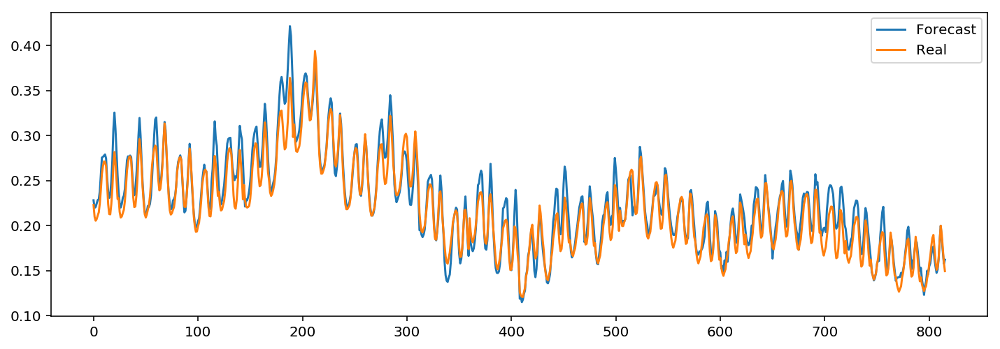

In [129]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 60
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

In [170]:
UsedInputs = np.array(UsedInputList[-1:33])

FinalError = np.array(MAPErrorList[-1:33])

summary = pd.DataFrame(np.concatenate((Models_IDs[-1:33],Models_parameters[-1:33],UsedInputs,FinalError),axis=1),columns=
                       ['Model ID','Neurons L1','Neurons L2','Learning rate','Epochs','Previous hour','Time steps','Previous day'
                        ,'Previous week','Temperature','Temp Max','Temp Min','Day indicator','Hour indicator','Training MAPE %',
                        'Test MAPE %'])

summary

AxisError: axis 1 is out of bounds for array of dimension 1

In [163]:
UsedInputs = np.array(UsedInputList[36:-1])

FinalError = np.array(MAPErrorList[36:-1])

summary = pd.DataFrame(np.concatenate((Models_IDs[36:-1],Models_parameters[36:-1],UsedInputs,FinalError),axis=1),columns=
                       ['Model ID','Neurons L1','Neurons L2','Learning rate','Epochs','Previous hour','Time steps','Previous day'
                        ,'Previous week','Temperature','Temp Max','Temp Min','Day indicator','Hour indicator','Month indicator','Training MAPE %',
                        'Test MAPE %'])

summary

,Model ID,Neurons L1,Neurons L2,Learning rate,Epochs,Previous hour,Time steps,Previous day,Previous week,Temperature,Temp Max,Temp Min,Day indicator,Hour indicator,Month indicator,Training MAPE %,Test MAPE %
0,36.0,60.0,30.0,0.02,71.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,8.926344,11.719683
1,37.0,60.0,30.0,0.02,349.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,11.453740,5.416210
2,38.0,60.0,30.0,0.02,983.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,4.842463,5.258615
3,39.0,160.0,70.0,0.02,52.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,10.922079,10.661437
4,40.0,160.0,70.0,0.02,226.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,12.058915,9.109560
5,41.0,160.0,70.0,0.02,100.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,9.334689,9.004047
6,42.0,160.0,70.0,0.02,887.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,2.232912,6.074610
7,43.0,160.0,70.0,0.02,962.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,4.347897,5.449147
8,44.0,20.0,10.0,0.02,982.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,5.130671,5.557303


In [164]:
Epoch= 3000

	 	 test num : 46
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.85026473511 
Daily Learning mean absolute percentage error of 34 days : 4.55343101656 
	 	 MAPError plot through Learning DataSet 


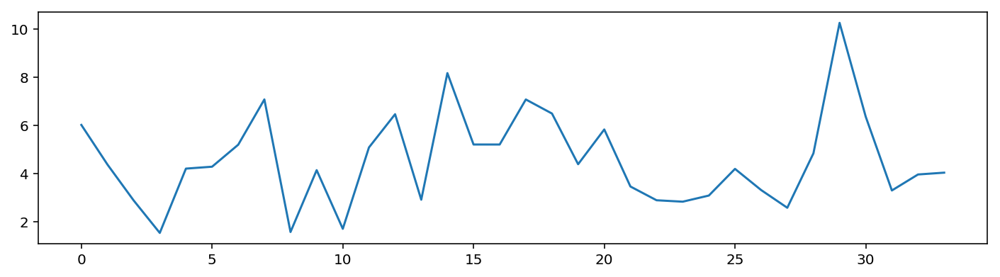

	 	 Test subset results
Test mean absolute percentage error per hour: 2.080197
Test mean absolute percentage error per day: 5.343729 
	 	 Validation Forecasting visualisation


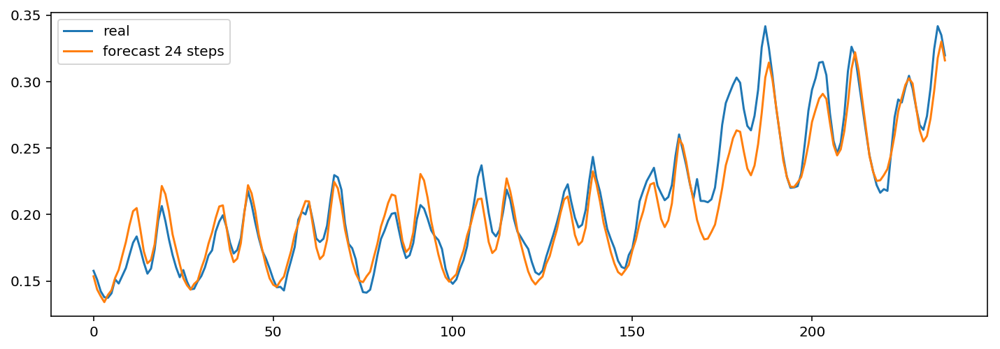

	 	 Forecasting a sample from Learning dataset


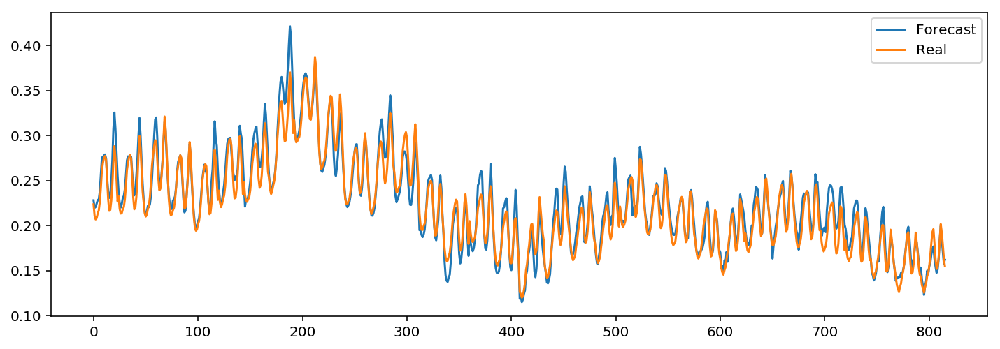

In [165]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 1
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 60
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 47
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.71059165983 
Daily Learning mean absolute percentage error of 34 days : 4.39945195002 
	 	 MAPError plot through Learning DataSet 


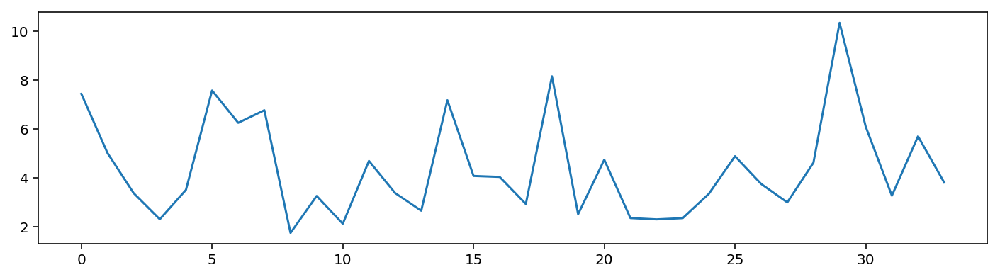

	 	 Test subset results
Test mean absolute percentage error per hour: 2.015772
Test mean absolute percentage error per day: 5.184045 
	 	 Validation Forecasting visualisation


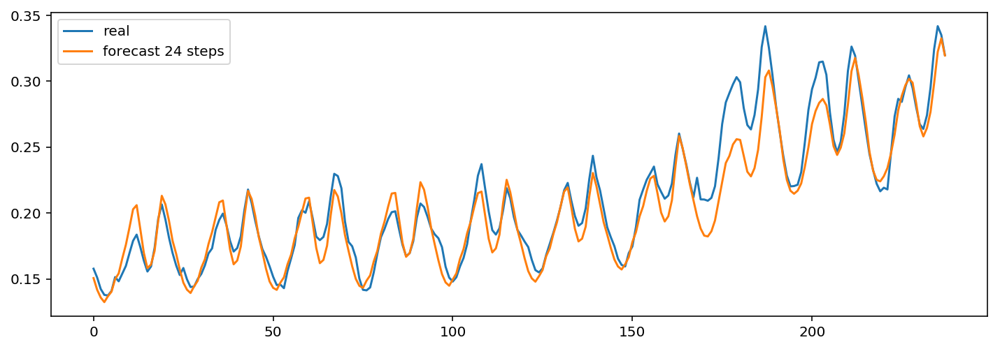

	 	 Forecasting a sample from Learning dataset


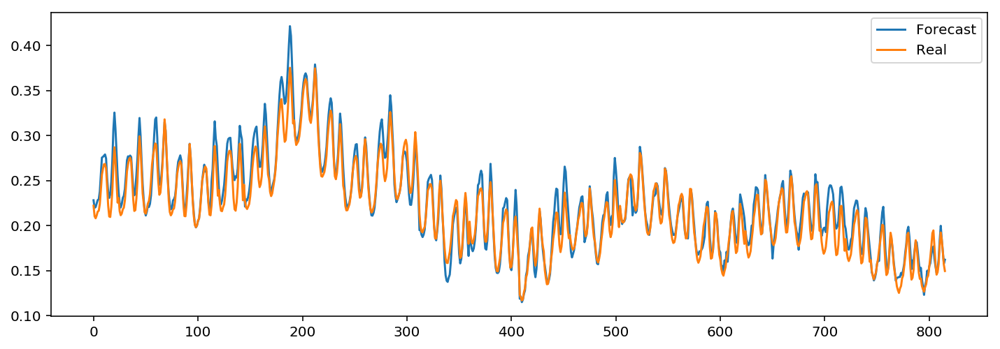

In [171]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 60
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 48
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.84391782583 
Daily Learning mean absolute percentage error of 34 days : 5.0275637823 
	 	 MAPError plot through Learning DataSet 


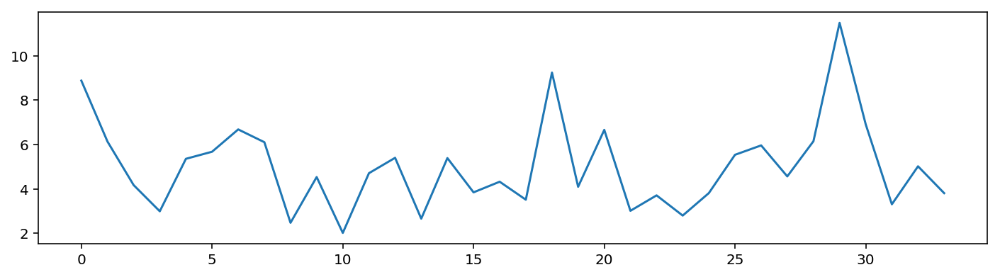

	 	 Test subset results
Test mean absolute percentage error per hour: 2.085136
Test mean absolute percentage error per day: 6.801247 
	 	 Validation Forecasting visualisation


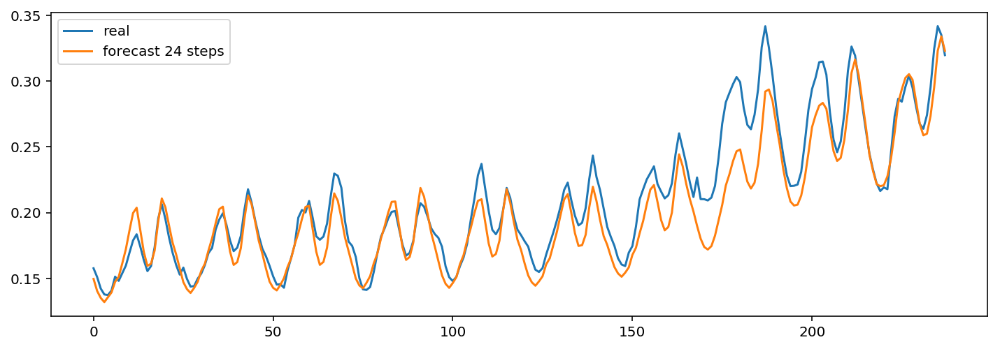

	 	 Forecasting a sample from Learning dataset


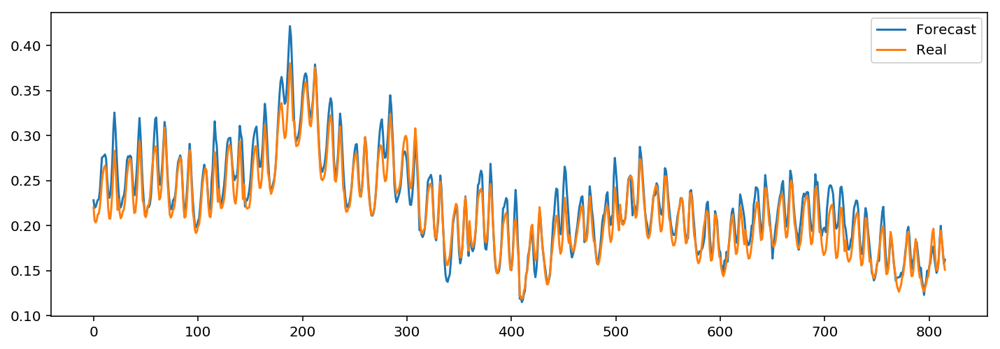

In [172]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 49
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.79827002265 
Daily Learning mean absolute percentage error of 34 days : 4.09678033871 
	 	 MAPError plot through Learning DataSet 


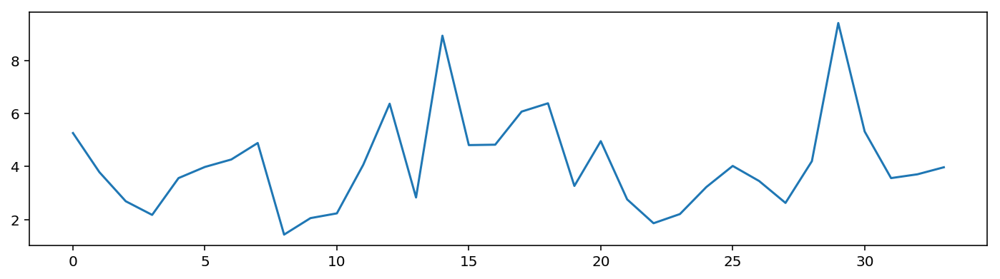

	 	 Test subset results
Test mean absolute percentage error per hour: 2.031328
Test mean absolute percentage error per day: 4.908844 
	 	 Validation Forecasting visualisation


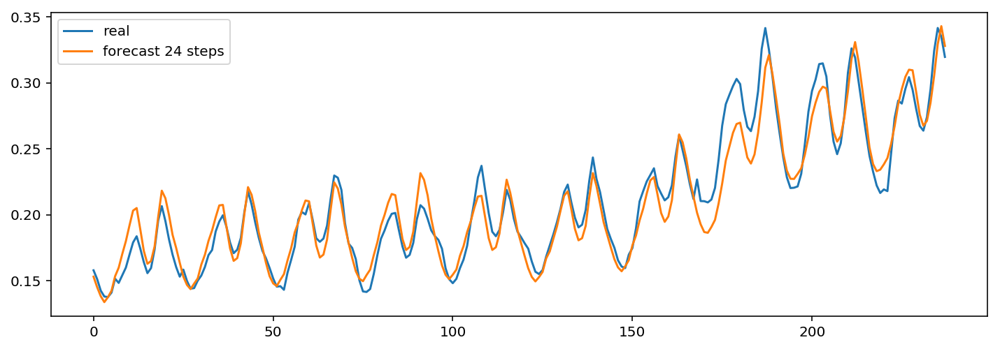

	 	 Forecasting a sample from Learning dataset


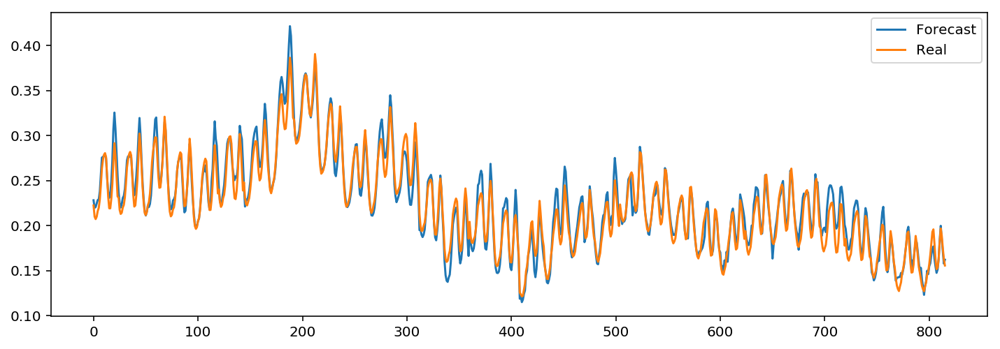

In [173]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 50
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.17908950536 
Daily Learning mean absolute percentage error of 34 days : 2.99016503902 
	 	 MAPError plot through Learning DataSet 


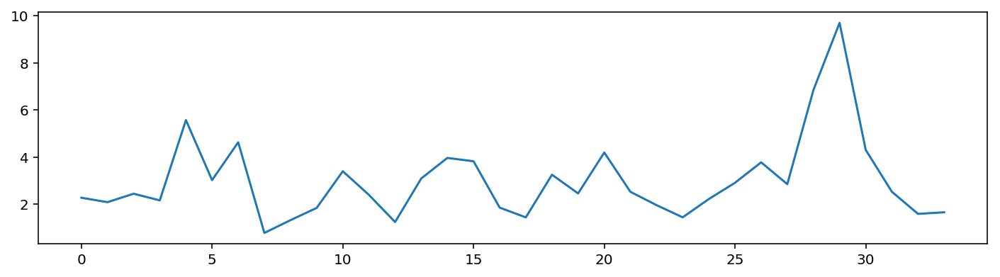

	 	 Test subset results
Test mean absolute percentage error per hour: 2.842633
Test mean absolute percentage error per day: 8.982801 
	 	 Validation Forecasting visualisation


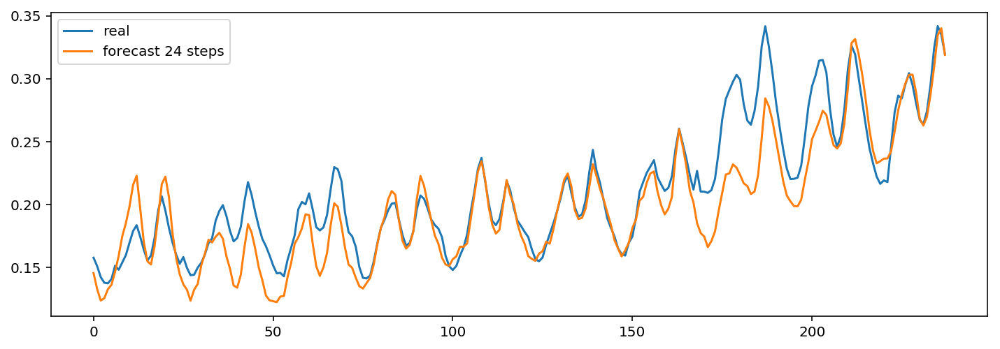

	 	 Forecasting a sample from Learning dataset


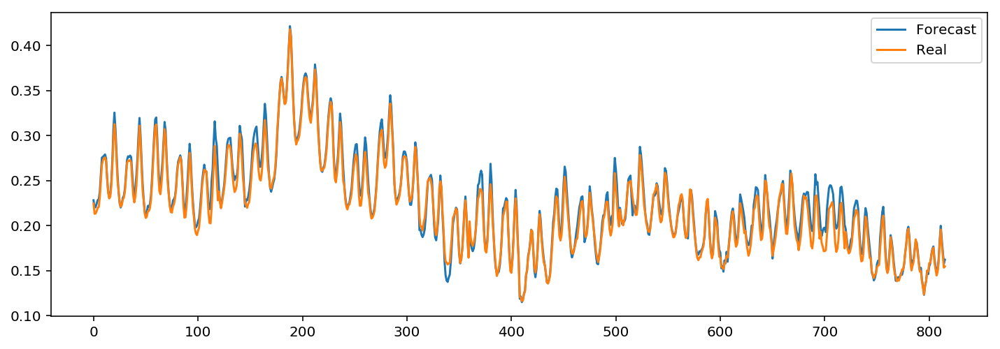

In [174]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 51
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.63433061911 
Daily Learning mean absolute percentage error of 34 days : 3.93703450526 
	 	 MAPError plot through Learning DataSet 


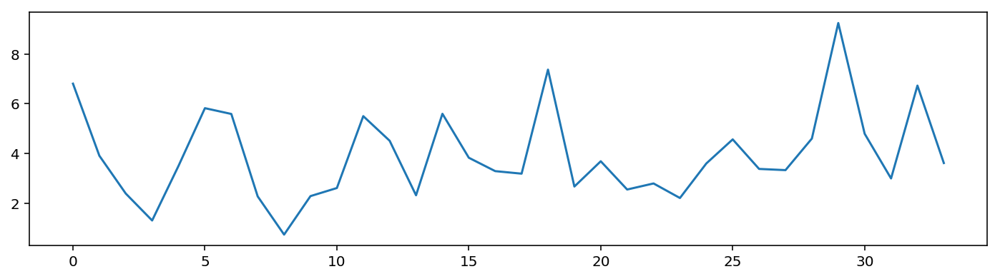

	 	 Test subset results
Test mean absolute percentage error per hour: 2.143745
Test mean absolute percentage error per day: 5.738447 
	 	 Validation Forecasting visualisation


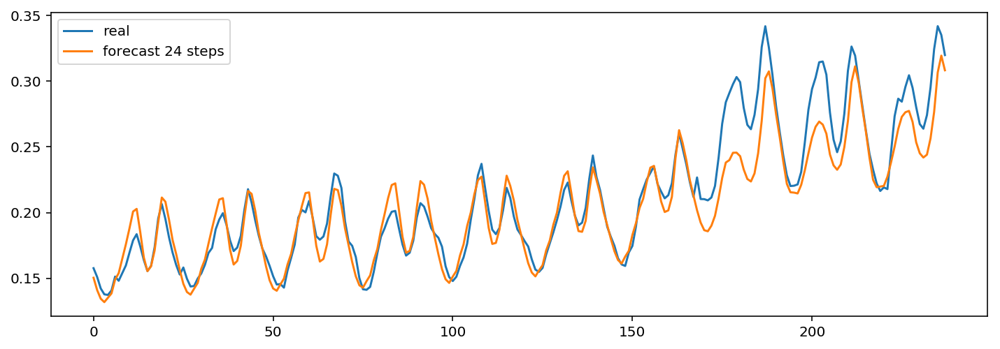

	 	 Forecasting a sample from Learning dataset


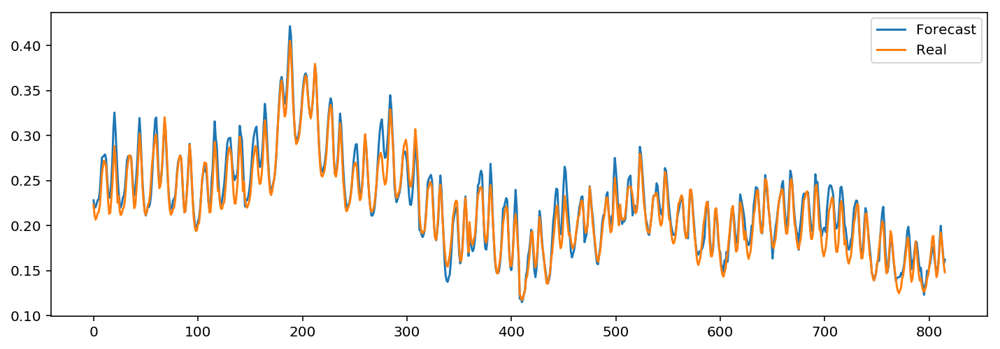

In [175]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 52
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.05564785732 
Daily Learning mean absolute percentage error of 34 days : 2.3758184717 
	 	 MAPError plot through Learning DataSet 


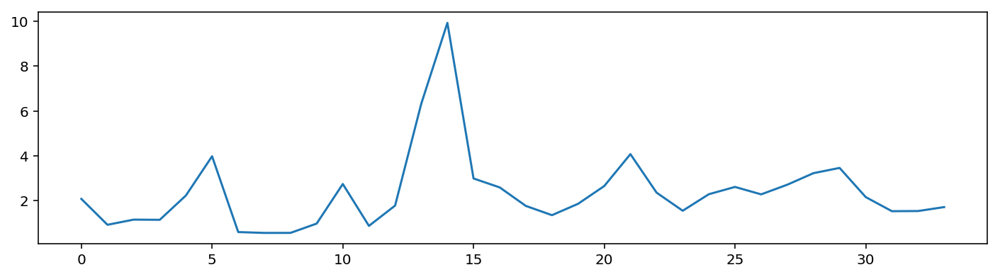

	 	 Test subset results
Test mean absolute percentage error per hour: 3.042856
Test mean absolute percentage error per day: 7.956091 
	 	 Validation Forecasting visualisation


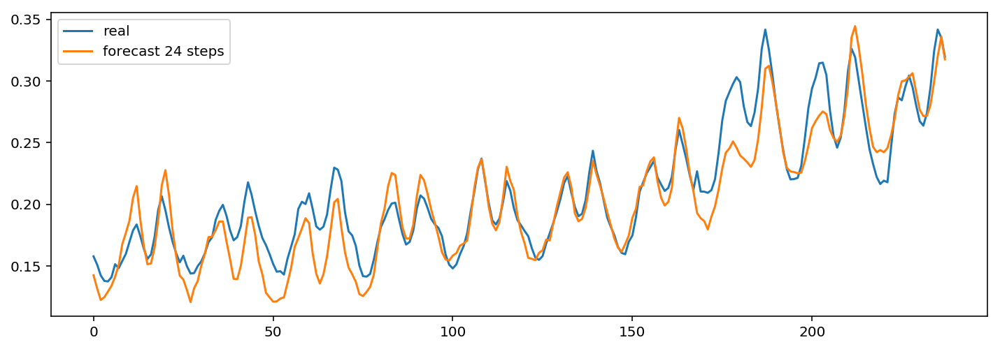

	 	 Forecasting a sample from Learning dataset


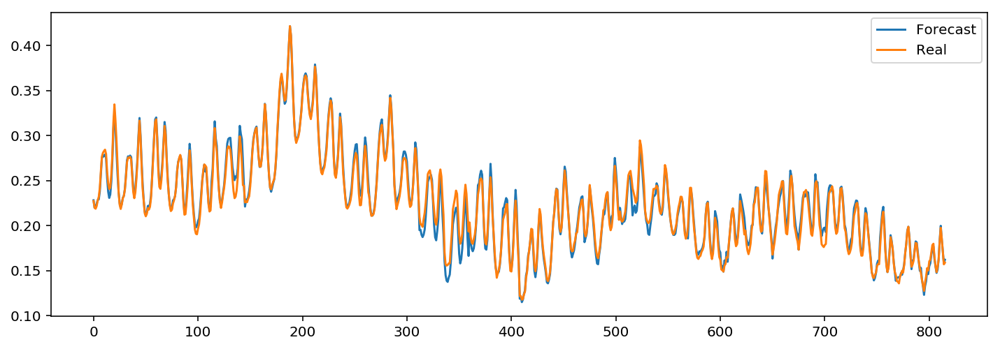

In [176]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 53
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.875859807 
Daily Learning mean absolute percentage error of 34 days : 4.87180497366 
	 	 MAPError plot through Learning DataSet 


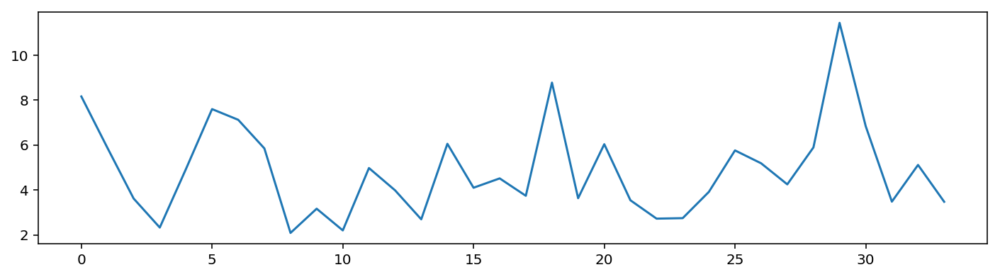

	 	 Test subset results
Test mean absolute percentage error per hour: 2.092079
Test mean absolute percentage error per day: 6.545614 
	 	 Validation Forecasting visualisation


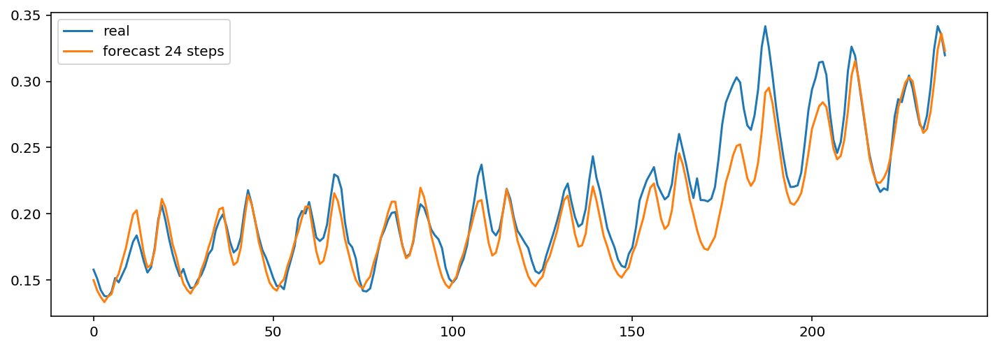

	 	 Forecasting a sample from Learning dataset


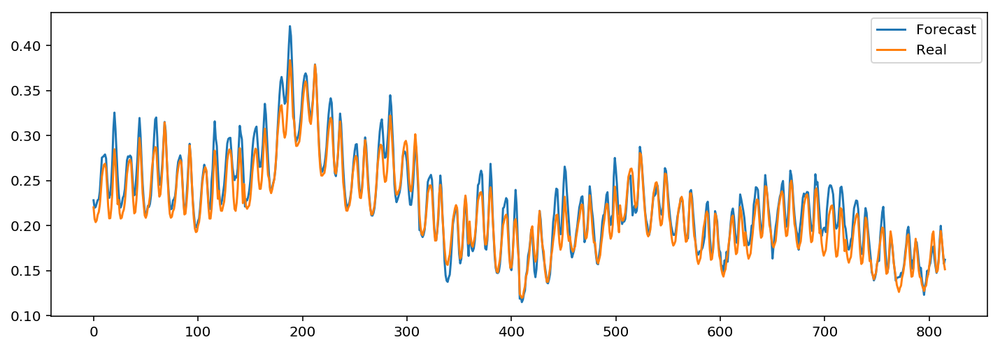

In [178]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 54
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.60397931736 
Daily Learning mean absolute percentage error of 34 days : 3.53597207981 
	 	 MAPError plot through Learning DataSet 


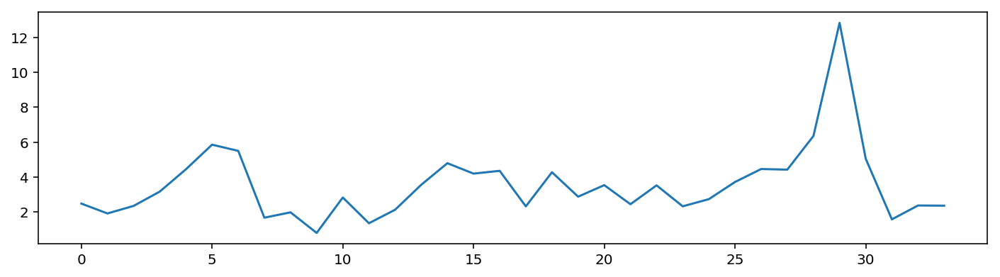

	 	 Test subset results
Test mean absolute percentage error per hour: 2.603628
Test mean absolute percentage error per day: 7.280387 
	 	 Validation Forecasting visualisation


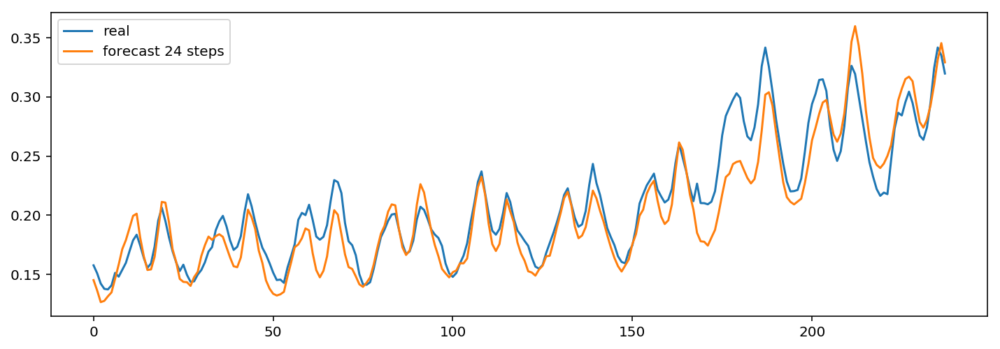

	 	 Forecasting a sample from Learning dataset


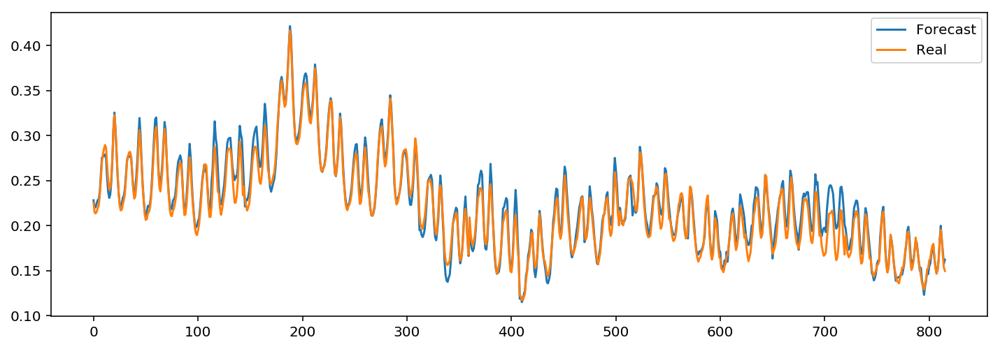

In [179]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='RMSprop')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 56
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 3.75789895421 
Daily Learning mean absolute percentage error of 34 days : 5.22035975316 
	 	 MAPError plot through Learning DataSet 


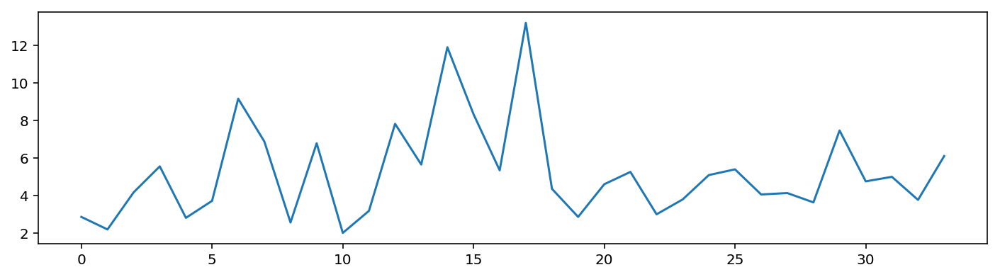

	 	 Test subset results
Test mean absolute percentage error per hour: 4.291844
Test mean absolute percentage error per day: 6.450689 
	 	 Validation Forecasting visualisation


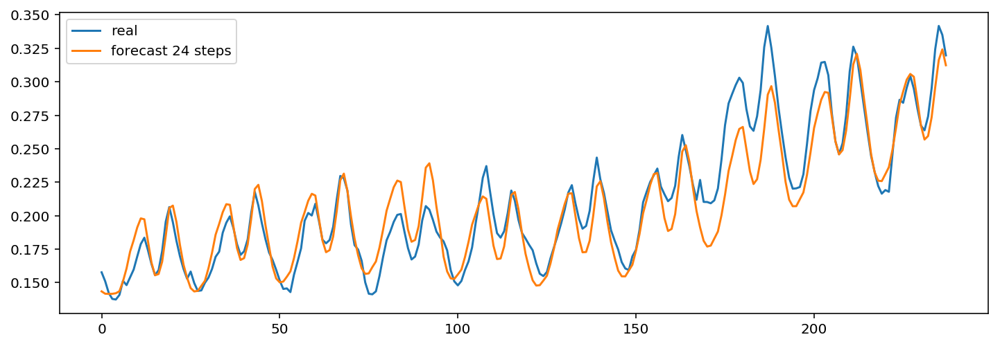

	 	 Forecasting a sample from Learning dataset


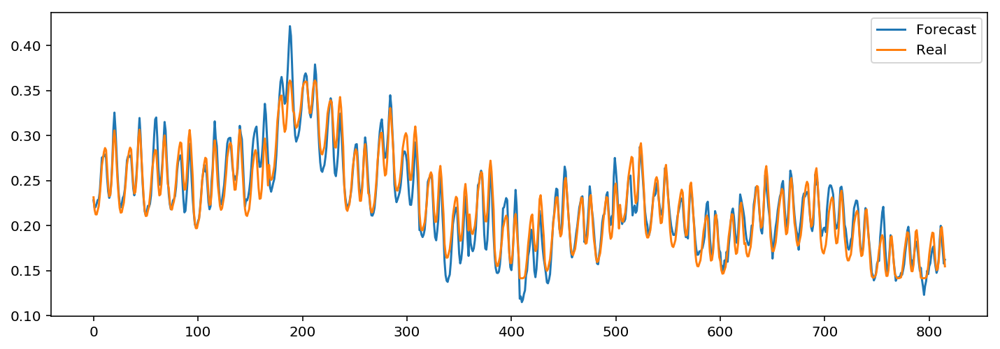

In [182]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adagrad')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 57
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.22030392137 
Daily Learning mean absolute percentage error of 34 days : 2.61230898342 
	 	 MAPError plot through Learning DataSet 


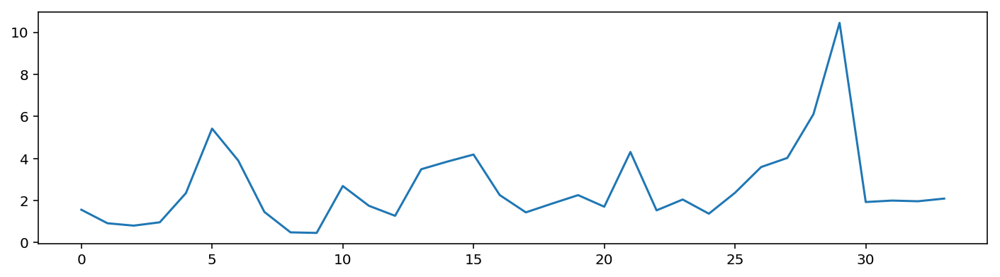

	 	 Test subset results
Test mean absolute percentage error per hour: 2.698835
Test mean absolute percentage error per day: 7.798019 
	 	 Validation Forecasting visualisation


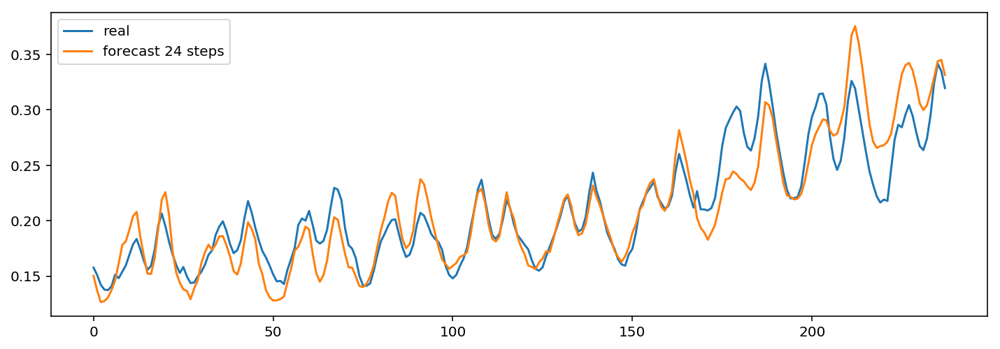

	 	 Forecasting a sample from Learning dataset


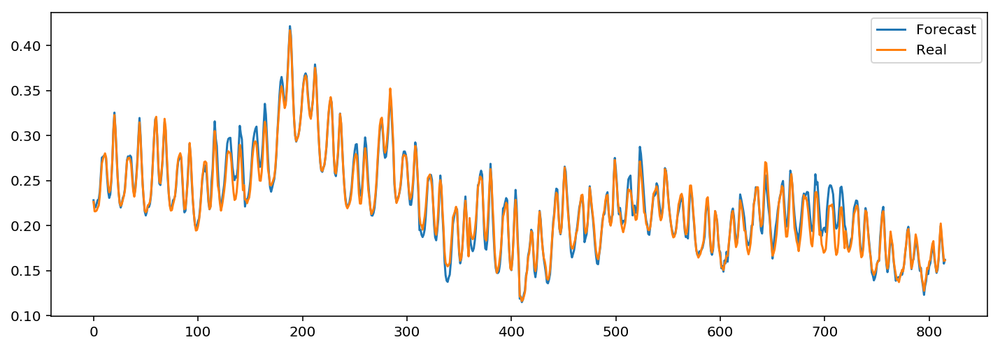

In [186]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 58
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.71622903157 
Daily Learning mean absolute percentage error of 34 days : 4.14988810525 
	 	 MAPError plot through Learning DataSet 


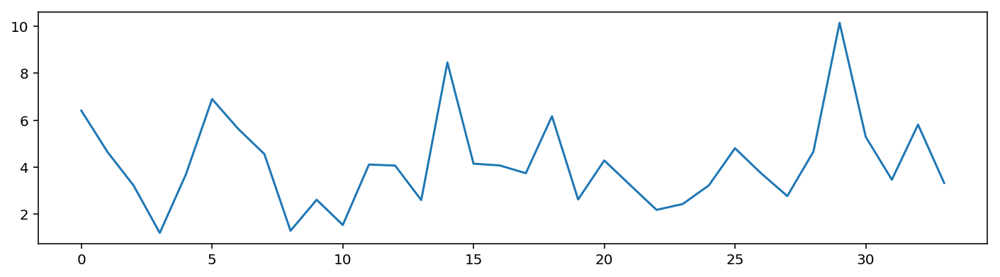

	 	 Test subset results
Test mean absolute percentage error per hour: 2.018350
Test mean absolute percentage error per day: 4.730353 
	 	 Validation Forecasting visualisation


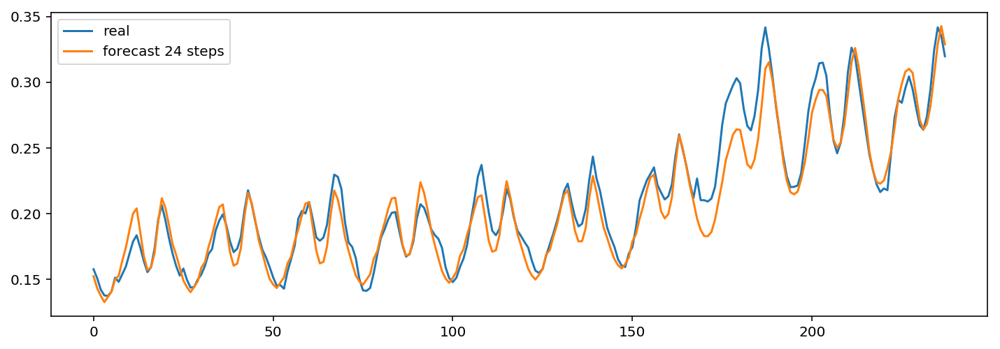

	 	 Forecasting a sample from Learning dataset


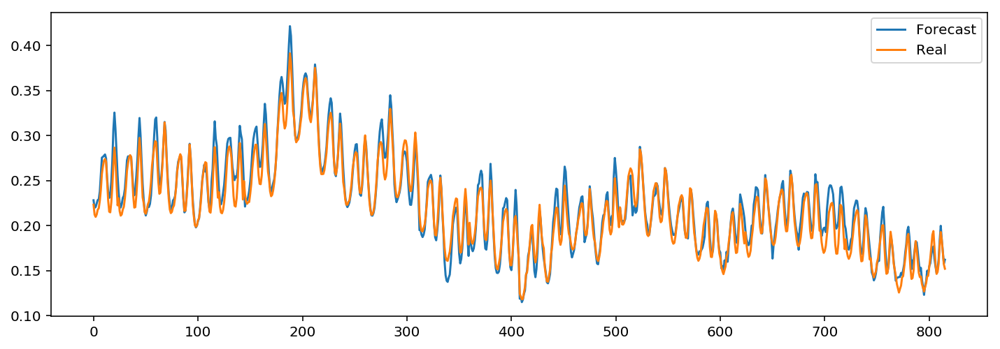

In [187]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

In [189]:
UsedInputs = np.array(UsedInputList[36:])

FinalError = np.array(MAPErrorList[36:])

summary = pd.DataFrame(np.concatenate((Models_IDs[36:],Models_parameters[36:],UsedInputs,FinalError),axis=1),columns=
                       ['Model ID','Neurons L1','Neurons L2','Learning rate','Epochs','Previous hour','Time steps','Previous day'
                        ,'Previous week','Temperature','Temp Max','Temp Min','Day indicator','Hour indicator','Month indicator','Training MAPE %',
                        'Test MAPE %'])

summary

,Model ID,Neurons L1,Neurons L2,Learning rate,Epochs,Previous hour,Time steps,Previous day,Previous week,Temperature,Temp Max,Temp Min,Day indicator,Hour indicator,Month indicator,Training MAPE %,Test MAPE %
0,36.0,60.0,30.0,0.02,71.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,8.926344,11.719683
1,37.0,60.0,30.0,0.02,349.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,11.453740,5.416210
2,38.0,60.0,30.0,0.02,983.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,4.842463,5.258615
3,39.0,160.0,70.0,0.02,52.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,10.922079,10.661437
4,40.0,160.0,70.0,0.02,226.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,12.058915,9.109560
5,41.0,160.0,70.0,0.02,100.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,9.334689,9.004047
6,42.0,160.0,70.0,0.02,887.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,2.232912,6.074610
7,43.0,160.0,70.0,0.02,962.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,4.347897,5.449147
8,44.0,20.0,10.0,0.02,982.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,5.130671,5.557303
9,45.0,60.0,20.0,0.02,989.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,5.058801,6.344839


	 	 test num : 59
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.90064742378 
Daily Learning mean absolute percentage error of 34 days : 4.85185525698 
	 	 MAPError plot through Learning DataSet 


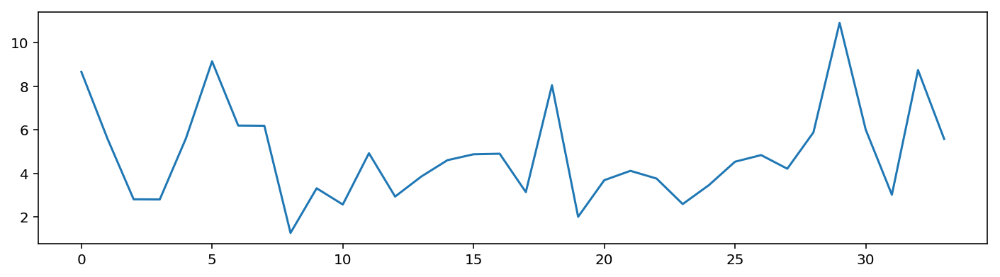

	 	 Test subset results
Test mean absolute percentage error per hour: 2.201812
Test mean absolute percentage error per day: 7.124975 
	 	 Validation Forecasting visualisation


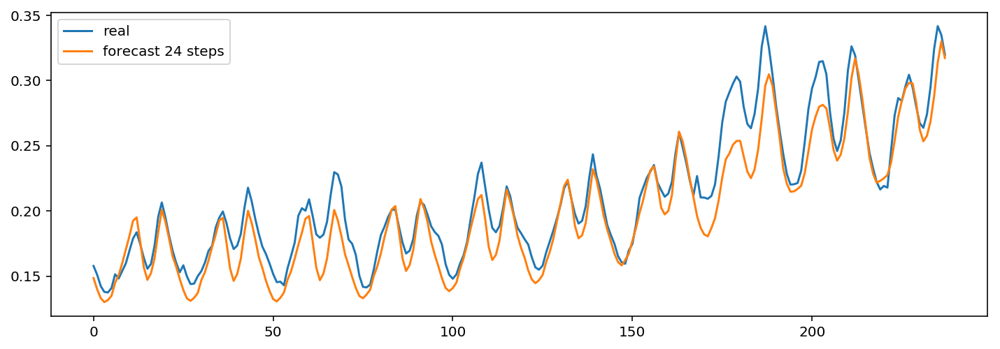

	 	 Forecasting a sample from Learning dataset


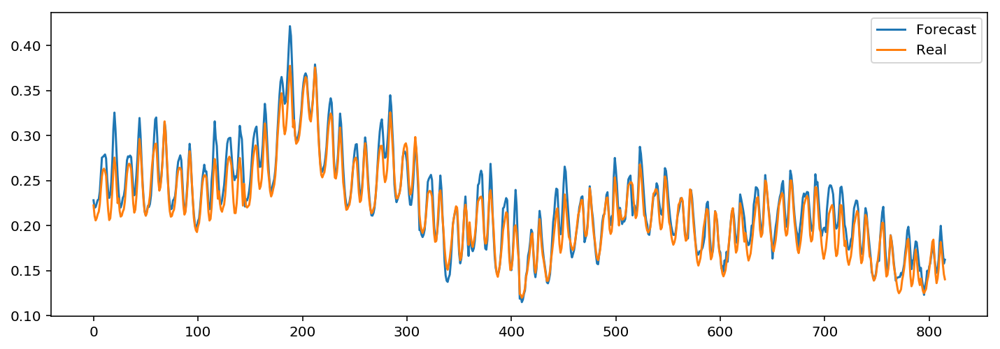

In [190]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 90
Parameters[1]= HiddenNeurons2 = 30
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 60
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.8783566411 
Daily Learning mean absolute percentage error of 34 days : 5.47288040203 
	 	 MAPError plot through Learning DataSet 


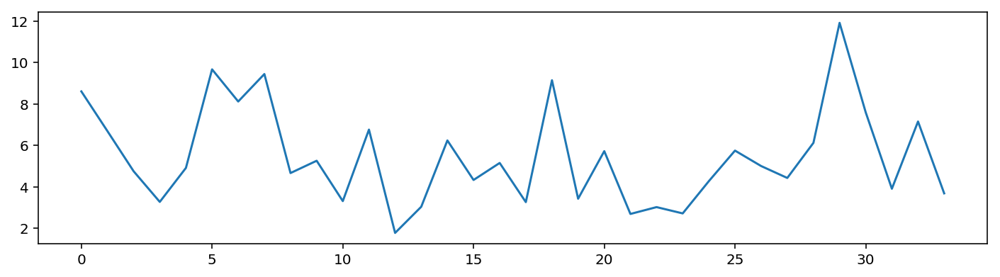

	 	 Test subset results
Test mean absolute percentage error per hour: 2.135877
Test mean absolute percentage error per day: 6.960545 
	 	 Validation Forecasting visualisation


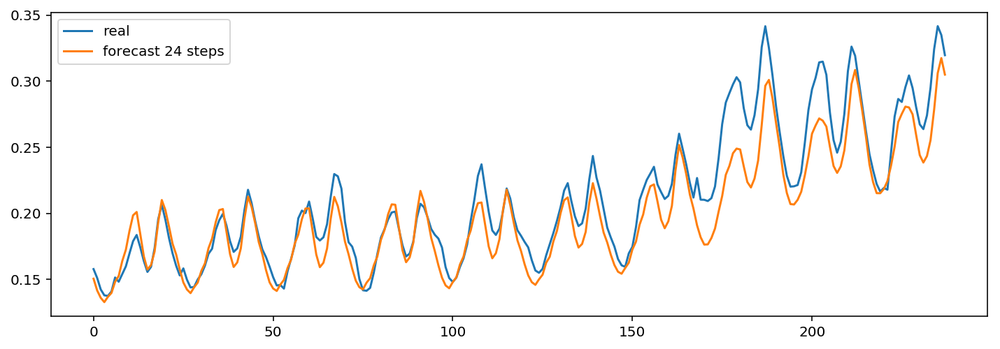

	 	 Forecasting a sample from Learning dataset


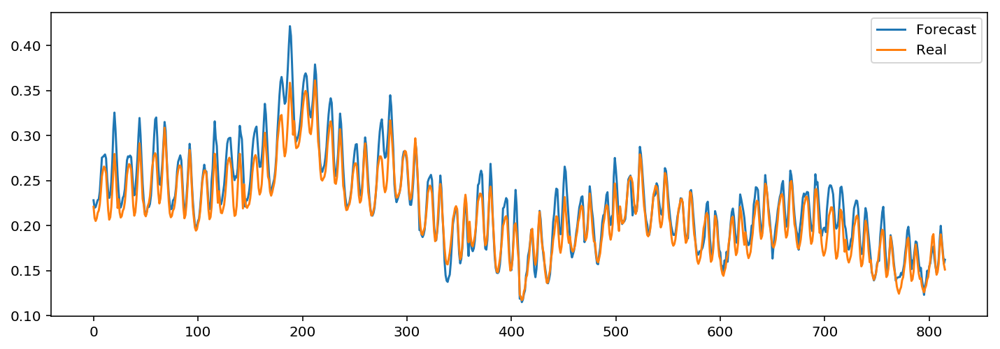

In [191]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 12
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 50
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 61
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.73589781522 
Daily Learning mean absolute percentage error of 34 days : 4.4905352873 
	 	 MAPError plot through Learning DataSet 


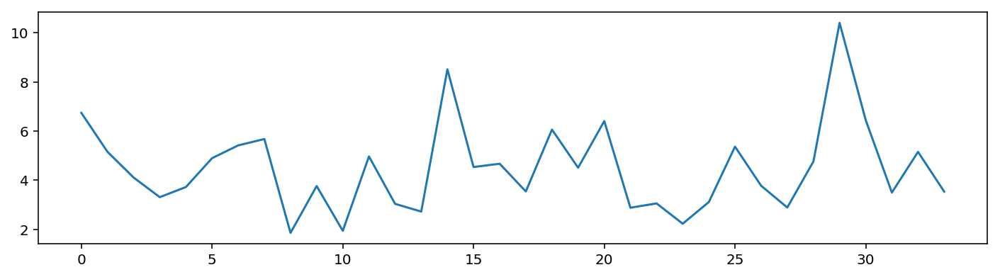

	 	 Test subset results
Test mean absolute percentage error per hour: 1.965802
Test mean absolute percentage error per day: 5.552809 
	 	 Validation Forecasting visualisation


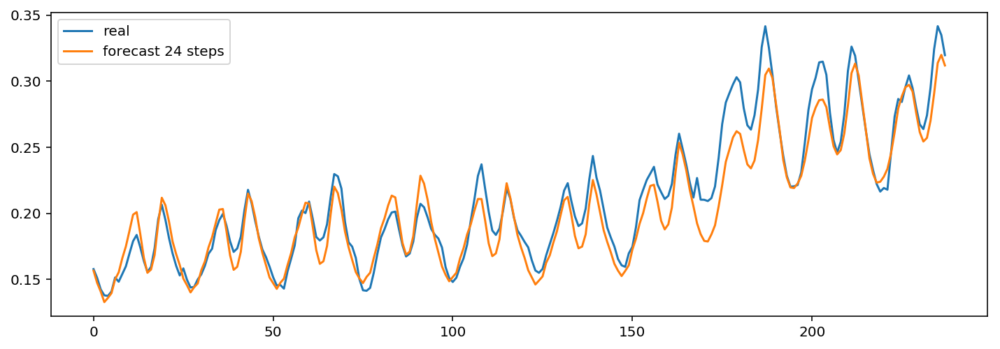

	 	 Forecasting a sample from Learning dataset


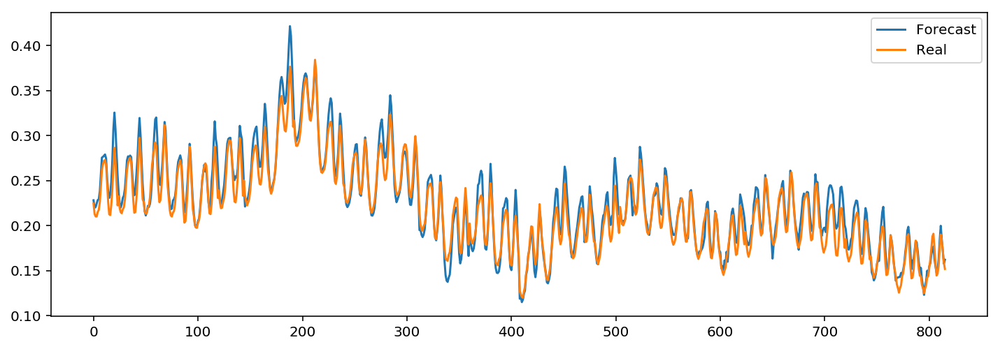

In [193]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 20
Parameters[1]= HiddenNeurons2 = 10
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 62
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.75597608521 
Daily Learning mean absolute percentage error of 34 days : 4.05893383307 
	 	 MAPError plot through Learning DataSet 


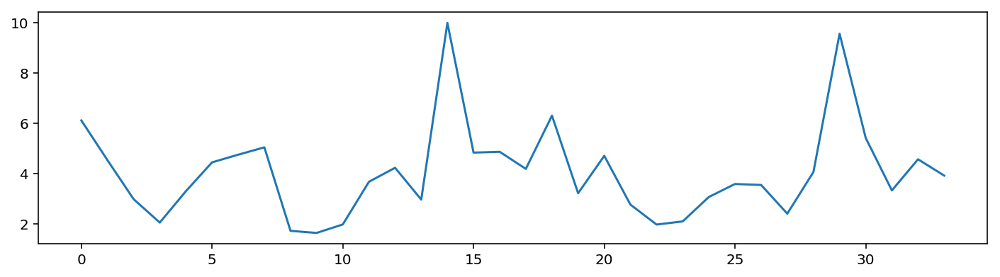

	 	 Test subset results
Test mean absolute percentage error per hour: 1.954970
Test mean absolute percentage error per day: 4.547532 
	 	 Validation Forecasting visualisation


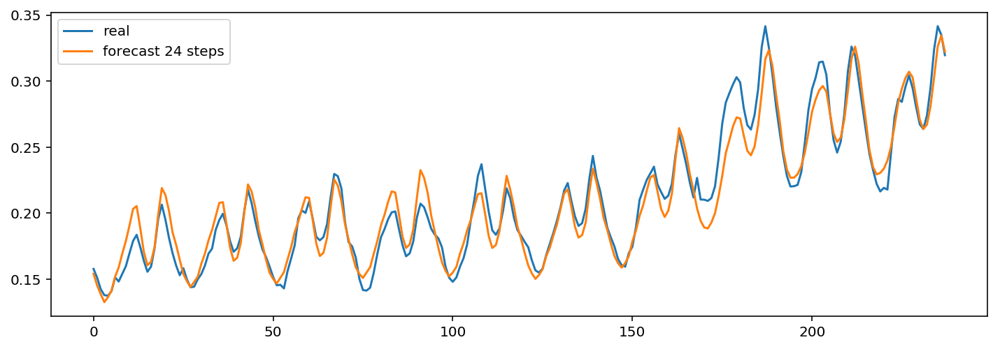

	 	 Forecasting a sample from Learning dataset


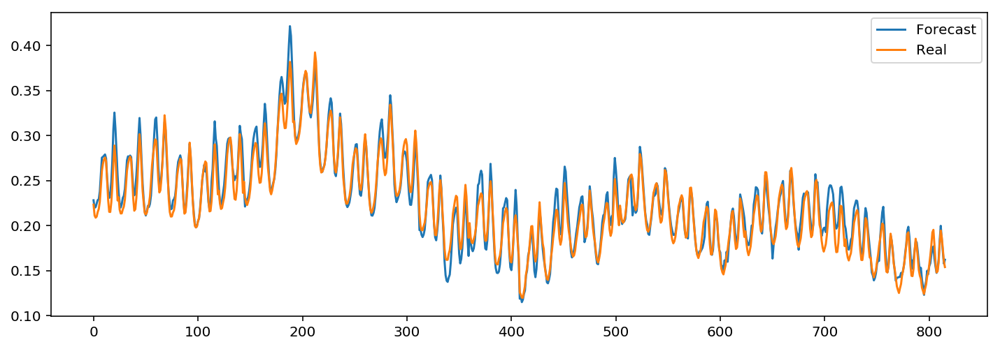

In [194]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 81
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.7587458791 
Daily Learning mean absolute percentage error of 34 days : 4.2701550091 
	 	 MAPError plot through Learning DataSet 


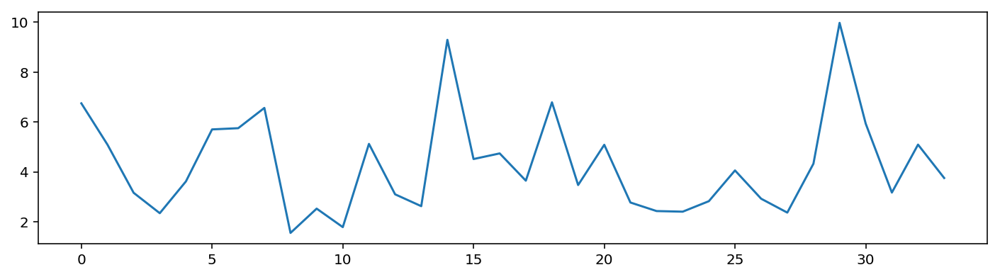

	 	 Test subset results
Test mean absolute percentage error per hour: 1.964797
Test mean absolute percentage error per day: 4.873423 
	 	 Validation Forecasting visualisation


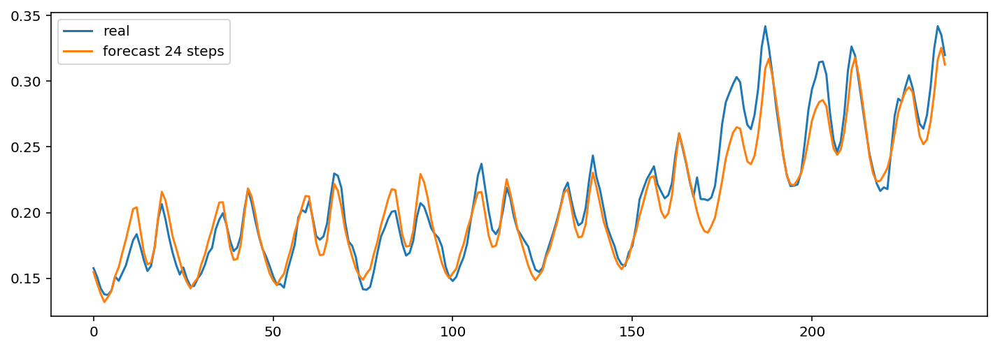

	 	 Forecasting a sample from Learning dataset


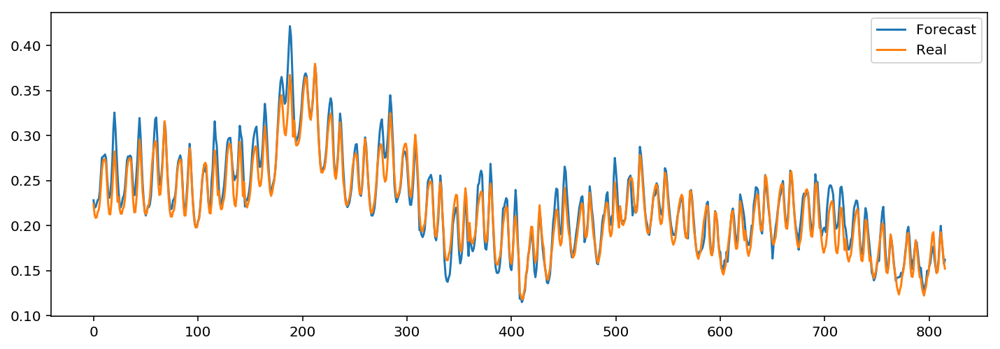

In [217]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 76
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.79640667028 
Daily Learning mean absolute percentage error of 34 days : 4.31333665637 
	 	 MAPError plot through Learning DataSet 


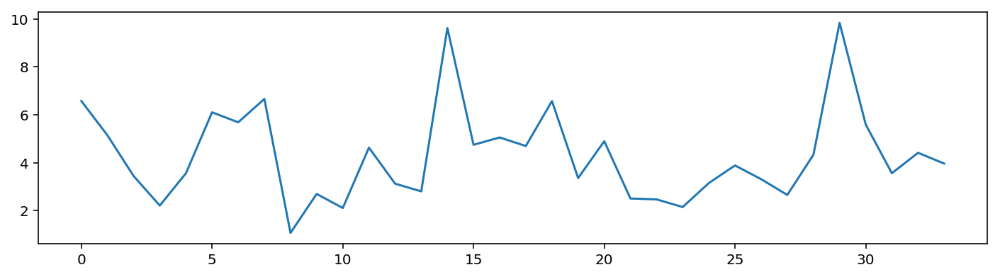

	 	 Test subset results
Test mean absolute percentage error per hour: 2.010308
Test mean absolute percentage error per day: 4.761508 
	 	 Validation Forecasting visualisation


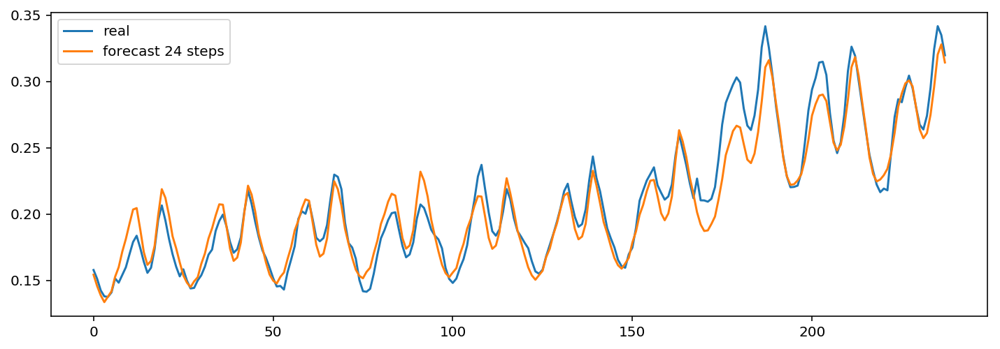

	 	 Forecasting a sample from Learning dataset


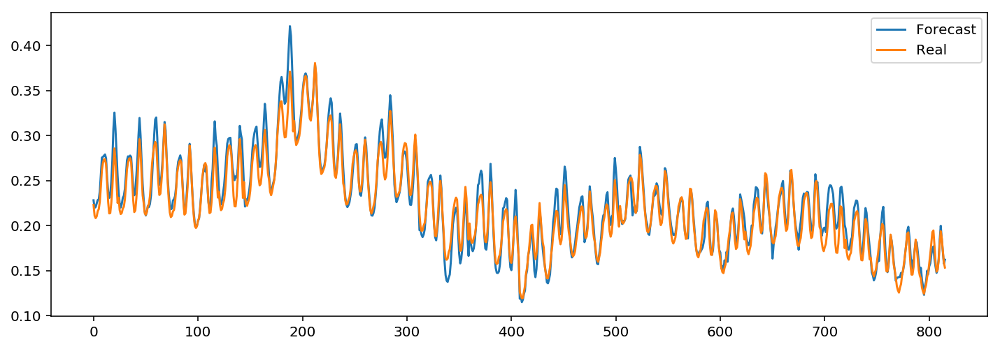

In [212]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 77
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.79200035318 
Daily Learning mean absolute percentage error of 34 days : 4.34769388858 
	 	 MAPError plot through Learning DataSet 


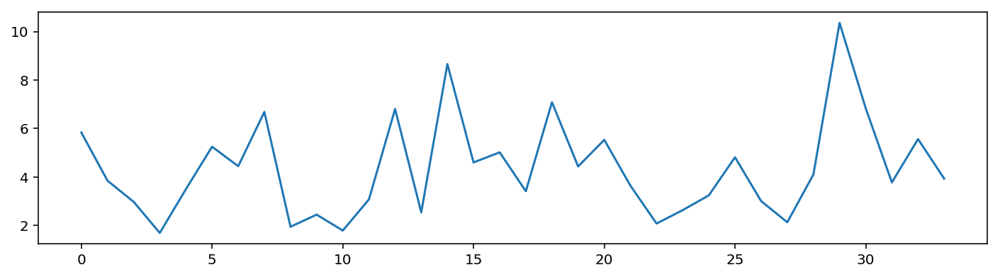

	 	 Test subset results
Test mean absolute percentage error per hour: 1.924715
Test mean absolute percentage error per day: 5.049046 
	 	 Validation Forecasting visualisation


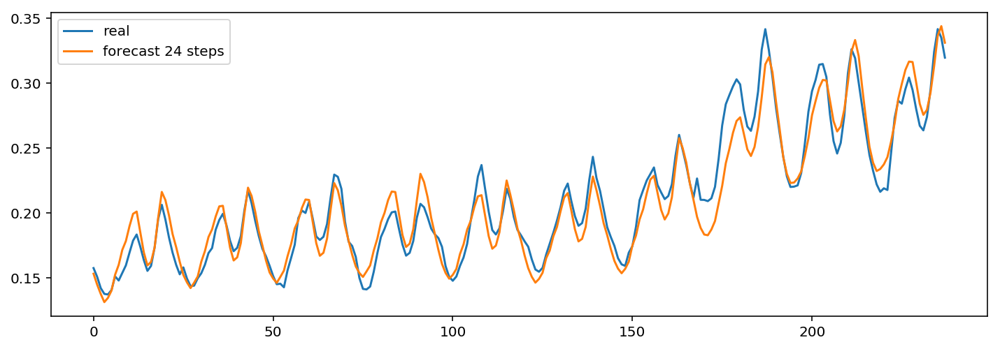

	 	 Forecasting a sample from Learning dataset


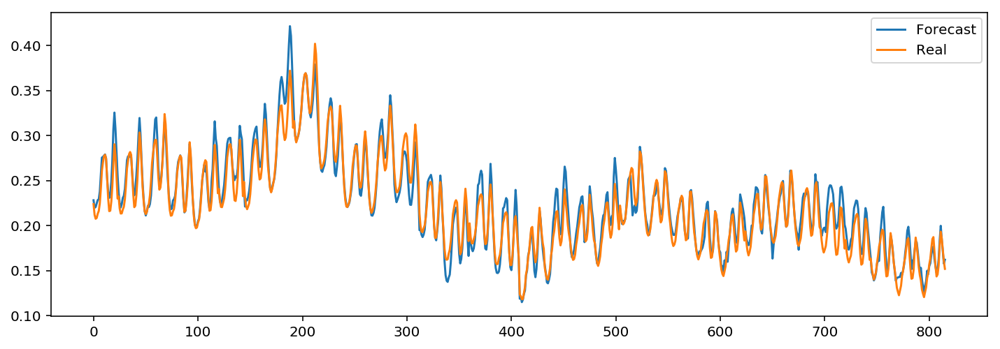

In [213]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='rmsprop')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 78
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.78663034796 
Daily Learning mean absolute percentage error of 34 days : 4.07942365899 
	 	 MAPError plot through Learning DataSet 


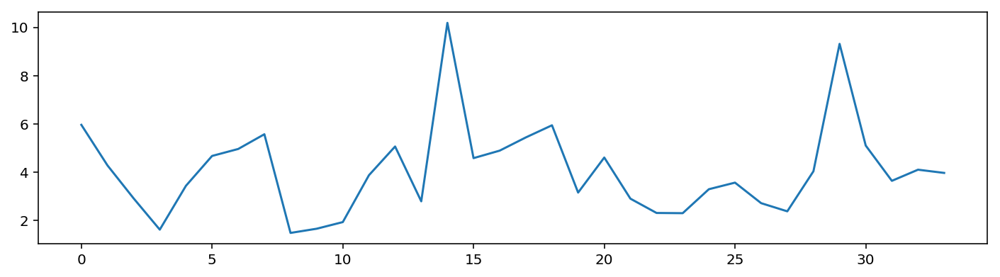

	 	 Test subset results
Test mean absolute percentage error per hour: 2.054455
Test mean absolute percentage error per day: 4.878982 
	 	 Validation Forecasting visualisation


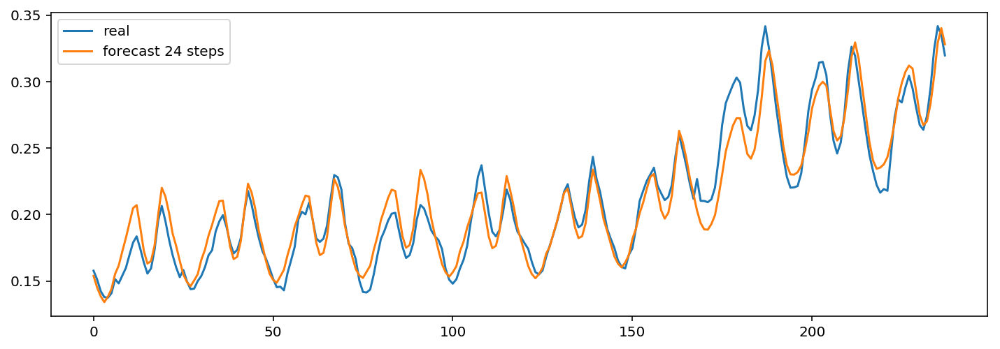

	 	 Forecasting a sample from Learning dataset


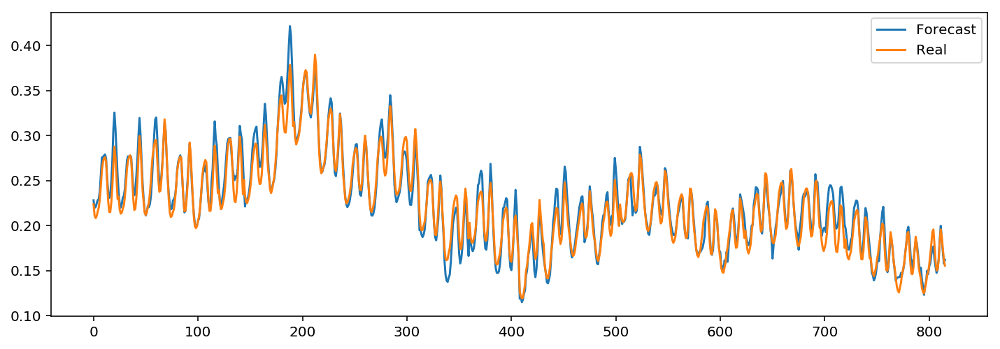

In [214]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 34
Parameters[1]= HiddenNeurons2 = 18
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 79
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.74637592794 
Daily Learning mean absolute percentage error of 34 days : 4.29268070179 
	 	 MAPError plot through Learning DataSet 


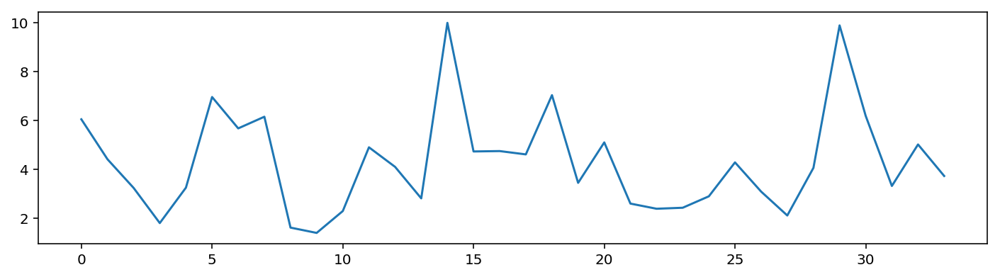

	 	 Test subset results
Test mean absolute percentage error per hour: 1.971605
Test mean absolute percentage error per day: 4.889116 
	 	 Validation Forecasting visualisation


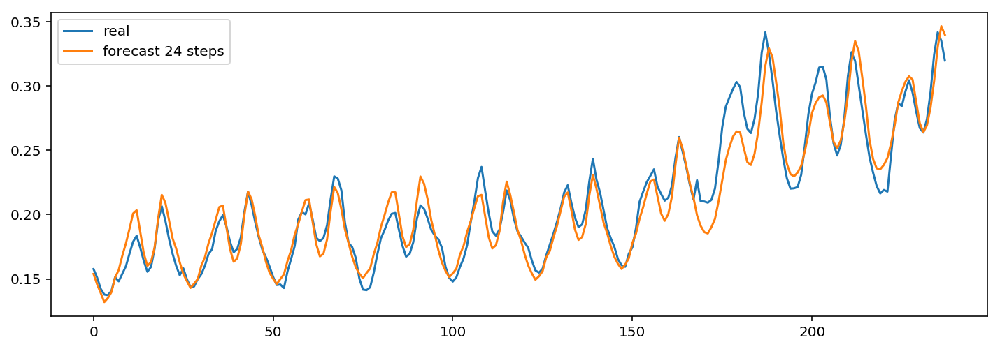

	 	 Forecasting a sample from Learning dataset


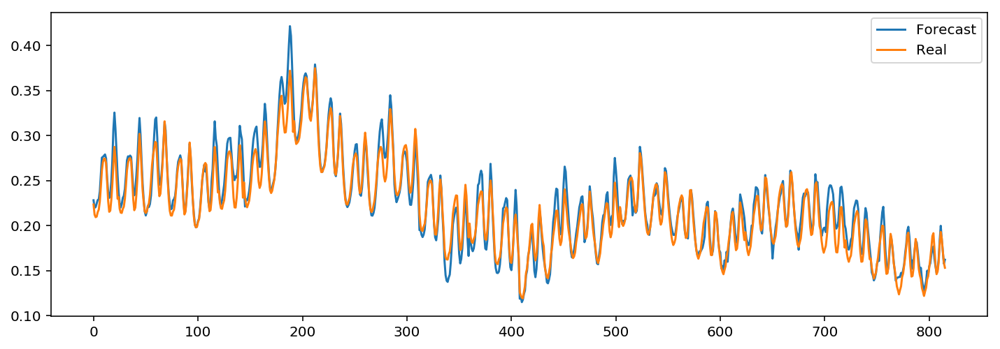

In [215]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 42
Parameters[1]= HiddenNeurons2 = 24
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 80
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.72895562784 
Daily Learning mean absolute percentage error of 34 days : 4.16698907053 
	 	 MAPError plot through Learning DataSet 


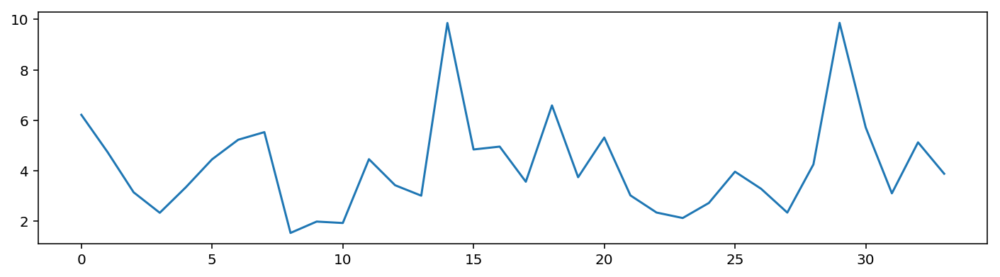

	 	 Test subset results
Test mean absolute percentage error per hour: 1.967586
Test mean absolute percentage error per day: 4.821048 
	 	 Validation Forecasting visualisation


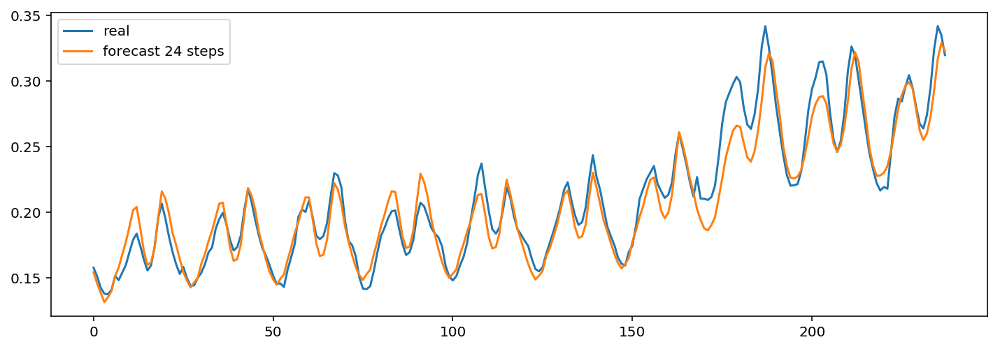

	 	 Forecasting a sample from Learning dataset


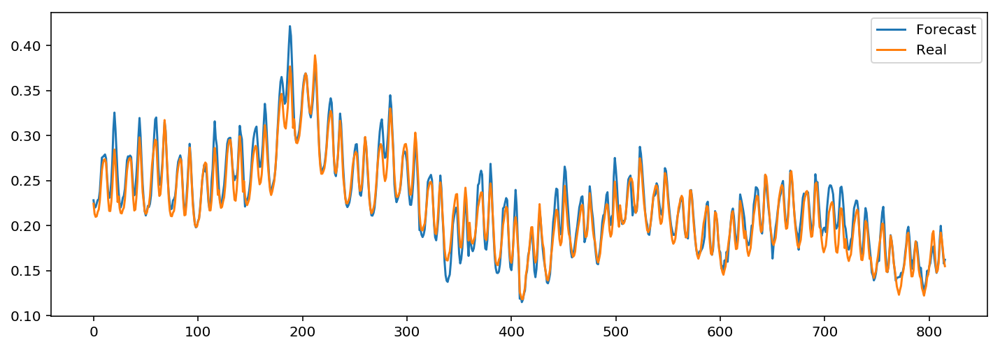

In [216]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 33
Parameters[1]= HiddenNeurons2 = 24
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 63
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.731921139 
Daily Learning mean absolute percentage error of 34 days : 4.36165690422 
	 	 MAPError plot through Learning DataSet 


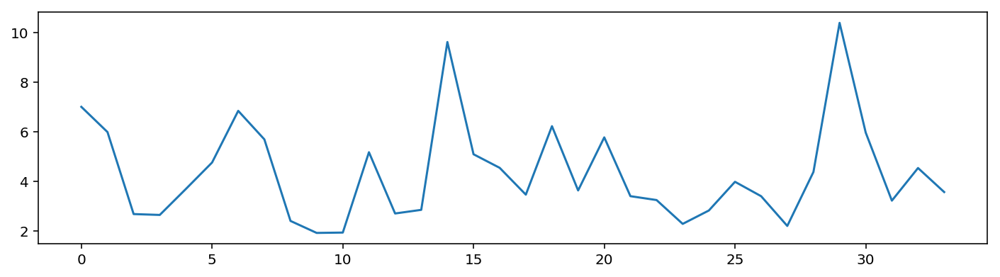

	 	 Test subset results
Test mean absolute percentage error per hour: 1.914108
Test mean absolute percentage error per day: 4.967553 
	 	 Validation Forecasting visualisation


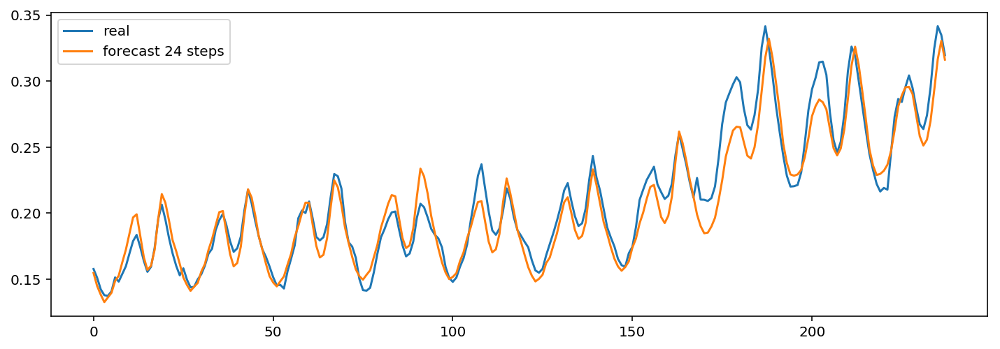

	 	 Forecasting a sample from Learning dataset


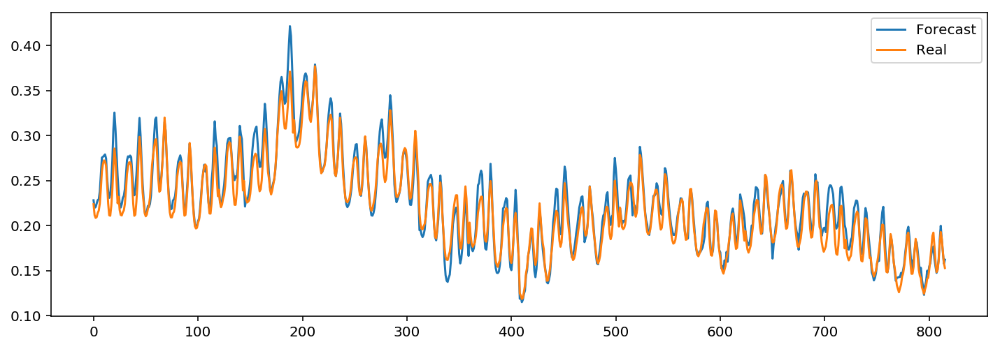

In [195]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 3
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 64
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.70592708877 
Daily Learning mean absolute percentage error of 34 days : 3.94393969634 
	 	 MAPError plot through Learning DataSet 


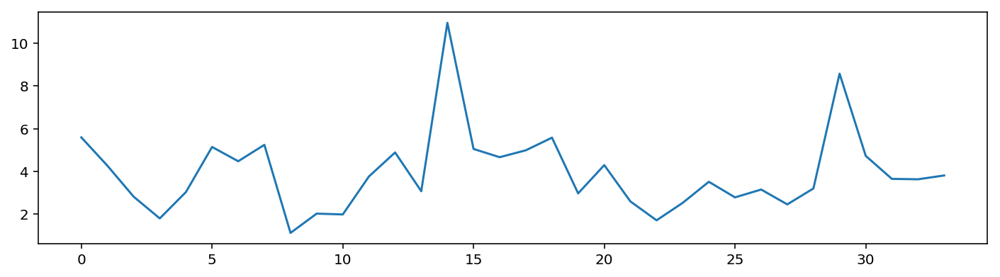

	 	 Test subset results
Test mean absolute percentage error per hour: 1.952441
Test mean absolute percentage error per day: 4.636000 
	 	 Validation Forecasting visualisation


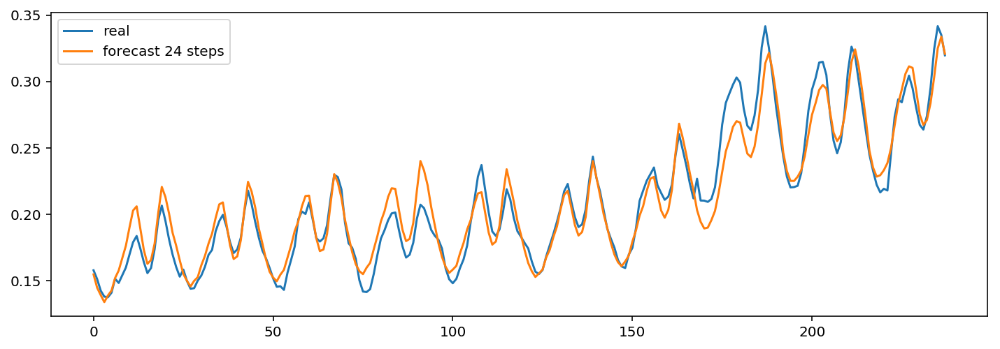

	 	 Forecasting a sample from Learning dataset


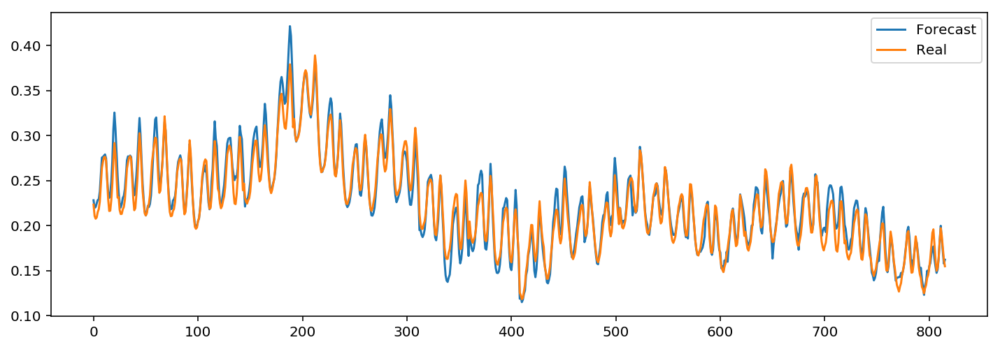

In [196]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 2
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 65
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.69909810656 
Daily Learning mean absolute percentage error of 34 days : 3.82784847652 
	 	 MAPError plot through Learning DataSet 


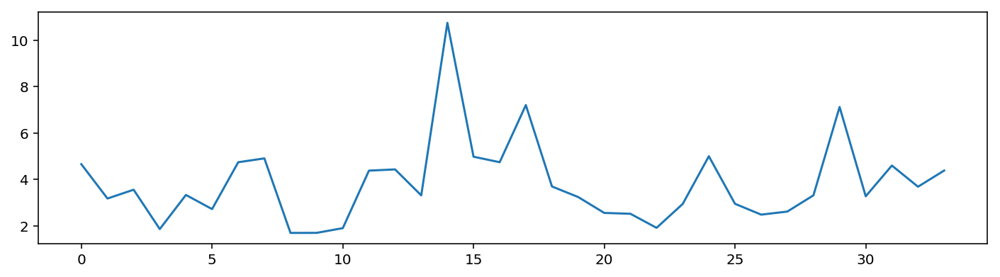

	 	 Test subset results
Test mean absolute percentage error per hour: 2.051342
Test mean absolute percentage error per day: 5.637661 
	 	 Validation Forecasting visualisation


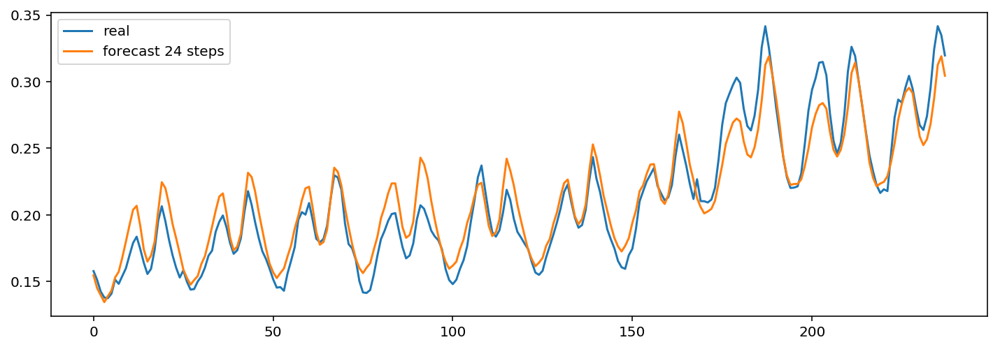

	 	 Forecasting a sample from Learning dataset


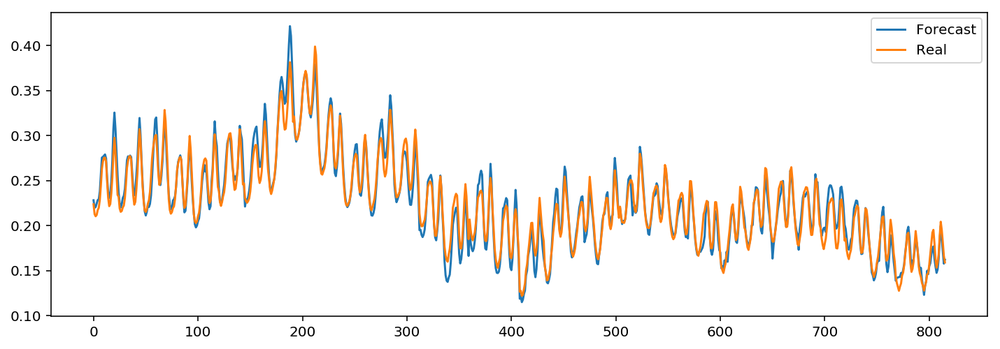

In [197]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 1
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

In [218]:
UsedInputs = np.array(UsedInputList[36:])

FinalError = np.array(MAPErrorList[36:])

summary = pd.DataFrame(np.concatenate((Models_IDs[36:],Models_parameters[36:],UsedInputs,FinalError),axis=1),columns=
                       ['Model ID','Neurons L1','Neurons L2','Learning rate','Epochs','Previous hour','Time steps','Previous day'
                        ,'Previous week','Temperature','Temp Max','Temp Min','Day indicator','Hour indicator','Month indicator','Training MAPE %',
                        'Test MAPE %'])

summary

,Model ID,Neurons L1,Neurons L2,Learning rate,Epochs,Previous hour,Time steps,Previous day,Previous week,Temperature,Temp Max,Temp Min,Day indicator,Hour indicator,Month indicator,Training MAPE %,Test MAPE %
0,36.0,60.0,30.0,0.02,71.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,8.926344,11.719683
1,37.0,60.0,30.0,0.02,349.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,11.453740,5.416210
2,38.0,60.0,30.0,0.02,983.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,4.842463,5.258615
3,39.0,160.0,70.0,0.02,52.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,10.922079,10.661437
4,40.0,160.0,70.0,0.02,226.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,12.058915,9.109560
5,41.0,160.0,70.0,0.02,100.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,9.334689,9.004047
6,42.0,160.0,70.0,0.02,887.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,2.232912,6.074610
7,43.0,160.0,70.0,0.02,962.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,4.347897,5.449147
8,44.0,20.0,10.0,0.02,982.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,5.130671,5.557303
9,45.0,60.0,20.0,0.02,989.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,5.058801,6.344839


	 	 test num : 66
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 2.8833253977 
Daily Learning mean absolute percentage error of 34 days : 7.64748447082 
	 	 MAPError plot through Learning DataSet 


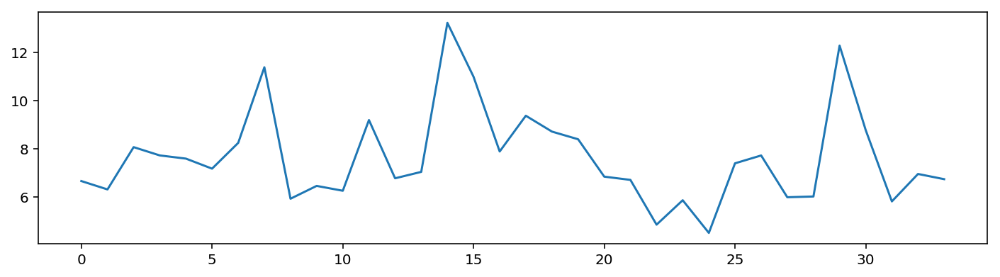

	 	 Test subset results
Test mean absolute percentage error per hour: 2.513140
Test mean absolute percentage error per day: 6.295384 
	 	 Validation Forecasting visualisation


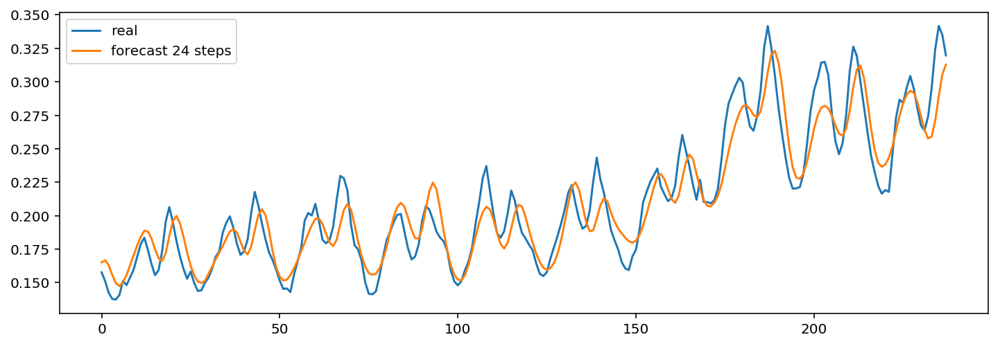

	 	 Forecasting a sample from Learning dataset


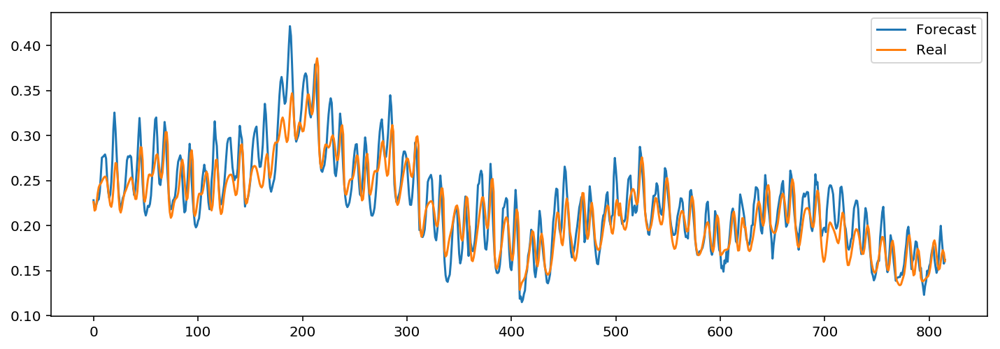

In [199]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 67
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 4.96191865399 
Daily Learning mean absolute percentage error of 34 days : 10.1939590258 
	 	 MAPError plot through Learning DataSet 


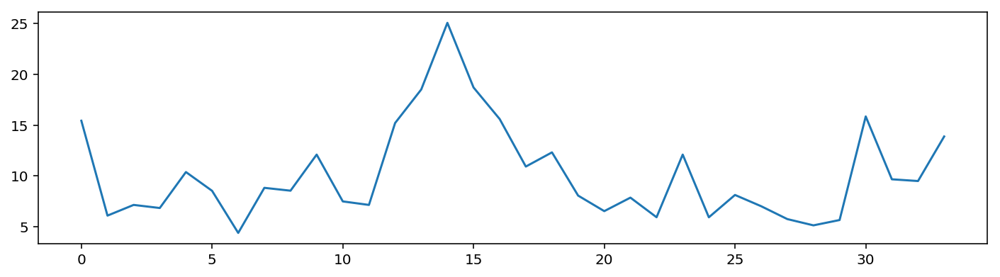

	 	 Test subset results
Test mean absolute percentage error per hour: 3.899470
Test mean absolute percentage error per day: 7.470793 
	 	 Validation Forecasting visualisation


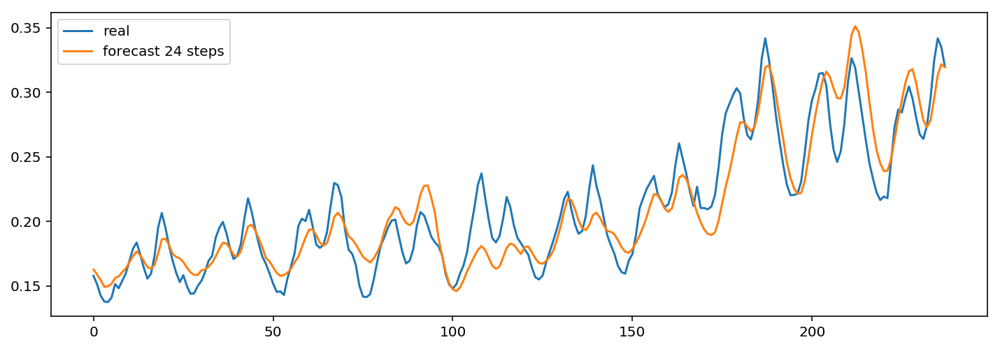

	 	 Forecasting a sample from Learning dataset


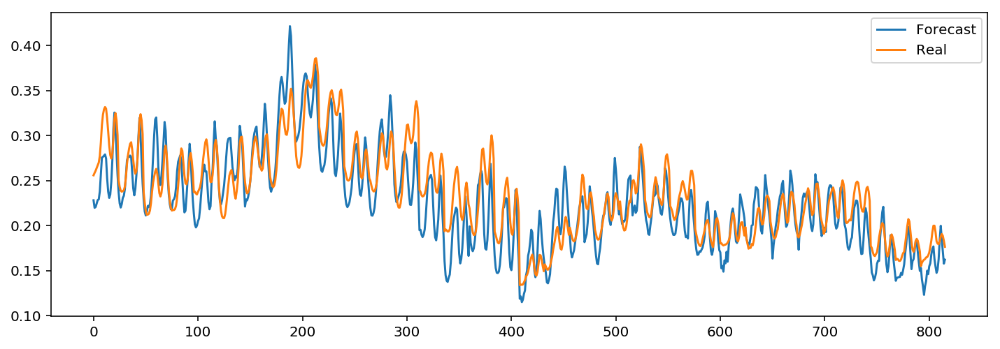

In [200]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 1
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = False
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 68
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 2.91809971094 
Daily Learning mean absolute percentage error of 34 days : 9.90248476758 
	 	 MAPError plot through Learning DataSet 


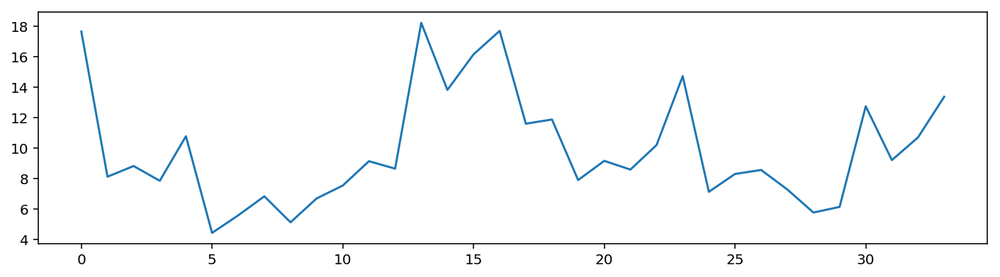

	 	 Test subset results
Test mean absolute percentage error per hour: 2.917258
Test mean absolute percentage error per day: 9.414486 
	 	 Validation Forecasting visualisation


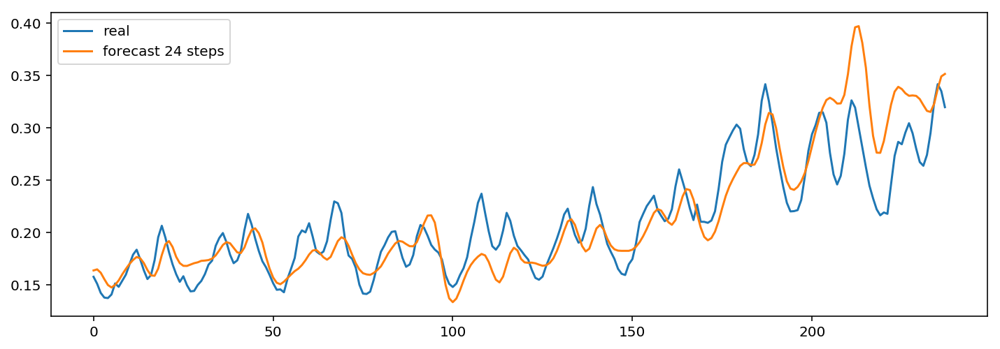

	 	 Forecasting a sample from Learning dataset


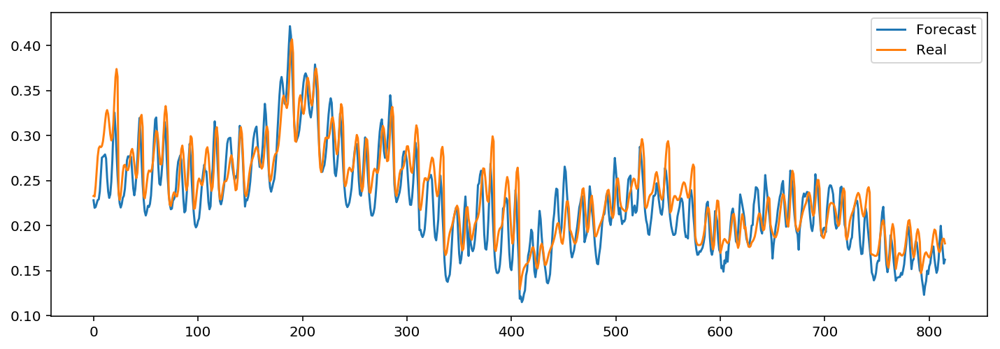

In [201]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = False
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 69
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.77052160745 
Daily Learning mean absolute percentage error of 34 days : 5.7637242745 
	 	 MAPError plot through Learning DataSet 


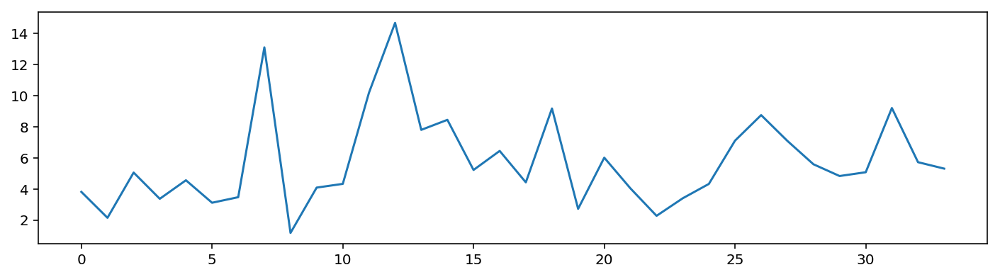

	 	 Test subset results
Test mean absolute percentage error per hour: 2.008799
Test mean absolute percentage error per day: 16.149765 
	 	 Validation Forecasting visualisation


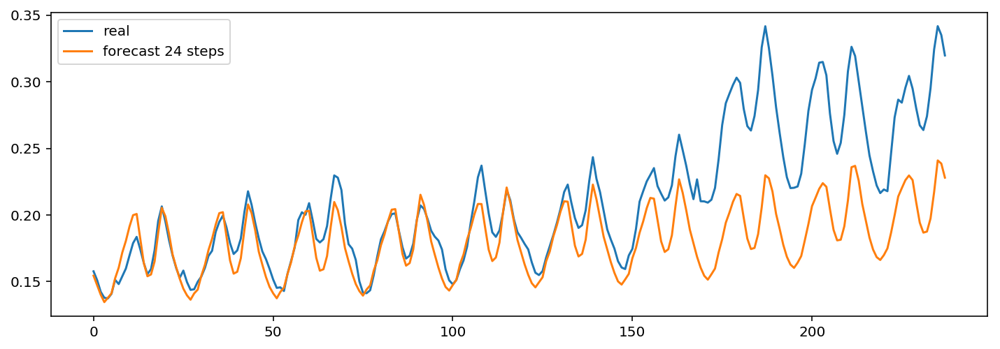

	 	 Forecasting a sample from Learning dataset


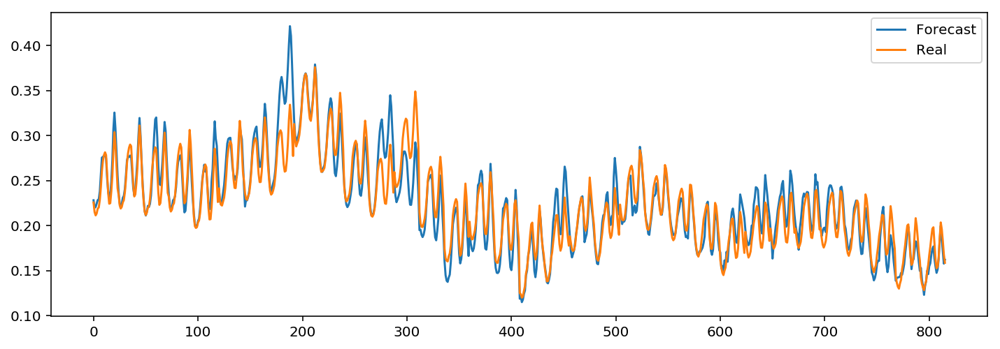

In [202]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 70
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 2.97840370632 
Daily Learning mean absolute percentage error of 34 days : 12.1280823595 
	 	 MAPError plot through Learning DataSet 


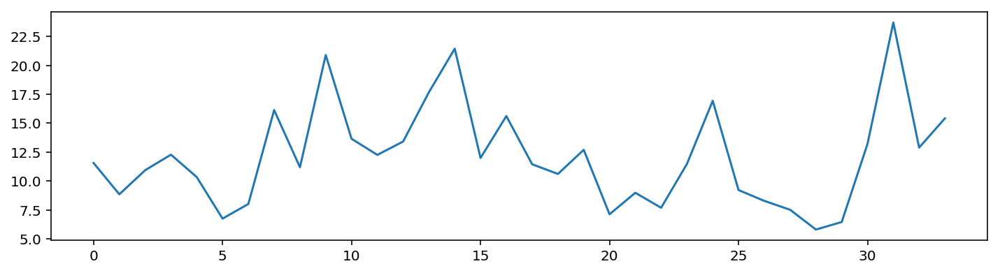

	 	 Test subset results
Test mean absolute percentage error per hour: 2.679705
Test mean absolute percentage error per day: 9.685554 
	 	 Validation Forecasting visualisation


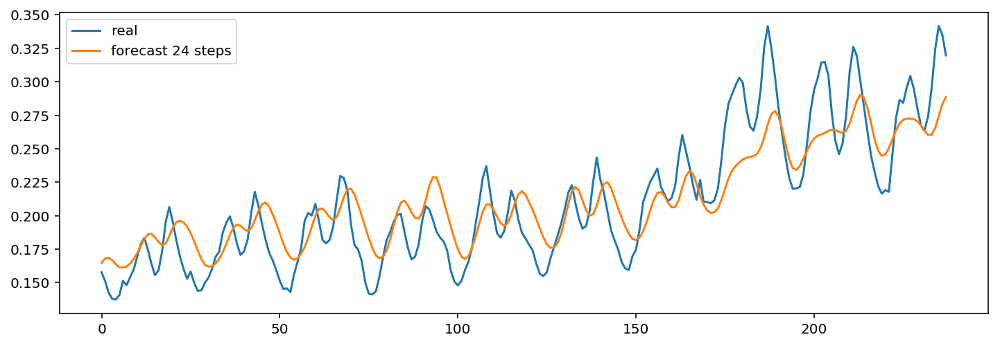

	 	 Forecasting a sample from Learning dataset


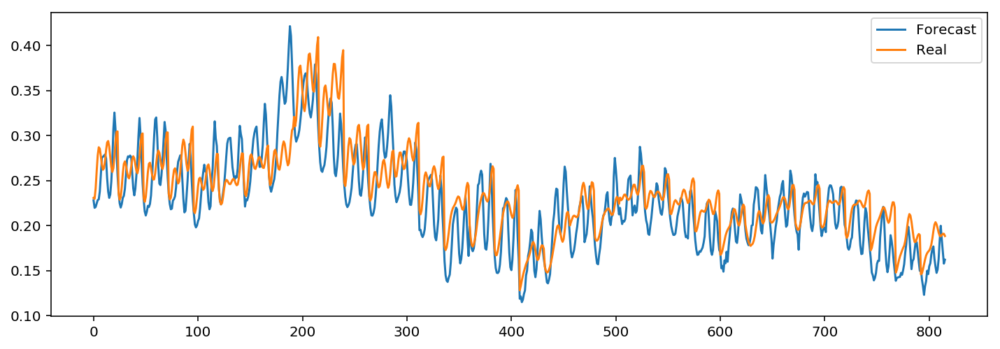

In [203]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 71
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 6.74591475735 
Daily Learning mean absolute percentage error of 34 days : 12.3269917544 
	 	 MAPError plot through Learning DataSet 


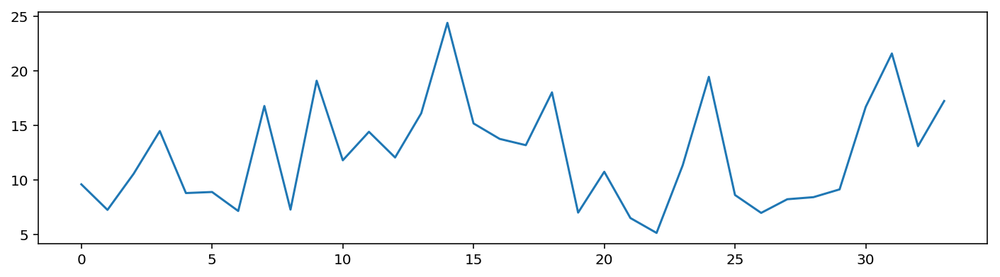

	 	 Test subset results
Test mean absolute percentage error per hour: 6.265721
Test mean absolute percentage error per day: 13.230515 
	 	 Validation Forecasting visualisation


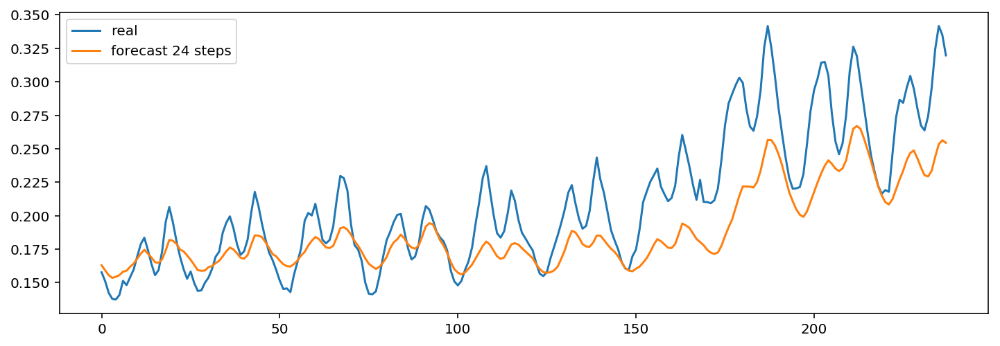

	 	 Forecasting a sample from Learning dataset


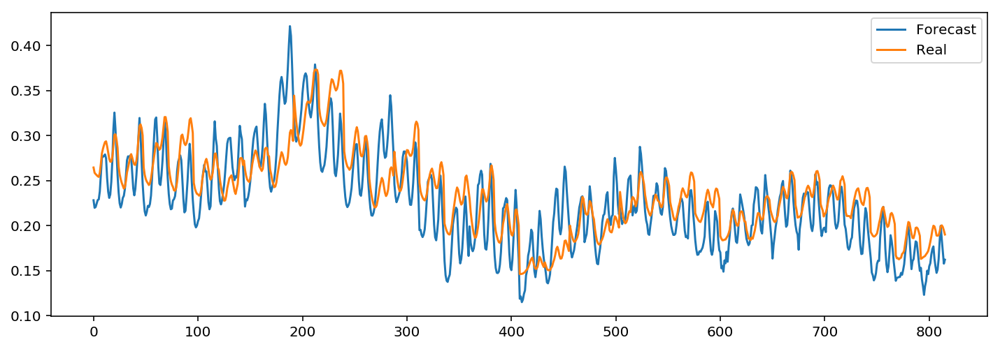

In [204]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = False
UsedInputsTemp[5] = TempMax = False
UsedInputsTemp[6] = TempMin = False
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = False
UsedInputsTemp[9] = MonthIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 72
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 2.62037014489 
Daily Learning mean absolute percentage error of 34 days : 5.86025269593 
	 	 MAPError plot through Learning DataSet 


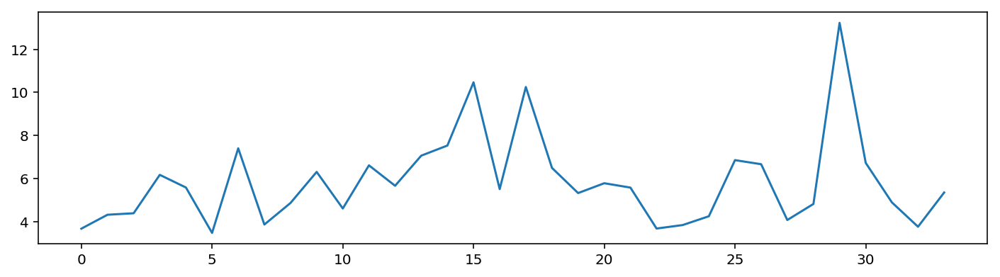

	 	 Test subset results
Test mean absolute percentage error per hour: 2.581068
Test mean absolute percentage error per day: 6.522501 
	 	 Validation Forecasting visualisation


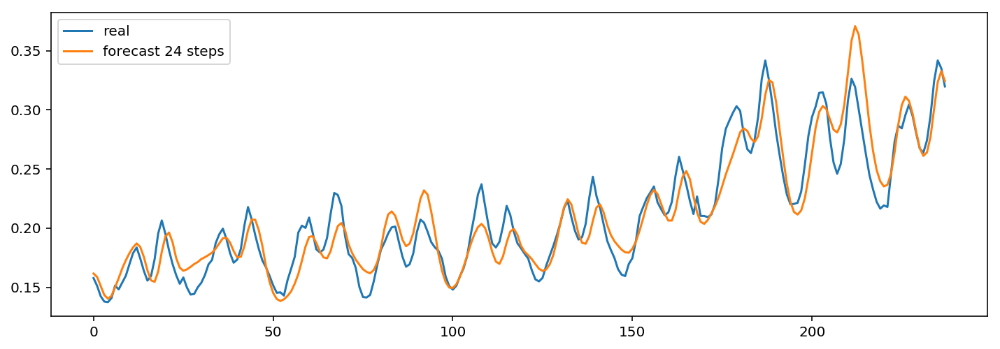

	 	 Forecasting a sample from Learning dataset


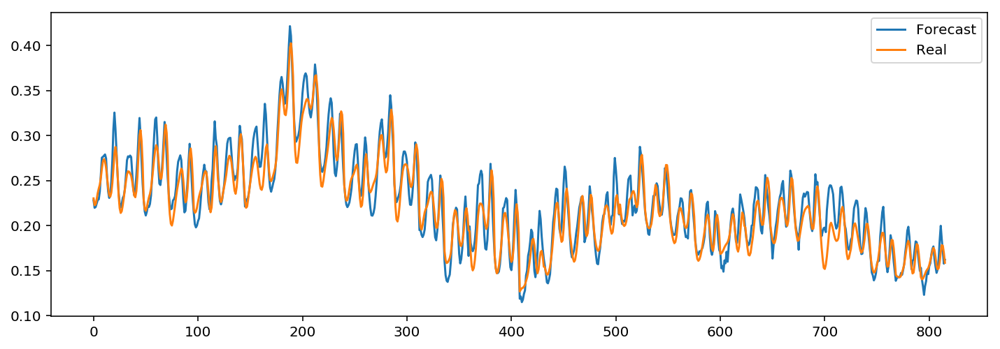

In [205]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = False
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 73
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.68304090453 
Daily Learning mean absolute percentage error of 34 days : 4.17629554692 
	 	 MAPError plot through Learning DataSet 


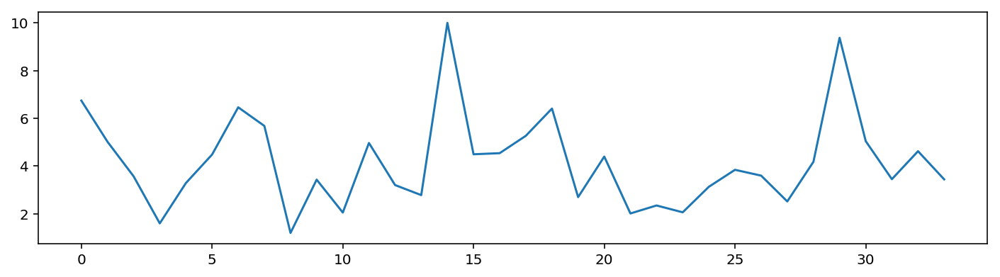

	 	 Test subset results
Test mean absolute percentage error per hour: 2.021373
Test mean absolute percentage error per day: 4.836309 
	 	 Validation Forecasting visualisation


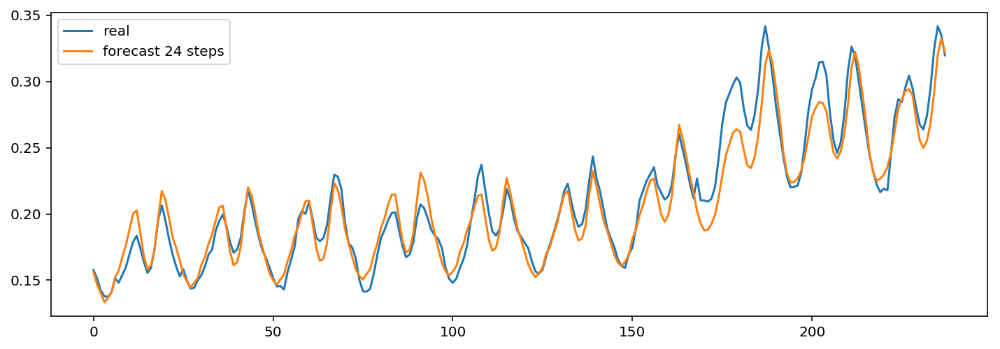

	 	 Forecasting a sample from Learning dataset


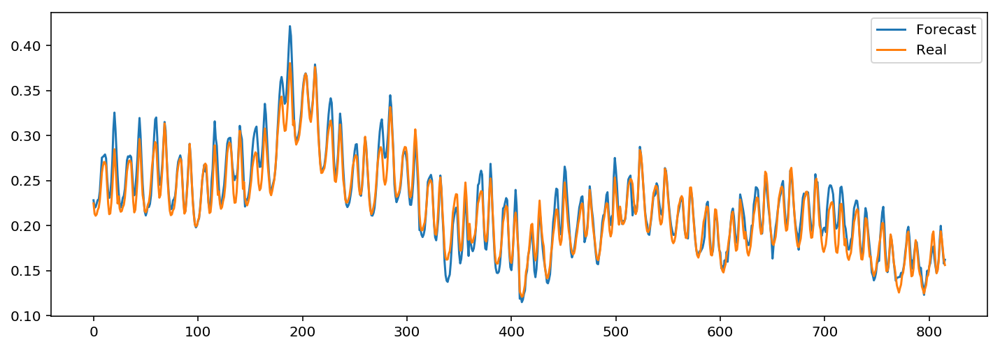

In [206]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 74
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.12439098712 
Daily Learning mean absolute percentage error of 34 days : 2.65572771868 
	 	 MAPError plot through Learning DataSet 


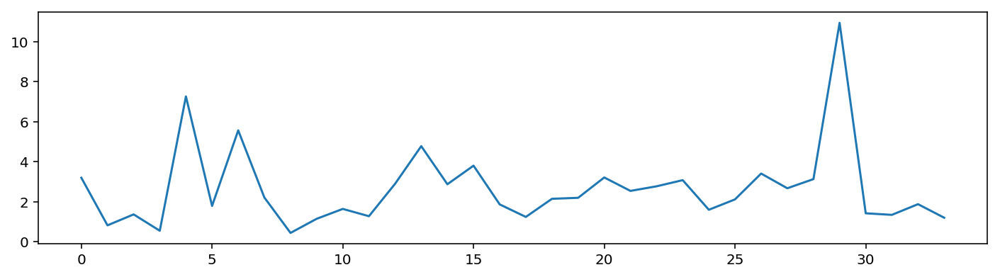

	 	 Test subset results
Test mean absolute percentage error per hour: 2.524652
Test mean absolute percentage error per day: 6.873188 
	 	 Validation Forecasting visualisation


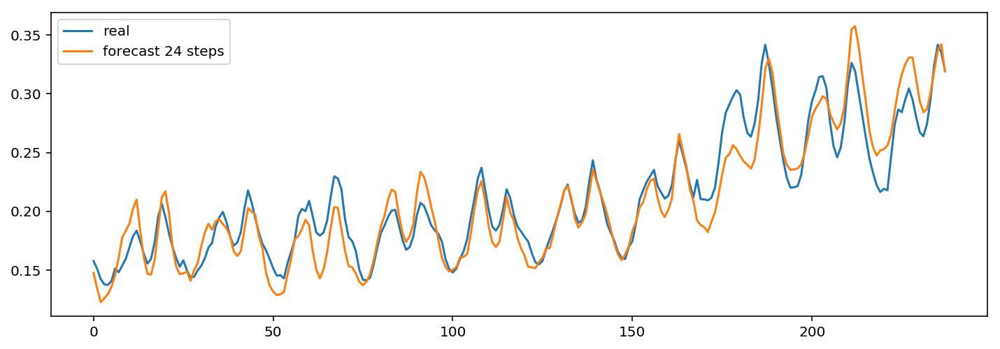

	 	 Forecasting a sample from Learning dataset


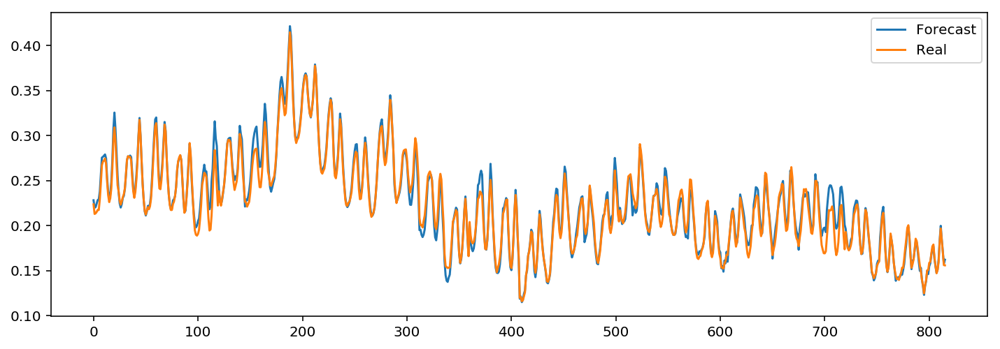

In [207]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 75
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 2.17478940427 
Daily Learning mean absolute percentage error of 34 days : 5.03329964596 
	 	 MAPError plot through Learning DataSet 


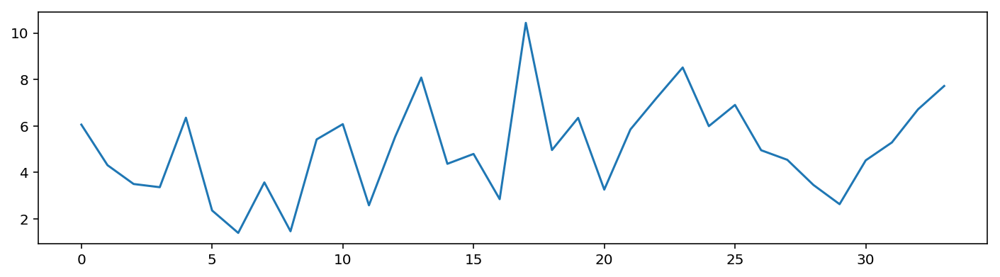

	 	 Test subset results
Test mean absolute percentage error per hour: 3.555675
Test mean absolute percentage error per day: 6.918764 
	 	 Validation Forecasting visualisation


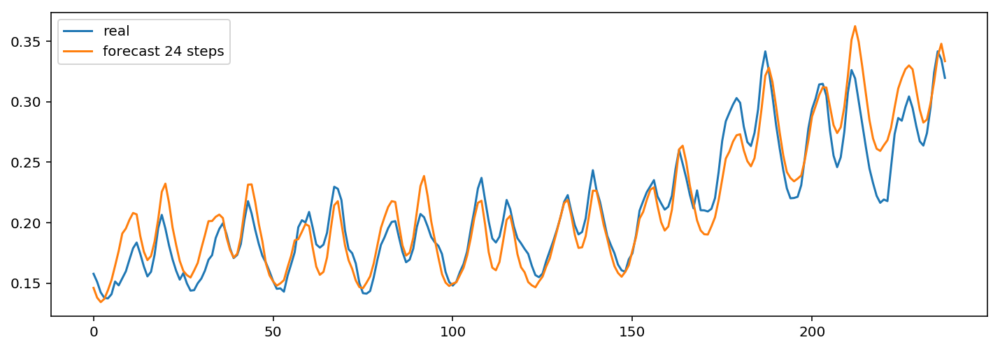

	 	 Forecasting a sample from Learning dataset


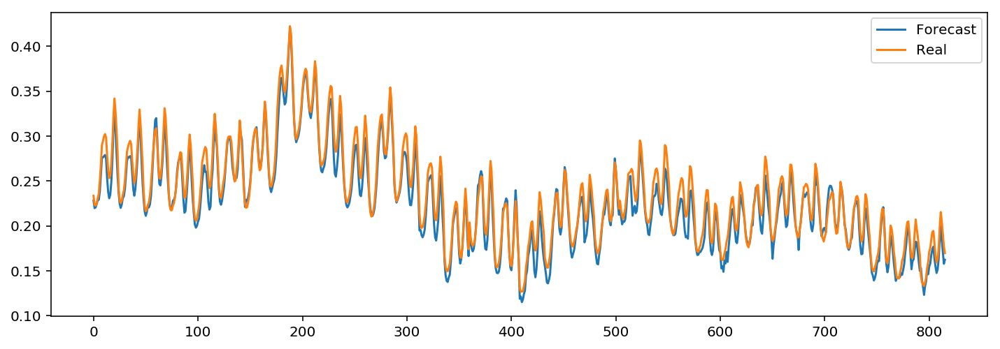

In [208]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = True
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = True

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model.save('Models/lstm_%d_%s_%s'%(Model_ID,season,today))
# MLP_Model = load_model('Models/lstm_%d_%s_%s'%(Model_ID,season,today))

clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

In [209]:
UsedInputs = np.array(UsedInputList[36:])

FinalError = np.array(MAPErrorList[36:])

summary = pd.DataFrame(np.concatenate((Models_IDs[36:],Models_parameters[36:],UsedInputs,FinalError),axis=1),columns=
                       ['Model ID','Neurons L1','Neurons L2','Learning rate','Epochs','Previous hour','Time steps','Previous day'
                        ,'Previous week','Temperature','Temp Max','Temp Min','Day indicator','Hour indicator','Month indicator','Training MAPE %',
                        'Test MAPE %'])

summary

,Model ID,Neurons L1,Neurons L2,Learning rate,Epochs,Previous hour,Time steps,Previous day,Previous week,Temperature,Temp Max,Temp Min,Day indicator,Hour indicator,Month indicator,Training MAPE %,Test MAPE %
0,36.0,60.0,30.0,0.02,71.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,8.926344,11.719683
1,37.0,60.0,30.0,0.02,349.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,11.453740,5.416210
2,38.0,60.0,30.0,0.02,983.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,4.842463,5.258615
3,39.0,160.0,70.0,0.02,52.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,10.922079,10.661437
4,40.0,160.0,70.0,0.02,226.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,12.058915,9.109560
5,41.0,160.0,70.0,0.02,100.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,9.334689,9.004047
6,42.0,160.0,70.0,0.02,887.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,2.232912,6.074610
7,43.0,160.0,70.0,0.02,962.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,4.347897,5.449147
8,44.0,20.0,10.0,0.02,982.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,5.130671,5.557303
9,45.0,60.0,20.0,0.02,989.0,1.0,12.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,5.058801,6.344839


In [211]:
xmodel = ModelsList[62]
xmodel.optimizer.lr.get_value()

array(0.0010000000474974513, dtype=float32)

In [220]:
Epoch= 4000

	 	 test num : 82
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.88875921729 
Daily Learning mean absolute percentage error of 34 days : 4.47518490693 
	 	 MAPError plot through Learning DataSet 


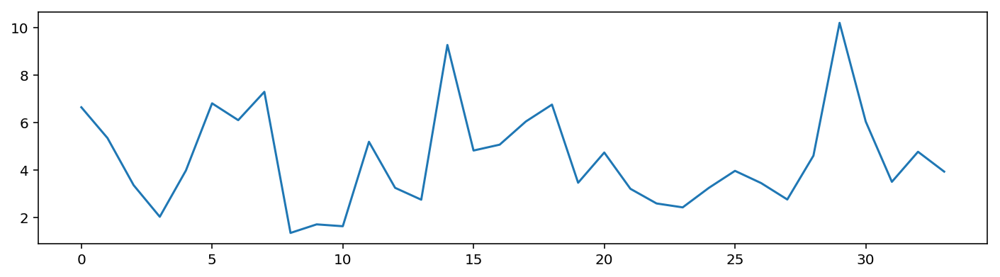

	 	 Test subset results
Test mean absolute percentage error per hour: 2.105027
Test mean absolute percentage error per day: 4.953561 
	 	 Validation Forecasting visualisation


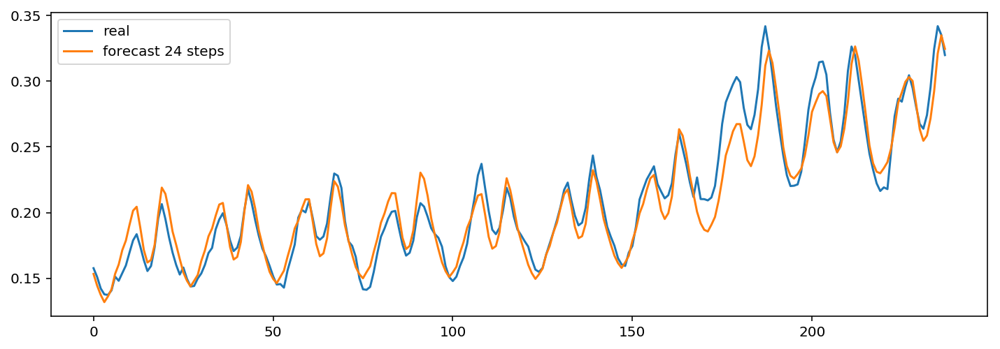

	 	 Forecasting a sample from Learning dataset


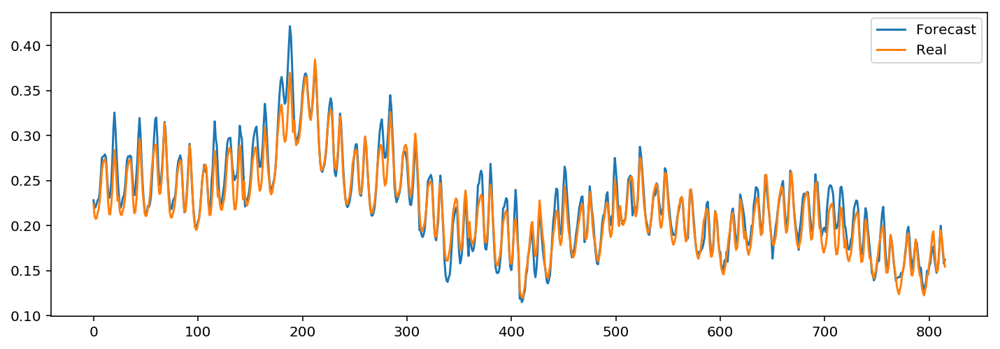

In [221]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model = load_model('temp/lstm_%d_%s'%(tempErrorHistory.argmin(),season))

MLP_Model.save('Models/spring and autumn/lstm_%d_%s'%((Model_ID),today))


clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 83
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.69213109479 
Daily Learning mean absolute percentage error of 34 days : 3.91883659363 
	 	 MAPError plot through Learning DataSet 


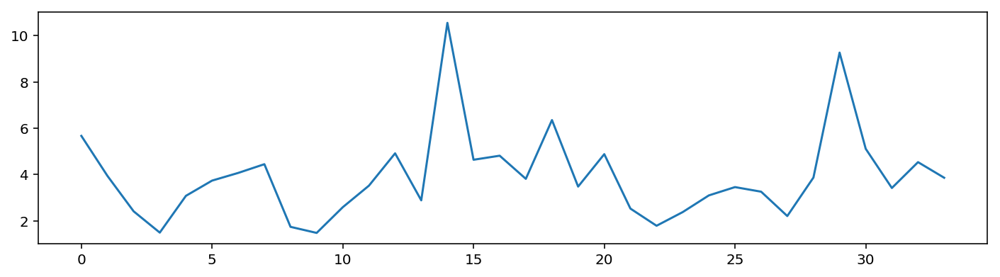

	 	 Test subset results
Test mean absolute percentage error per hour: 1.934010
Test mean absolute percentage error per day: 4.649280 
	 	 Validation Forecasting visualisation


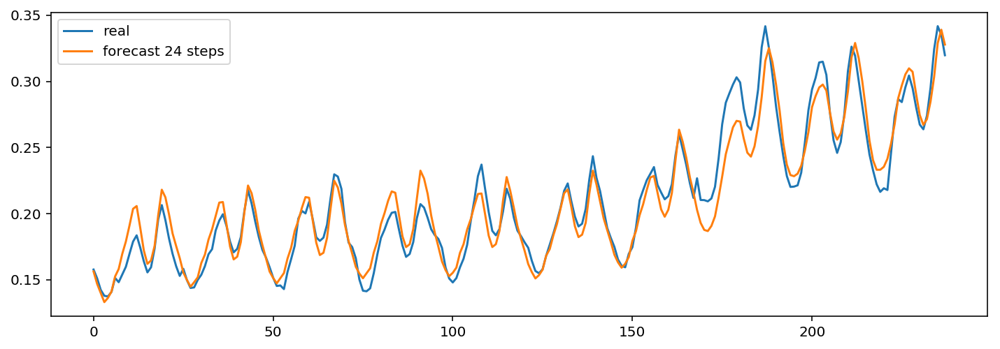

	 	 Forecasting a sample from Learning dataset


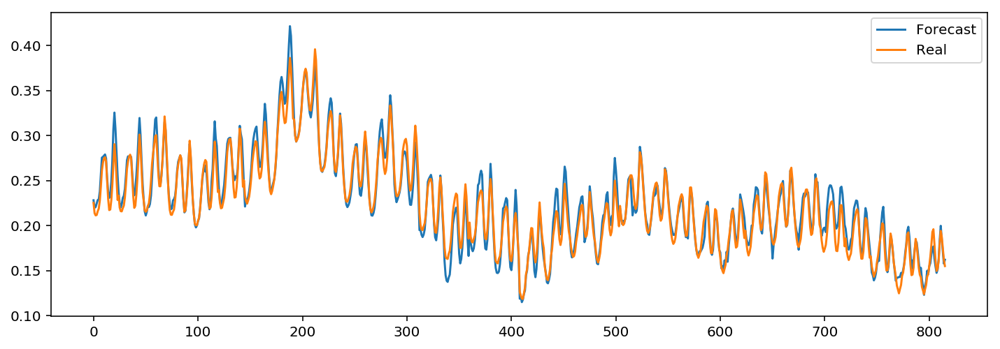

In [222]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model = load_model('temp/lstm_%d_%s'%(tempErrorHistory.argmin(),season))

MLP_Model.save('Models/spring and autumn/lstm_%d_%s'%((Model_ID),today))


clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 84
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.65165670347 
Daily Learning mean absolute percentage error of 34 days : 3.88860099982 
	 	 MAPError plot through Learning DataSet 


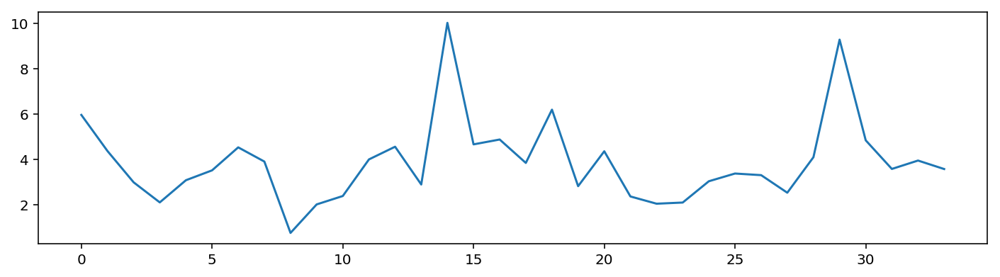

	 	 Test subset results
Test mean absolute percentage error per hour: 1.937390
Test mean absolute percentage error per day: 4.483144 
	 	 Validation Forecasting visualisation


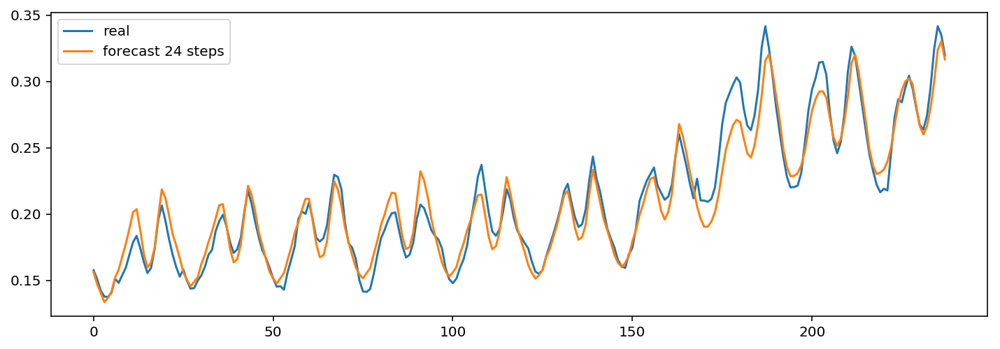

	 	 Forecasting a sample from Learning dataset


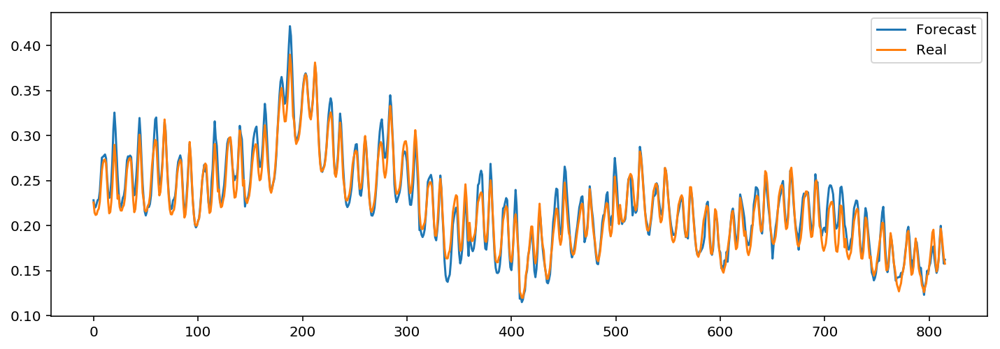

In [223]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model = load_model('temp/lstm_%d_%s'%(tempErrorHistory.argmin(),season))

MLP_Model.save('Models/spring and autumn/lstm_%d_%s'%((Model_ID),today))


clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

	 	 test num : 85
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.77403861418 
Daily Learning mean absolute percentage error of 34 days : 4.21614660235 
	 	 MAPError plot through Learning DataSet 


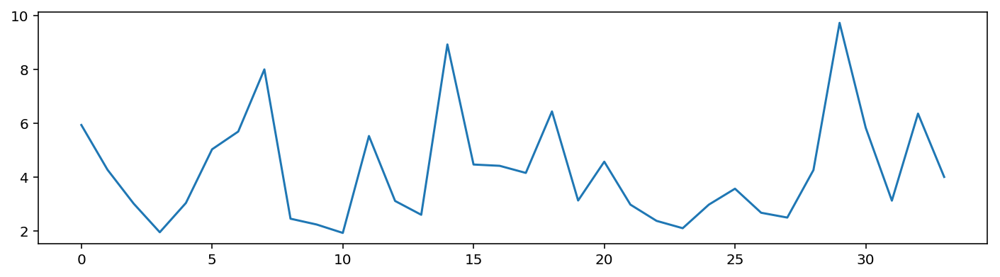

	 	 Test subset results
Test mean absolute percentage error per hour: 2.020738
Test mean absolute percentage error per day: 4.997586 
	 	 Validation Forecasting visualisation


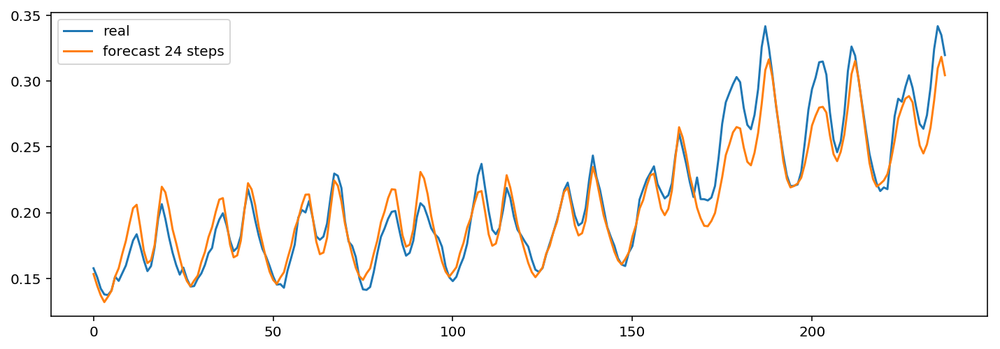

	 	 Forecasting a sample from Learning dataset


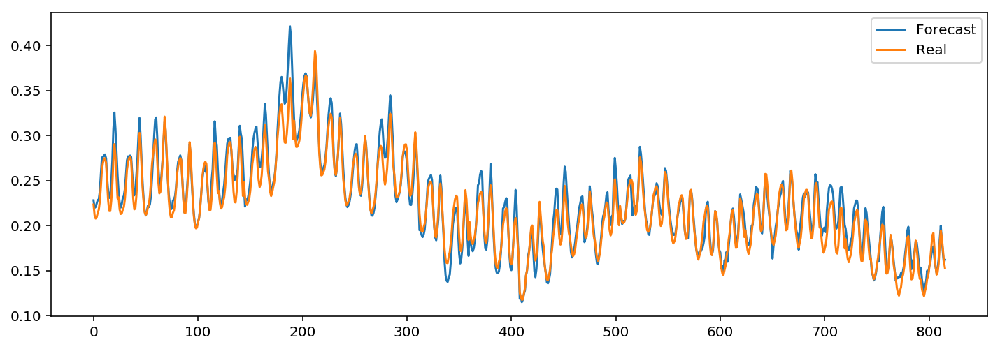

In [224]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])
ID= np.empty([1])
ID[0]=Model_ID


UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False

shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)
#learning vectors
inputx1 = np.array(pd.DataFrame(learninginputs.copy())).reshape(-1,nbrInputs)
outputx1 = np.array(pd.DataFrame(learningoutputs.copy()))

#test vectors
inputx2 = np.array(pd.DataFrame(testinputs.copy())).reshape(-1,nbrInputs)
outputx2 = np.array(pd.DataFrame(testoutputs.copy()))

Parameters[0]= HiddenNeurons1 = 30
Parameters[1]= HiddenNeurons2 = 20
Parameters[2]= LearningRate = 0.02

tempMLPmodels, tempErrorHistory,MLP_Model = create_Train_MLP_NN_Model(inputx1,outputx1,inputx2,outputx2,inputx1.shape[1],HiddenNeurons1=HiddenNeurons1,HiddenNeurons2=HiddenNeurons2
                                      ,Epoch=Epoch,LearningRate = LearningRate,Optimizer='Adam')

Parameters[3]= tempErrorHistory.argmin()

MLP_Model = load_model('temp/lstm_%d_%s'%(tempErrorHistory.argmin(),season))

MLP_Model.save('Models/spring and autumn/lstm_%d_%s'%((Model_ID),today))


clear_output()
print('==================================================================================')
print('\t \t test num : %s' %Model_ID )
print('==================================================================================')


LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,MLP_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

UsedInputList.append(UsedInputsTemp)
MAPErrorList.append(FinalErrorTemp)
ModelsList.append(MLP_Model)
ForecastingList.append(LearningDailyForecast)
Models_IDs.append(ID)
Models_parameters.append(Parameters)

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[Model_ID].index= range(ForecastingList[Model_ID].index.size)
plt.plot(ForecastingList[Model_ID].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[Model_ID].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()

Model_ID = Model_ID + 1

In [15]:
def getForecastingResults2(learninginputs,learningoutputs,testinputs,testoutputs,Model, nbrInputs, IsShift,previoushour,season,timeSteps):
    
    testPeriod= 240
    
    predictionPeriod = learninginputs.index.size-testPeriod
    temp=learninginputs.iloc[:predictionPeriod-24].resample('D').sum()
    temp= temp.dropna()
    temp2=learninginputs.iloc[:predictionPeriod-24]

    
    
    
    dstart= testinputs.index[0]
    dstarti= 0
    dend= testinputs.index[testinputs.index.size-2]
    dendi= testinputs.shape[0]-2
    dend2= testinputs.index[testinputs.index.size-1]
    dend2i= testinputs.shape[0]-1
    
    testPeriod= 240

    forecasting_history=pd.DataFrame(np.random.randn(dendi, 3),columns=['real', 'forecast 24 steps','forecast 1 step'],index=pd.date_range(dstart,freq='H',periods=238))
    Hforecasting_history=pd.DataFrame(np.random.randn(dendi, 2),columns=['real', 'forecast'])


    validationInputs= testinputs.iloc[dstarti:dend2i,:].copy()
    validationOutputs= testoutputs.iloc[dstarti:dendi,:].copy()
    
    HvalidationInputs= testinputs.iloc[dstarti:dend2i,:].copy()

    for x in range(dstarti,dendi):
        if IsShift == True:
            forecast=Model.predict(validationInputs.iloc[x + 1].values.reshape(-1,1,nbrInputs))
            Hforecast=Model.predict(HvalidationInputs.iloc[x + 1].values.reshape(-1,1,nbrInputs))
        else :
            forecast=Model.predict(validationInputs.iloc[x + 0].values.reshape(-1,1,nbrInputs))
            Hforecast=Model.predict(HvalidationInputs.iloc[x + 0].values.reshape(-1,1,nbrInputs))
        
        forecasting_history.iloc[x,0]= testoutputs.iloc[x,0]
        forecasting_history.iloc[x,1]= forecast[0][0]
        forecasting_history.iloc[x,2]= Hforecast[0][0]
        
        
        Hforecasting_history.iloc[x,0]= testoutputs.iloc[x,0]
        Hforecasting_history.iloc[x,1]= Hforecast[0][0]

        if previoushour == True: 
            if IsShift == True:
                if ((x + 2)) + 1 < testPeriod - 1: 
                    validationInputs.iloc[x + 2,0] = forecast[0]
            else :
                for z in range(0,timeSteps):
                    if ((x +1)) + z + 1 < testPeriod - 1: 
                        validationInputs.iloc[x + 1 + z , z] = forecast[0]


    HtestMAPE= mean_absolute_percentage_error(Hforecasting_history.iloc[:,1], Hforecasting_history.iloc[:,0])
    testMAPE= mean_absolute_percentage_error(forecasting_history.iloc[:,1], forecasting_history.iloc[:,0])
    
    print('==================================================================================')
    print('\t \t Test subset results')
    print('==================================================================================')


    print('Test mean absolute percentage error per hour: %f' %HtestMAPE)
    print('Test mean absolute percentage error per day: %f ' %testMAPE)

    
    return forecasting_history

In [16]:
def getForecastingResults4( learninginputs, learningoutputs, testinputs, testoutputs, Model, nbrInputs, IsShift, previoushour, season, timeSteps):
        
    predictionPeriod = learninginputs.index.size
    temp=learninginputs.iloc[:predictionPeriod].resample('D').sum()
    temp= temp.dropna()
    temp2=learninginputs.iloc[:predictionPeriod]

    Model = Model
        
    LearningForecastingError=pd.DataFrame(np.random.randn((predictionPeriod)/24, 1))

    learningInputs= learninginputs.iloc[:learningoutputs.index.size].copy()
    learningOutputs= learningoutputs.iloc[:learningoutputs.index.size].copy()
    HlearningInputs= learninginputs.iloc[:learninginputs.index.size].copy()

    LearningDailyForecast=pd.DataFrame(np.random.randn(predictionPeriod, 3),index=temp2.index)
    LearningHourlyForecast=pd.DataFrame(np.random.randn(predictionPeriod, 2),index=temp2.index)
    

    print('==============================================================================')
    print('\t \t learning subset results')
    print('==============================================================================')

    for y in range(0,predictionPeriod/24):
        dailyError = 0

        for x in range(0,24):

            if IsShift == True:
                Hforecast=Model.predict(HlearningInputs.iloc[x + (y * 24) + 1].values.reshape(-1,1,nbrInputs))
                forecast=Model.predict(learningInputs.iloc[x + (y * 24) + 1].values.reshape(-1,1,nbrInputs))
            else :
                Hforecast=Model.predict(HlearningInputs.iloc[x + (y * 24)].values.reshape(-1,1,nbrInputs))
                forecast=Model.predict(learningInputs.iloc[x + (y * 24)].values.reshape(-1,1,nbrInputs))
                
            dailyError = dailyError + (np.abs(((learningOutputs.iloc[x + (y * 24),0] - forecast[0]) / 
                                              learningOutputs.iloc[x + (y * 24),0]))*100)
            
            LearningDailyForecast.iloc[x + (y * 24),0]= learningOutputs.iloc[x + (y * 24),0]
            LearningDailyForecast.iloc[x + (y * 24),1]= forecast
            LearningDailyForecast.iloc[x + (y * 24),2]= Hforecast
            
            LearningHourlyForecast.iloc[x + (y * 24),0]= learningOutputs.iloc[x + (y * 24),0]
            LearningHourlyForecast.iloc[x + (y * 24),1]= Hforecast

            
            if previoushour == True: 
                if IsShift == True: 
                    if x + 2 < 24: learningInputs.iloc[(x + (y * 24)) + 2,0] = forecast[0]
                else :
                     for z in range(0,timeSteps):
                        if x + z + 1 < 24: learningInputs.iloc[(x + (y * 24)) + 1 + z, z] = forecast[0]
        
        dailyError = (dailyError / 24)

        LearningForecastingError.iloc[y,0] = dailyError

    HlearningMAPE= mean_absolute_percentage_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    LearningMAPE= mean_absolute_percentage_error(LearningDailyForecast.iloc[:,1], LearningDailyForecast.iloc[:,0])
    
    HlearningMAE= mean_absolute_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    LearningMAE= mean_absolute_error(LearningDailyForecast.iloc[:,1], LearningDailyForecast.iloc[:,0])
    
    HlearningRMSE= rmse(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    LearningRMSE= rmse(LearningDailyForecast.iloc[:,1], LearningDailyForecast.iloc[:,0])
    
#     HlearningMAPE= mean_absolute_percentage_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    print('Hourly Learning mean absolute percentage error of %d hours : %s ' %(LearningHourlyForecast.shape[0] , HlearningMAPE))

#     LearningMAPE = LearningForecastingError.mean()
    print('Daily Learning mean absolute percentage error of %d days : %s ' %(LearningHourlyForecast.shape[0]/24 ,LearningMAPE))
    
    
    
#     HlearningMAE= mean_absolute_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    print('Hourly Learning mean absolute error of %d hours : %s ' %(LearningHourlyForecast.shape[0] , HlearningMAE))

#     LearningMAE = LearningForecastingError.mean()
    print('Daily Learning mean absolute error of %d days : %s ' %(LearningHourlyForecast.shape[0]/24 ,LearningMAE))
    
    
    
#     HlearningMAE= mean_absolute_error(LearningHourlyForecast.iloc[:,1], LearningHourlyForecast.iloc[:,0])
    print('Hourly Learning root mean square error of %d hours : %s ' %(LearningHourlyForecast.shape[0] , HlearningRMSE))

#     LearningMAE = LearningForecastingError.mean()
    print('Daily Learning root mean square error of %d days : %s ' %(LearningHourlyForecast.shape[0]/24 ,LearningRMSE))
    
    print('==================================================================================')
    print('\t \t MAPError plot through Learning DataSet ')
    print('==================================================================================')
    
    fig = plt.figure(figsize=(12,3))
    plt.plot(LearningForecastingError,label='Error')
    plt.show()
    
    dstart= testinputs.index[0]
    dstarti= 0
    dend= testinputs.index[testinputs.index.size-2]
    dendi= testinputs.shape[0]-2
    dend2= testinputs.index[testinputs.index.size-1]
    dend2i= testinputs.shape[0]-1
    
    
    forecasting_history=pd.DataFrame(np.random.randn(dendi, 2),columns=['real', 'forecast 24 steps'])
    Hforecasting_history=pd.DataFrame(np.random.randn(dendi, 2),columns=['real', 'forecast'])


    validationInputs= testinputs.iloc[dstarti:dend2i,:].copy()
    validationOutputs= testoutputs.iloc[dstarti:dendi,:].copy()
    
    HvalidationInputs= testinputs.iloc[dstarti:dend2i,:].copy()

    for x in range(dstarti,dendi):
        if IsShift == True:
            forecast=Model.predict(validationInputs.iloc[x + 1].values.reshape(-1,1,nbrInputs))
            Hforecast=Model.predict(HvalidationInputs.iloc[x + 1].values.reshape(-1,nbrInputs))
        else :
            forecast=Model.predict(validationInputs.iloc[x + 0].values.reshape(-1,1,nbrInputs))
            Hforecast=Model.predict(HvalidationInputs.iloc[x + 0].values.reshape(-1,1,nbrInputs))
        
        forecasting_history.iloc[x,0]= testoutputs.iloc[x,0]
        forecasting_history.iloc[x,1]= forecast[0][0]
#         forecasting_history.iloc[x,2]= Hforecast[0][0]
        
        
        Hforecasting_history.iloc[x,0]= testoutputs.iloc[x,0]
        Hforecasting_history.iloc[x,1]= Hforecast[0][0]

        if previoushour == True: 
            if IsShift == True:
                if ((x + 2)) + 1 < testPeriod - 1: 
                    validationInputs.iloc[x + 2,0] = forecast[0]
            else :
                for z in range(0,timeSteps):
                    if ((x +1)) + z + 1 < testPeriod - 1: 
                        validationInputs.iloc[x + 1 + z , z] = forecast[0]

    
    HtestMAPE= mean_absolute_percentage_error(Hforecasting_history.iloc[:,1], Hforecasting_history.iloc[:,0])
    testMAPE= mean_absolute_percentage_error(forecasting_history.iloc[:,1], forecasting_history.iloc[:,0])
    
    HtestMAE= mean_absolute_error(Hforecasting_history.iloc[:,1], Hforecasting_history.iloc[:,0])
    testMAE= mean_absolute_error(forecasting_history.iloc[:,1], forecasting_history.iloc[:,0])
    
    HtestRMSE= rmse(Hforecasting_history.iloc[:,1], Hforecasting_history.iloc[:,0])
    testRMSE= rmse(forecasting_history.iloc[:,1], forecasting_history.iloc[:,0])
    
    print('==================================================================================')
    print('\t \t Test subset results')
    print('==================================================================================')


    print('Test mean absolute percentage error per hour: %f' %HtestMAPE)
    print('Test mean absolute percentage error per day: %f ' %testMAPE)
    
    print('Test mean absolute error per hour: %f' %HtestMAE)
    print('Test mean absolute error per day: %f ' %testMAE)
    
    print('Test mean absolute error per hour: %f' %HtestRMSE)
    print('Test mean absolute error per day: %f ' %testRMSE)


    print('==================================================================================')
    print('\t \t Validation Forecasting visualisation')
    print('==================================================================================')
    fig = plt.figure(figsize=(12,4))
    plt.plot(forecasting_history[:dendi], label=['real','forecast 24 steps'])
    plt.legend(labels=['real','forecast 24 steps'],loc= 'best')
    plt.show()
    
    return LearningMAPE, testMAPE, HlearningMAPE, LearningDailyForecast, LearningHourlyForecast

-------Input preparation process complet-------
	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.65165695288 
Daily Learning mean absolute percentage error of 34 days : 3.97324251088 
Hourly Learning mean absolute error of 816 hours : 0.00346375872804 
Daily Learning mean absolute error of 34 days : 0.00867844251596 
Hourly Learning root mean square error of 816 hours : 0.004817769267681187 
Daily Learning root mean square error of 34 days : 0.01134852342084435 
	 	 MAPError plot through Learning DataSet 


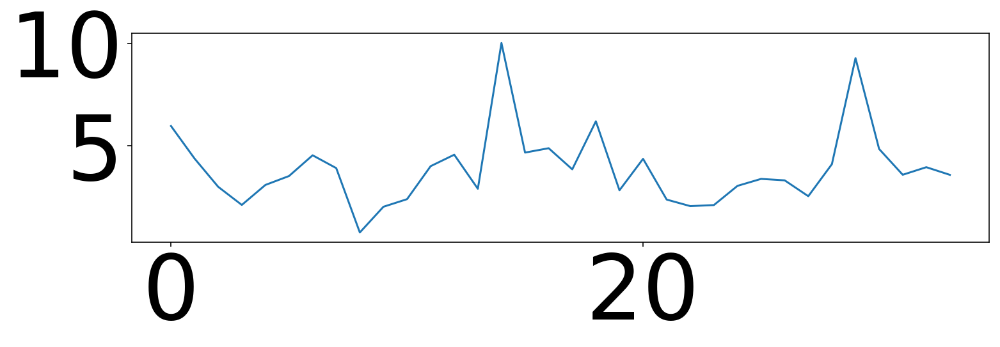

	 	 Test subset results
Test mean absolute percentage error per hour: 1.937389
Test mean absolute percentage error per day: 4.483139 
Test mean absolute error per hour: 0.004091
Test mean absolute error per day: 0.009486 
Test mean absolute error per hour: 0.005461
Test mean absolute error per day: 0.012088 
	 	 Validation Forecasting visualisation


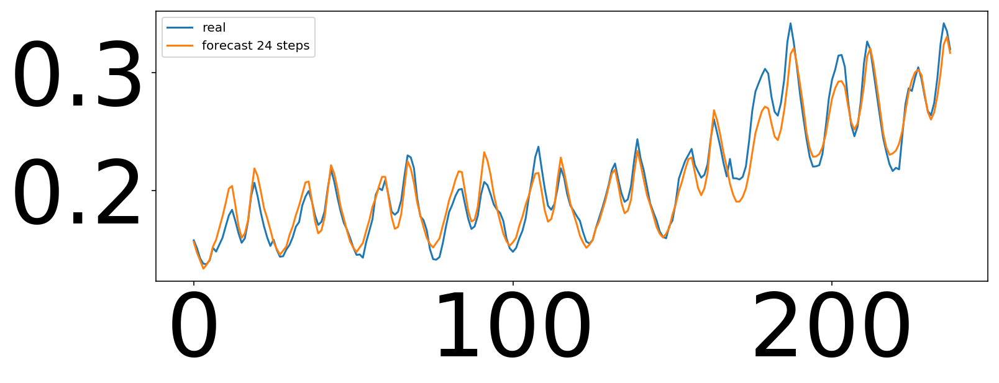

	 	 Test subset results
Test mean absolute percentage error per hour: 1.937389
Test mean absolute percentage error per day: 4.483139 


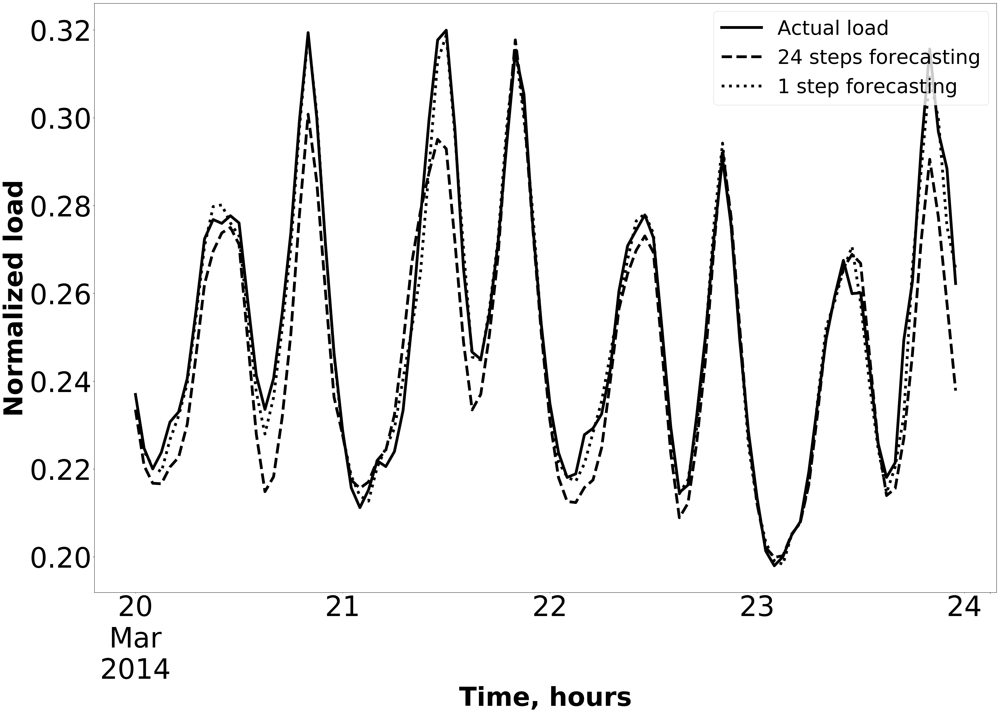

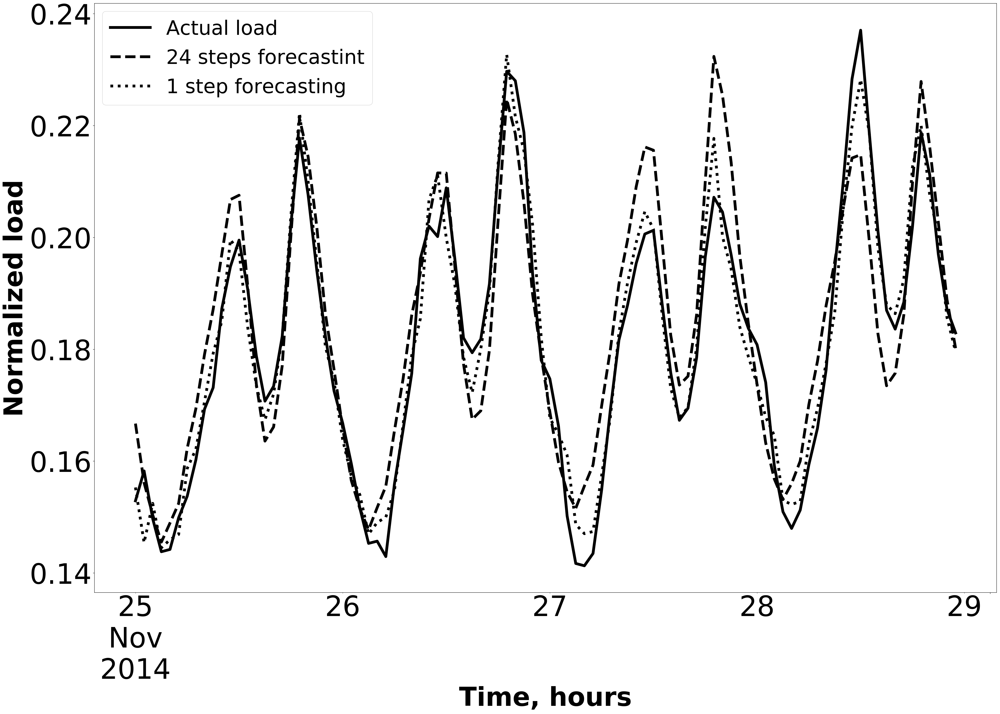

In [19]:
UsedInputsTemp= np.empty([10])
FinalErrorTemp= np.empty([2])
Parameters = np.empty([4])

UsedInputsTemp[0] = previoushour = True
UsedInputsTemp[1] = timeSteps = 6
UsedInputsTemp[2] = previousDay = True
UsedInputsTemp[3] = previousWeek = True
UsedInputsTemp[4] = Temp = True
UsedInputsTemp[5] = TempMax = True
UsedInputsTemp[6] = TempMin = True
UsedInputsTemp[7] = dayIndicator = False
UsedInputsTemp[8] = HourIndicator = True
UsedInputsTemp[9] = MonthIndicator = False


shift = False

learninginputs, learningoutputs, testinputs, testoutputs, nbrInputs = prepareInputs(daydata,season,UsedInputsTemp,testPeriod)


LSTM_Model = load_model('Models/spring and autumn/lstm_84_2018-07-22')
# LSTM_Model= ModelsList[84]
LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults4(
    learninginputs,learningoutputs,testinputs,testoutputs,LSTM_Model,nbrInputs,shift,previoushour,season,timeSteps)



TestHourlyForecast = getForecastingResults2(
    learninginputs,learningoutputs,testinputs,testoutputs,LSTM_Model,nbrInputs,shift,previoushour,season,timeSteps)

plt.rc('xtick', labelsize=70)    # fontsize of the tick labels
plt.rc('ytick', labelsize=70)

a1=1
b1=5

a2=1
b2=5

LearningDailyForecast.iloc[a1*24:b1*24,0].plot(label='Actual load',c='black',marker='.',linewidth=7,linestyle='-',figsize=(35,25))
LearningDailyForecast.iloc[a1*24:b1*24,1].plot(label='24 steps forecasting',c='black',linewidth=7,linestyle='--')
LearningDailyForecast.iloc[a1*24:b1*24,2].plot(label='1 step forecasting',c='black',linewidth=7,linestyle=':')
plt.ylabel('Normalized load',fontsize=65,weight='bold')
plt.xlabel('Time, hours',fontsize=65,weight='bold')
plt.legend(fontsize=50, loc='best', borderaxespad=0.4)

plt.tight_layout()
plt.savefig('SpringAndAutumnLearning.pdf')

plt.show()


TestHourlyForecast.iloc[a2*24:b2*24,0].plot(label='Actual load',c='black',marker='.',linestyle='-',linewidth=7,figsize=(35,25))
TestHourlyForecast.iloc[a2*24:b2*24,1].plot(label='24 steps forecastint',c='black',linewidth=7,linestyle='--')
TestHourlyForecast.iloc[a2*24:b2*24,2].plot(label='1 step forecasting',c='black',linewidth=7,linestyle=':')
plt.legend( fontsize= 50,loc='best', borderaxespad=0.4)
plt.ylabel('Normalized load',fontsize=65,weight='bold')
plt.xlabel('Time, hours',fontsize=65,weight='bold')

plt.tight_layout()
plt.savefig('SpringAndAutumnTest.pdf')

plt.show()


	 	 learning subset results
Hourly Learning mean absolute percentage error of 816 hours : 1.65165691748 
Daily Learning mean absolute percentage error of 34 days : 3.97324388544 
Hourly Learning mean absolute error of 816 hours : 0.00346375867326 
Daily Learning mean absolute error of 34 days : 0.00867844611342 
	 	 MAPError plot through Learning DataSet 


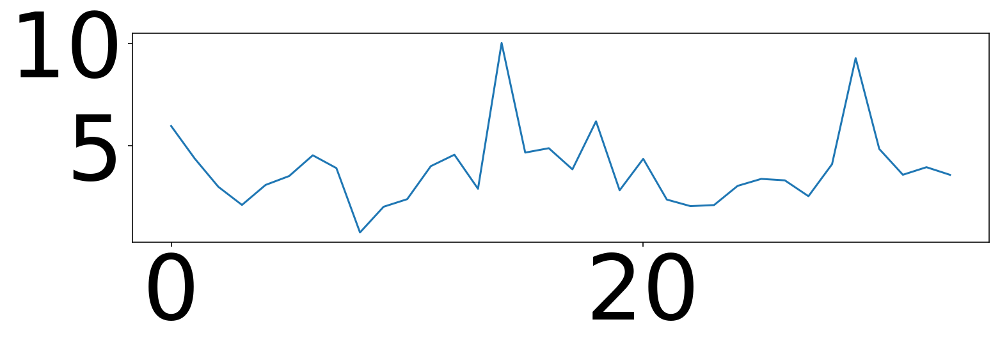

	 	 Test subset results
Test mean absolute percentage error per hour: 1.937389
Test mean absolute percentage error per day: 4.483137 
Test mean absolute error per hour: 0.004091
Test mean absolute error per day: 0.009486 
	 	 Validation Forecasting visualisation


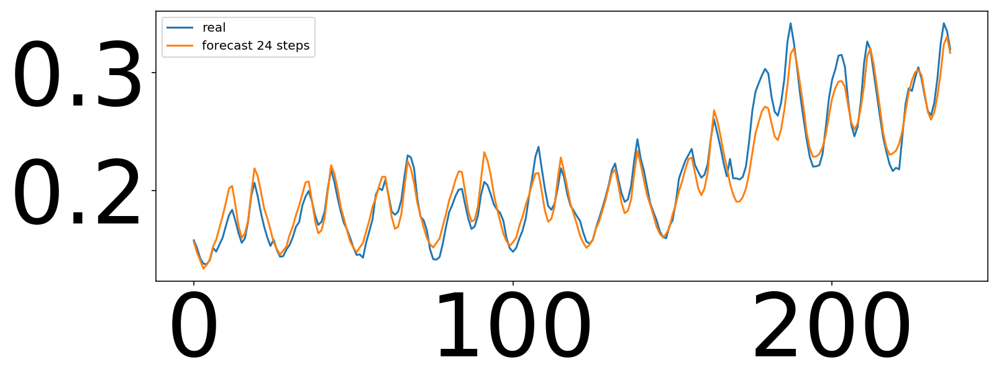

	 	 Forecasting a sample from Learning dataset


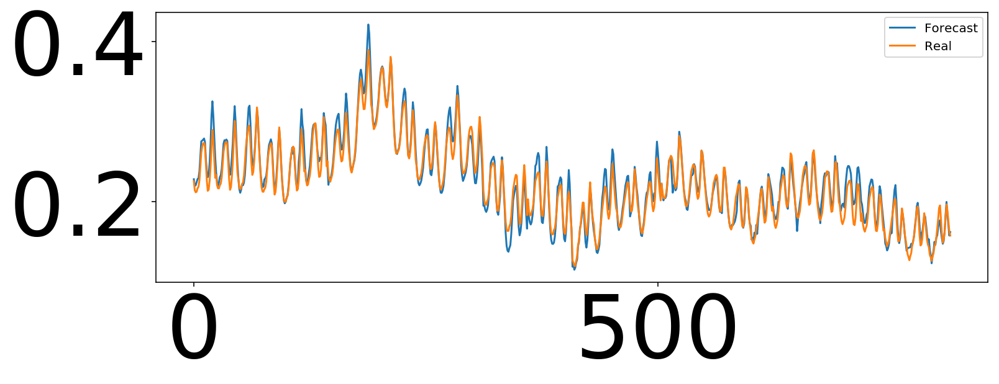

In [251]:
LearningMAPE, testMAPE , LearningHourlyMAPE, LearningDailyForecast, LearningHourlyForecast  = getForecastingResults(
    tempMLPmodels, tempErrorHistory,learninginputs,learningoutputs,testinputs,testoutputs,LSTM_Model,nbrInputs,shift,previoushour,season,timeSteps)
FinalErrorTemp[0] = LearningMAPE
FinalErrorTemp[1] = testMAPE

print('==================================================================================')
print('\t \t Forecasting a sample from Learning dataset')
print('==================================================================================')
plt.figure(figsize=(12,4))
ForecastingList[84].index= range(ForecastingList[84].index.size)
plt.plot(ForecastingList[84].iloc[:,0],label='Forecast')
plt.plot(ForecastingList[84].iloc[:,1],label='Real')
plt.legend( loc=1, borderaxespad=0.4)
plt.show()